In [1]:
import os
import re
import glob
import numpy as np
from PIL import Image, ImageFilter
import tensorflow as tf
from tensorflow.keras import layers, models, mixed_precision
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau
from sklearn.model_selection import train_test_split
from skimage.morphology import remove_small_objects, remove_small_holes

# === Custom Metrics (DEFINED FIRST!) ===
def dice_coefficient(y_true, y_pred, smooth=1e-6):
    y_true_f = tf.reshape(y_true, [-1])
    y_pred_f = tf.reshape(tf.sigmoid(y_pred), [-1])
    intersection = tf.reduce_sum(y_true_f * y_pred_f)
    return (2. * intersection + smooth) / (tf.reduce_sum(y_true_f) + tf.reduce_sum(y_pred_f) + smooth)

def iou_metric(y_true, y_pred, smooth=1e-6):
    y_true_f = tf.reshape(y_true, [-1])
    y_pred_f = tf.reshape(tf.sigmoid(y_pred), [-1])
    intersection = tf.reduce_sum(y_true_f * y_pred_f)
    union = tf.reduce_sum(y_true_f) + tf.reduce_sum(y_pred_f) - intersection
    return (intersection + smooth) / (union + smooth)

# === Mixed Precision ===
policy = mixed_precision.Policy('mixed_float16')
mixed_precision.set_global_policy(policy)

# === Dataset Paths ===
base_dir = '/kaggle/input/compvis-data/Data'
before_folder = os.path.join(base_dir, 'before')
after_folder = os.path.join(base_dir, 'after')
mask_folder = os.path.join(base_dir, 'masked')

# === Key Extraction ===
def extract_key(filename):
    name = os.path.basename(filename).lower()
    if any(city in name for city in ['gorakhpur', 'chennai', 'brahmaputra']):
        if 'mask' in name:
            match = re.search(r'sen_\w+_mask_(\d+)', name)
            return f'divit_{match.group(1)}' if match else None
        else:
            match = re.search(r'sen_\w+_(\d{8})_(\d+)', name)
            return f'divit_{match.group(2)}' if match else None
    if re.match(r'sen_gj_\d{4}_', name):
        match = re.search(r'sen_(\w{2})_(\d{4})', name)
        if match:
            state, tile = match.groups()
            return f"{state}_{tile}"
    match_vijay2 = re.search(r'sen_(\w{2})_(\d{6})_(\d{4})', name)
    if match_vijay2:
        state, _, tile = match_vijay2.groups()
        return f"{state}_{tile}"
    match_vijay = re.search(r'sen_(\w{2})_(\d{4})_\d{4}', name)
    if match_vijay:
        state, tile = match_vijay.groups()
        return f"{state}_{tile}"
    match_general = re.search(r'sen_(\w{2})_\d{8}_(\d{4})', name)
    if match_general:
        state, tile = match_general.groups()
        return f"{state}_{tile}"
    return None

# === Data Loading ===
def load_dataset():
    before_images = sorted(glob.glob(os.path.join(before_folder, '*.png')))
    after_images = sorted(glob.glob(os.path.join(after_folder, '*.png')))
    mask_images = sorted(glob.glob(os.path.join(mask_folder, '*.png')))

    before_dict = {extract_key(f): f for f in before_images if extract_key(f)}
    after_dict = {extract_key(f): f for f in after_images if extract_key(f)}
    mask_dict = {extract_key(f): f for f in mask_images if extract_key(f)}

    paired_data = []
    for key in before_dict:
        if key in after_dict and key in mask_dict:
            paired_data.append((before_dict[key], after_dict[key], mask_dict[key]))
    print(f"✅ Total Paired Samples: {len(paired_data)}")
    return paired_data

# === Preprocessing ===
def median_filter(image, size=3):
    pil_img = Image.fromarray((image * 255).astype(np.uint8))
    filtered = pil_img.filter(ImageFilter.MedianFilter(size=size))
    return np.array(filtered) / 255.0

def preprocess_image(path, target_size=(256, 256), mode='gray', denoise=True):
    img = Image.open(path).convert('L').resize(target_size)
    arr = np.array(img) / 255.0
    return median_filter(arr) if denoise else arr

def create_datasets(paired_data):
    X, Y = [], []
    for before_path, after_path, mask_path in paired_data:
        before_img = preprocess_image(before_path)
        after_img = preprocess_image(after_path)
        mask_img = preprocess_image(mask_path, denoise=False)
        mask_bin = (mask_img > 0.5).astype(np.float32)
        combined = np.stack([before_img, after_img], axis=-1)
        X.append(combined)
        Y.append(np.expand_dims(mask_bin, -1))
    return np.array(X, dtype=np.float32), np.array(Y, dtype=np.float32)

# === Augmentation ===
def get_augmentation_layer():
    return tf.keras.Sequential([
        layers.RandomFlip("horizontal_and_vertical"),
        layers.RandomRotation(0.15),
        layers.RandomZoom(0.1),
        layers.GaussianNoise(0.01),
    ], name="data_augmentation")

# === Advanced Loss ===
def focal_tversky_loss(alpha=0.7, beta=0.3, gamma=0.75, smooth=1e-6):
    def loss(y_true, y_pred):
        y_true_f = tf.reshape(y_true, [-1])
        y_pred_f = tf.reshape(tf.sigmoid(y_pred), [-1])
        tp = tf.reduce_sum(y_true_f * y_pred_f)
        fn = tf.reduce_sum(y_true_f * (1 - y_pred_f))
        fp = tf.reduce_sum((1 - y_true_f) * y_pred_f)
        tversky = (tp + smooth) / (tp + alpha*fn + beta*fp + smooth)
        return tf.pow(1 - tversky, gamma)
    return loss

# === Model Architecture ===
def attention_block(x, g, inter_channels):
    theta_x = layers.Conv2D(inter_channels, 1)(x)
    phi_g = layers.Conv2D(inter_channels, 1)(g)
    add = layers.Add()([theta_x, phi_g])
    act = layers.Activation('relu')(add)
    psi = layers.Conv2D(1, 1, activation='sigmoid')(act)
    return layers.Multiply()([x, psi])

def conv_block(x, filters, use_bn=True):
    x = layers.Conv2D(filters, 3, padding='same')(x)
    if use_bn: x = layers.BatchNormalization()(x)
    return layers.ReLU()(x)

def build_unet_plus_plus(input_shape=(256, 256, 2)):
    inputs = layers.Input(shape=input_shape)
    x = get_augmentation_layer()(inputs)
    # Encoder
    c1 = conv_block(x, 32)
    c1 = conv_block(c1, 32)
    p1 = layers.MaxPooling2D(2)(c1)
    c2 = conv_block(p1, 64)
    c2 = conv_block(c2, 64)
    p2 = layers.MaxPooling2D(2)(c2)
    c3 = conv_block(p2, 128)
    c3 = conv_block(c3, 128)
    p3 = layers.MaxPooling2D(2)(c3)
    c4 = conv_block(p3, 256)
    c4 = conv_block(c4, 256)
    p4 = layers.MaxPooling2D(2)(c4)
    # Bridge
    b = conv_block(p4, 512)
    b = conv_block(b, 512)
    # Decoder + Attention
    u4 = layers.Conv2DTranspose(256, 3, strides=2, padding='same')(b)
    u4 = layers.concatenate([u4, attention_block(c4, u4, 256)])
    u4 = conv_block(u4, 256)
    u3 = layers.Conv2DTranspose(128, 3, strides=2, padding='same')(u4)
    u3 = layers.concatenate([u3, attention_block(c3, u3, 128)])
    u3 = conv_block(u3, 128)
    u2 = layers.Conv2DTranspose(64, 3, strides=2, padding='same')(u3)
    u2 = layers.concatenate([u2, attention_block(c2, u2, 64)])
    u2 = conv_block(u2, 64)
    u1 = layers.Conv2DTranspose(32, 3, strides=2, padding='same')(u2)
    u1 = layers.concatenate([u1, attention_block(c1, u1, 32)])
    u1 = conv_block(u1, 32)
    outputs = layers.Conv2D(1, 1, activation=None, dtype='float32')(u1)
    return models.Model(inputs=[inputs], outputs=[outputs])

# === Training ===
def main():
    paired_data = load_dataset()
    train_set, temp_set = train_test_split(paired_data, test_size=0.3, random_state=42)
    val_set, test_set = train_test_split(temp_set, test_size=0.5, random_state=42)
    X_train, Y_train = create_datasets(train_set)
    X_val, Y_val = create_datasets(val_set)
    X_test, Y_test = create_datasets(test_set)

    model = build_unet_plus_plus()
    optimizer = tf.keras.optimizers.AdamW(learning_rate=1e-4, weight_decay=1e-5)
    optimizer = mixed_precision.LossScaleOptimizer(optimizer)

    model.compile(
        optimizer=optimizer,
        loss=focal_tversky_loss(),
        metrics=['accuracy', dice_coefficient, iou_metric]
    )

    checkpoint = ModelCheckpoint(
        "/kaggle/working/best_model.keras",
        monitor='val_loss',
        save_best_only=True
    )
    early_stop = EarlyStopping(monitor='val_loss', patience=15, restore_best_weights=True)
    lr_scheduler = ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=5, min_lr=1e-6)

    history = model.fit(
        X_train, Y_train,
        validation_data=(X_val, Y_val),
        batch_size=8,
        epochs=100,
        callbacks=[checkpoint, early_stop, lr_scheduler]
    )

    model = tf.keras.models.load_model(
        "/kaggle/working/best_model.keras",
        custom_objects={
            'dice_coefficient': dice_coefficient,
            'iou_metric': iou_metric,
            'focal_tversky_loss': focal_tversky_loss()
        }
    )

    print("\n=== Final Evaluation ===")
    results = model.evaluate(X_test, Y_test)
    print(f"Test Loss: {results[0]:.4f}")
    print(f"Test Accuracy: {results[1]:.4f}")
    print(f"Dice Coefficient: {results[2]:.4f}")
    print(f"IoU Score: {results[3]:.4f}")

if __name__ == "__main__":
    main()


2025-05-13 07:33:20.855959: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1747121601.062014      31 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1747121601.124524      31 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


✅ Total Paired Samples: 2754


I0000 00:00:1747121716.077179      31 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 15513 MB memory:  -> device: 0, name: Tesla P100-PCIE-16GB, pci bus id: 0000:00:04.0, compute capability: 6.0


Epoch 1/100


I0000 00:00:1747121746.912876      73 cuda_dnn.cc:529] Loaded cuDNN version 90300


241/241 ━━━━━━━━━━━━━━━━━━━━ 85s 215ms/step - accuracy: 0.4006 - dice_coefficient: 0.2814 - iou_metric: 0.1643 - loss: 0.7069 - val_accuracy: 0.6328 - val_dice_coefficient: 0.2407 - val_iou_metric: 0.1375 - val_loss: 0.7873 - learning_rate: 1.0000e-04
Epoch 2/100
241/241 ━━━━━━━━━━━━━━━━━━━━ 44s 184ms/step - accuracy: 0.2668 - dice_coefficient: 0.2942 - iou_metric: 0.1730 - loss: 0.6826 - val_accuracy: 0.3656 - val_dice_coefficient: 0.3036 - val_iou_metric: 0.1796 - val_loss: 0.6782 - learning_rate: 1.0000e-04
Epoch 3/100
241/241 ━━━━━━━━━━━━━━━━━━━━ 44s 183ms/step - accuracy: 0.2636 - dice_coefficient: 0.2964 - iou_metric: 0.1746 - loss: 0.6799 - val_accuracy: 0.3373 - val_dice_coefficient: 0.3038 - val_iou_metric: 0.1797 - val_loss: 0.6743 - learning_rate: 1.0000e-04
Epoch 4/100
241/241 ━━━━━━━━━━━━━━━━━━━━ 43s 179ms/step - accuracy: 0.2593 - dice_coefficient: 0.2979 - iou_metric: 0.1756 - loss: 0.6772 - val_accuracy: 0.1698 - val_dice_coefficient: 0.2860 - val_iou_metric: 0.1674 - v

In [ ]:
import os
import re
import glob
import numpy as np
from PIL import Image, ImageFilter
from sklearn.model_selection import train_test_split
import torch
from torch.utils.data import Dataset, DataLoader
import torch.nn as nn
import torch.nn.functional as F

# === Key Extraction ===
def extract_key(filename):
    name = os.path.basename(filename).lower()
    if any(city in name for city in ['gorakhpur', 'chennai', 'brahmaputra']):
        if 'mask' in name:
            match = re.search(r'sen_\w+_mask_(\d+)', name)
            return f'divit_{match.group(1)}' if match else None
        else:
            match = re.search(r'sen_\w+_(\d{8})_(\d+)', name)
            return f'divit_{match.group(2)}' if match else None
    if re.match(r'sen_gj_\d{4}_', name):
        match = re.search(r'sen_(\w{2})_(\d{4})', name)
        if match:
            state, tile = match.groups()
            return f"{state}_{tile}"
    match_vijay2 = re.search(r'sen_(\w{2})_(\d{6})_(\d{4})', name)
    if match_vijay2:
        state, _, tile = match_vijay2.groups()
        return f"{state}_{tile}"
    match_vijay = re.search(r'sen_(\w{2})_(\d{4})_\d{4}', name)
    if match_vijay:
        state, tile = match_vijay.groups()
        return f"{state}_{tile}"
    match_general = re.search(r'sen_(\w{2})_\d{8}_(\d{4})', name)
    if match_general:
        state, tile = match_general.groups()
        return f"{state}_{tile}"
    return None

# === Data Loading ===
def median_filter(image, size=3):
    pil_img = Image.fromarray((image * 255).astype(np.uint8))
    filtered = pil_img.filter(ImageFilter.MedianFilter(size=size))
    return np.array(filtered) / 255.0

def preprocess_image(path, target_size=(256, 256)):
    img = Image.open(path).convert('RGB').resize(target_size)
    arr = np.array(img) / 255.0
    for c in range(3):
        arr[..., c] = median_filter(arr[..., c])
    return arr

def preprocess_mask(path, target_size=(256, 256)):
    img = Image.open(path).convert('L').resize(target_size)
    arr = np.array(img) / 255.0
    return (arr > 0.5).astype(np.float32)

def load_dataset(base_dir):
    before_folder = os.path.join(base_dir, 'before')
    after_folder = os.path.join(base_dir, 'after')
    mask_folder = os.path.join(base_dir, 'masked')
    before_images = sorted(glob.glob(os.path.join(before_folder, '*.png')))
    after_images = sorted(glob.glob(os.path.join(after_folder, '*.png')))
    mask_images = sorted(glob.glob(os.path.join(mask_folder, '*.png')))
    before_dict = {extract_key(f): f for f in before_images if extract_key(f)}
    after_dict = {extract_key(f): f for f in after_images if extract_key(f)}
    mask_dict = {extract_key(f): f for f in mask_images if extract_key(f)}
    paired_data = []
    for key in before_dict:
        if key in after_dict and key in mask_dict:
            paired_data.append((before_dict[key], after_dict[key], mask_dict[key]))
    print(f"✅ Total Paired Samples: {len(paired_data)}")
    return paired_data

def make_numpy_data(paired_data):
    X = []
    Y = []
    for before_path, after_path, mask_path in paired_data:
        before_img = preprocess_image(before_path)
        after_img = preprocess_image(after_path)
        mask_img = preprocess_mask(mask_path)
        combined = np.concatenate([before_img, after_img], axis=-1)
        X.append(combined)
        Y.append(np.expand_dims(mask_img, -1))
    X = np.array(X, dtype=np.float32)
    Y = np.array(Y, dtype=np.float32)
    return X, Y

# === PyTorch Dataset ===
class FloodSegmentationDataset(Dataset):
    def __init__(self, X, Y):
        self.X = X
        self.Y = Y
    def __len__(self):
        return len(self.X)
    def __getitem__(self, idx):
        x = np.transpose(self.X[idx], (2, 0, 1)).astype(np.float32)  # (6, 256, 256)
        y = self.Y[idx].astype(np.float32)  # (256, 256, 1)
        y = np.transpose(y, (2, 0, 1))     # (1, 256, 256)
        return torch.tensor(x), torch.tensor(y)

# === Deep Supervision UNet++ ===
class ConvBlock(nn.Module):
    def __init__(self, in_ch, out_ch):
        super().__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True)
        )
    def forward(self, x):
        return self.conv(x)

class UNetPP(nn.Module):
    def __init__(self, in_ch=6, out_ch=1, deep_supervision=False):
        super().__init__()
        self.deep_supervision = deep_supervision
        n1, n2, n3, n4, n5 = 32, 64, 128, 256, 512
        self.conv0_0 = ConvBlock(in_ch, n1)
        self.conv1_0 = ConvBlock(n1, n2)
        self.conv2_0 = ConvBlock(n2, n3)
        self.conv3_0 = ConvBlock(n3, n4)
        self.conv4_0 = ConvBlock(n4, n5)
        self.maxpool = nn.MaxPool2d(2)
        self.conv0_1 = ConvBlock(n1+n2, n1)
        self.conv1_1 = ConvBlock(n2+n3, n2)
        self.conv2_1 = ConvBlock(n3+n4, n3)
        self.conv3_1 = ConvBlock(n4+n5, n4)
        self.conv0_2 = ConvBlock(n1*2+n2, n1)
        self.conv1_2 = ConvBlock(n2*2+n3, n2)
        self.conv2_2 = ConvBlock(n3*2+n4, n3)
        self.conv0_3 = ConvBlock(n1*3+n2, n1)
        self.conv1_3 = ConvBlock(n2*3+n3, n2)
        self.conv0_4 = ConvBlock(n1*4+n2, n1)
        self.final1 = nn.Conv2d(n1, out_ch, 1)
        self.final2 = nn.Conv2d(n1, out_ch, 1)
        self.final3 = nn.Conv2d(n1, out_ch, 1)
        self.final4 = nn.Conv2d(n1, out_ch, 1)
    def forward(self, x):
        x0_0 = self.conv0_0(x)
        x1_0 = self.conv1_0(self.maxpool(x0_0))
        x0_1 = self.conv0_1(torch.cat([x0_0, F.interpolate(x1_0, scale_factor=2, mode='bilinear', align_corners=True)], 1))
        x2_0 = self.conv2_0(self.maxpool(x1_0))
        x1_1 = self.conv1_1(torch.cat([x1_0, F.interpolate(x2_0, scale_factor=2, mode='bilinear', align_corners=True)], 1))
        x0_2 = self.conv0_2(torch.cat([x0_0, x0_1, F.interpolate(x1_1, scale_factor=2, mode='bilinear', align_corners=True)], 1))
        x3_0 = self.conv3_0(self.maxpool(x2_0))
        x2_1 = self.conv2_1(torch.cat([x2_0, F.interpolate(x3_0, scale_factor=2, mode='bilinear', align_corners=True)], 1))
        x1_2 = self.conv1_2(torch.cat([x1_0, x1_1, F.interpolate(x2_1, scale_factor=2, mode='bilinear', align_corners=True)], 1))
        x0_3 = self.conv0_3(torch.cat([x0_0, x0_1, x0_2, F.interpolate(x1_2, scale_factor=2, mode='bilinear', align_corners=True)], 1))
        x4_0 = self.conv4_0(self.maxpool(x3_0))
        x3_1 = self.conv3_1(torch.cat([x3_0, F.interpolate(x4_0, scale_factor=2, mode='bilinear', align_corners=True)], 1))
        x2_2 = self.conv2_2(torch.cat([x2_0, x2_1, F.interpolate(x3_1, scale_factor=2, mode='bilinear', align_corners=True)], 1))
        x1_3 = self.conv1_3(torch.cat([x1_0, x1_1, x1_2, F.interpolate(x2_2, scale_factor=2, mode='bilinear', align_corners=True)], 1))
        x0_4 = self.conv0_4(torch.cat([x0_0, x0_1, x0_2, x0_3, F.interpolate(x1_3, scale_factor=2, mode='bilinear', align_corners=True)], 1))
        if self.deep_supervision:
            out1 = self.final1(x0_1)
            out2 = self.final2(x0_2)
            out3 = self.final3(x0_3)
            out4 = self.final4(x0_4)
            return [out1, out2, out3, out4]
        else:
            out = self.final4(x0_4)
            return out

# === Loss Functions ===
def dice_loss(pred, target, smooth=1e-6):
    pred = torch.sigmoid(pred)
    intersection = (pred * target).sum()
    return 1 - ((2. * intersection + smooth) / (pred.sum() + target.sum() + smooth))

def bce_dice_loss(pred, target):
    bce = F.binary_cross_entropy_with_logits(pred, target)
    dsc = dice_loss(pred, target)
    return bce + dsc

def deep_supervision_loss(preds, target):
    return sum(bce_dice_loss(p, target) for p in preds) / len(preds)

# === Training Loop with AMP and Memory Optimization ===
def train_model(model, train_loader, val_loader, device, epochs=50, deep_supervision=False):
    optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)
    best_dice = 0
    scaler = torch.cuda.amp.GradScaler()
    for epoch in range(epochs):
        model.train()
        train_loss = 0
        for x, y in train_loader:
            x, y = x.to(device), y.to(device)
            optimizer.zero_grad()
            with torch.cuda.amp.autocast():
                if deep_supervision:
                    outs = model(x)
                    loss = deep_supervision_loss(outs, y)
                    pred = outs[-1]
                else:
                    pred = model(x)
                    loss = bce_dice_loss(pred, y)
            scaler.scale(loss).backward()
            scaler.step(optimizer)
            scaler.update()
            train_loss += loss.item()
            del x, y, loss, pred
            torch.cuda.empty_cache()
        train_loss /= len(train_loader)
        # Validation
        model.eval()
        val_dice = 0
        with torch.no_grad():
            for x, y in val_loader:
                x, y = x.to(device), y.to(device)
                with torch.cuda.amp.autocast():
                    if deep_supervision:
                        outs = model(x)
                        pred = outs[-1]
                    else:
                        pred = model(x)
                    pred_bin = (torch.sigmoid(pred) > 0.5).float()
                    intersection = (pred_bin * y).sum()
                    dice = (2. * intersection) / (pred_bin.sum() + y.sum() + 1e-6)
                    val_dice += dice.item()
                del x, y, pred, pred_bin
                torch.cuda.empty_cache()
        val_dice /= len(val_loader)
        print(f"Epoch {epoch+1} | Train Loss: {train_loss:.4f} | Val Dice: {val_dice:.4f}")
        if val_dice > best_dice:
            best_dice = val_dice
            torch.save(model.state_dict(), "best_model.pth")
    print("Best Val Dice:", best_dice)

# === Main ===
def main():
    base_dir = '/kaggle/input/compvis-data/Data'
    paired_data = load_dataset(base_dir)
    train_data, test_data = train_test_split(paired_data, test_size=0.2, random_state=42)
    val_data, test_data = train_test_split(test_data, test_size=0.5, random_state=42)
    X_train, Y_train = make_numpy_data(train_data)
    X_val, Y_val = make_numpy_data(val_data)
    X_test, Y_test = make_numpy_data(test_data)
    train_ds = FloodSegmentationDataset(X_train, Y_train)
    val_ds = FloodSegmentationDataset(X_val, Y_val)
    test_ds = FloodSegmentationDataset(X_test, Y_test)
    batch_size = 2  # Reduce to 1 if you still get OOM
    train_loader = DataLoader(train_ds, batch_size=batch_size, shuffle=True, pin_memory=True)
    val_loader = DataLoader(val_ds, batch_size=batch_size, shuffle=False, pin_memory=True)
    test_loader = DataLoader(test_ds, batch_size=batch_size, shuffle=False, pin_memory=True)
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    model = UNetPP(in_ch=6, out_ch=1, deep_supervision=True).to(device)
    train_model(model, train_loader, val_loader, device, epochs=50, deep_supervision=True)
    # Load best model and evaluate on test set
    model.load_state_dict(torch.load("best_model.pth"))
    model.eval()
    test_dice = 0
    with torch.no_grad():
        for x, y in test_loader:
            x, y = x.to(device), y.to(device)
            outs = model(x)
            pred = outs[-1] if isinstance(outs, list) else outs
            pred_bin = (torch.sigmoid(pred) > 0.5).float()
            intersection = (pred_bin * y).sum()
            dice = (2. * intersection) / (pred_bin.sum() + y.sum() + 1e-6)
            test_dice += dice.item()
            del x, y, outs, pred, pred_bin
            torch.cuda.empty_cache()
    test_dice /= len(test_loader)
    print(f"Test Dice: {test_dice:.4f}")

if __name__ == "__main__":
    main()


✅ Total Paired Samples: 2754


/tmp/ipykernel_31/4128188487.py:187: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = torch.cuda.amp.GradScaler()
/tmp/ipykernel_31/4128188487.py:194: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():
/tmp/ipykernel_31/4128188487.py:215: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Epoch 1 | Train Loss: 1.2555 | Val Dice: 0.2171
Epoch 2 | Train Loss: 1.1945 | Val Dice: 0.0634
Epoch 3 | Train Loss: 1.1843 | Val Dice: 0.2891
Epoch 4 | Train Loss: 1.1787 | Val Dice: 0.2320
Epoch 5 | Train Loss: 1.1715 | Val Dice: 0.1531
Epoch 6 | Train Loss: 1.1704 | Val Dice: 0.1406
Epoch 7 | Train Loss: 1.1653 | Val Dice: 0.2086
Epoch 8 | Train Loss: 1.1625 | Val Dice: 0.1608
Epoch 9 | Train Loss: 1.1610 | Val Dice: 0.2047
Epoch 10 | Train Loss: 1.1598 | Val Dice: 0.1370
Epoch 11 | Train Loss: 1.1549 | Val Dice: 0.1823
Epoch 12 | Train Loss: 1.1518 | Val Dice: 0.1313
Epoch 13 | Train Loss: 1.1533 | Val Dice: 0.2078
Epoch 14 | Train Loss: 1.1560 | Val Dice: 0.1464
Epoch 15 | Train Loss: 1.1530 | Val Dice: 0.1727
Epoch 16 | Train Loss: 1.1520 | Val Dice: 0.1898
Epoch 17 | Train Loss: 1.1508 | Val Dice: 0.1109
Epoch 18 | Train Loss: 1.1483 | Val Dice: 0.1602
Epoch 19 | Train Loss: 1.1468 | Val Dice: 0.1633
Epoch 20 | Train Loss: 1.1458 | Val Dice: 0.1097
Epoch 21 | Train Loss: 1.1450

In [ ]:
import os
import re
import glob
import numpy as np
from PIL import Image, ImageFilter
from skimage.filters import sobel
from skimage.exposure import equalize_adapthist
from scipy.ndimage import median_filter
from sklearn.model_selection import train_test_split
import torch
from torch.utils.data import Dataset, DataLoader
import torch.nn as nn
import torch.nn.functional as F

# --- Key Extraction (do not change) ---
def extract_key(filename):
    name = os.path.basename(filename).lower()
    if any(city in name for city in ['gorakhpur', 'chennai', 'brahmaputra']):
        if 'mask' in name:
            match = re.search(r'sen_\w+_mask_(\d+)', name)
            return f'divit_{match.group(1)}' if match else None
        else:
            match = re.search(r'sen_\w+_(\d{8})_(\d+)', name)
            return f'divit_{match.group(2)}' if match else None
    if re.match(r'sen_gj_\d{4}_', name):
        match = re.search(r'sen_(\w{2})_(\d{4})', name)
        if match:
            state, tile = match.groups()
            return f"{state}_{tile}"
    match_vijay2 = re.search(r'sen_(\w{2})_(\d{6})_(\d{4})', name)
    if match_vijay2:
        state, _, tile = match_vijay2.groups()
        return f"{state}_{tile}"
    match_vijay = re.search(r'sen_(\w{2})_(\d{4})_\d{4}', name)
    if match_vijay:
        state, tile = match_vijay.groups()
        return f"{state}_{tile}"
    match_general = re.search(r'sen_(\w{2})_\d{8}_(\d{4})', name)
    if match_general:
        state, tile = match_general.groups()
        return f"{state}_{tile}"
    return None

# --- Preprocessing Functions ---
def preprocess_sar_image(path, target_size=(256, 256), denoise=True, enhance=True, add_edges=True, normalize=True):
    img = Image.open(path).convert('L').resize(target_size)
    arr = np.array(img) / 255.0
    if denoise:
        arr = median_filter(arr, size=3)
    if enhance:
        arr = equalize_adapthist(arr, clip_limit=0.03)
    if normalize:
        arr = (arr - arr.mean()) / (arr.std() + 1e-8)
    channels = [arr]
    if add_edges:
        edge = sobel(arr)
        channels.append(edge)
    return np.stack(channels, axis=0)  # (C, H, W)

def preprocess_mask(path, target_size=(256, 256)):
    img = Image.open(path).convert('L').resize(target_size)
    arr = np.array(img) / 255.0
    return (arr > 0.5).astype(np.float32)[None, ...]  # (1, H, W)

# --- Data Loading and Preprocessing ---
def load_dataset(base_dir, target_size=(256, 256)):
    before_folder = os.path.join(base_dir, 'before')
    after_folder = os.path.join(base_dir, 'after')
    mask_folder = os.path.join(base_dir, 'masked')
    before_images = sorted(glob.glob(os.path.join(before_folder, '*.png')))
    after_images = sorted(glob.glob(os.path.join(after_folder, '*.png')))
    mask_images = sorted(glob.glob(os.path.join(mask_folder, '*.png')))
    before_dict = {extract_key(f): f for f in before_images if extract_key(f)}
    after_dict = {extract_key(f): f for f in after_images if extract_key(f)}
    mask_dict = {extract_key(f): f for f in mask_images if extract_key(f)}
    paired_data = []
    for key in before_dict:
        if key in after_dict and key in mask_dict:
            paired_data.append((before_dict[key], after_dict[key], mask_dict[key]))
    print(f"✅ Total Paired Samples: {len(paired_data)}")
    return paired_data

def make_numpy_data(paired_data, target_size=(256, 256)):
    X = []
    Y = []
    for before_path, after_path, mask_path in paired_data:
        before = preprocess_sar_image(before_path, target_size=target_size)
        after = preprocess_sar_image(after_path, target_size=target_size)
        mask = preprocess_mask(mask_path, target_size=target_size)
        combined = np.concatenate([before, after], axis=0)  # (4, H, W)
        X.append(combined)
        Y.append(mask)
    X = np.array(X, dtype=np.float32)
    Y = np.array(Y, dtype=np.float32)
    return X, Y

# --- Data Augmentation (optional, can use albumentations or torchvision) ---
def random_augment(x, y):
    # Simple random horizontal/vertical flip
    if np.random.rand() > 0.5:
        x = np.flip(x, axis=2)
        y = np.flip(y, axis=2)
    if np.random.rand() > 0.5:
        x = np.flip(x, axis=1)
        y = np.flip(y, axis=1)
    return x.copy(), y.copy()

class FloodSegmentationDataset(Dataset):
    def __init__(self, X, Y, augment=False):
        self.X = X
        self.Y = Y
        self.augment = augment
    def __len__(self):
        return len(self.X)
    def __getitem__(self, idx):
        x = self.X[idx]  # (4, H, W)
        y = self.Y[idx]  # (1, H, W)
        if self.augment:
            x, y = random_augment(x, y)
        return torch.tensor(x, dtype=torch.float32), torch.tensor(y, dtype=torch.float32)

# --- UNet++ (same as your code, just change in_ch=4) ---
class ConvBlock(nn.Module):
    def __init__(self, in_ch, out_ch):
        super().__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True)
        )
    def forward(self, x):
        return self.conv(x)

class UNetPP(nn.Module):
    def __init__(self, in_ch=4, out_ch=1, deep_supervision=False):
        super().__init__()
        self.deep_supervision = deep_supervision
        n1, n2, n3, n4, n5 = 32, 64, 128, 256, 512
        self.conv0_0 = ConvBlock(in_ch, n1)
        self.conv1_0 = ConvBlock(n1, n2)
        self.conv2_0 = ConvBlock(n2, n3)
        self.conv3_0 = ConvBlock(n3, n4)
        self.conv4_0 = ConvBlock(n4, n5)
        self.maxpool = nn.MaxPool2d(2)
        self.conv0_1 = ConvBlock(n1+n2, n1)
        self.conv1_1 = ConvBlock(n2+n3, n2)
        self.conv2_1 = ConvBlock(n3+n4, n3)
        self.conv3_1 = ConvBlock(n4+n5, n4)
        self.conv0_2 = ConvBlock(n1*2+n2, n1)
        self.conv1_2 = ConvBlock(n2*2+n3, n2)
        self.conv2_2 = ConvBlock(n3*2+n4, n3)
        self.conv0_3 = ConvBlock(n1*3+n2, n1)
        self.conv1_3 = ConvBlock(n2*3+n3, n2)
        self.conv0_4 = ConvBlock(n1*4+n2, n1)
        self.final1 = nn.Conv2d(n1, out_ch, 1)
        self.final2 = nn.Conv2d(n1, out_ch, 1)
        self.final3 = nn.Conv2d(n1, out_ch, 1)
        self.final4 = nn.Conv2d(n1, out_ch, 1)
    def forward(self, x):
        x0_0 = self.conv0_0(x)
        x1_0 = self.conv1_0(self.maxpool(x0_0))
        x0_1 = self.conv0_1(torch.cat([x0_0, F.interpolate(x1_0, scale_factor=2, mode='bilinear', align_corners=True)], 1))
        x2_0 = self.conv2_0(self.maxpool(x1_0))
        x1_1 = self.conv1_1(torch.cat([x1_0, F.interpolate(x2_0, scale_factor=2, mode='bilinear', align_corners=True)], 1))
        x0_2 = self.conv0_2(torch.cat([x0_0, x0_1, F.interpolate(x1_1, scale_factor=2, mode='bilinear', align_corners=True)], 1))
        x3_0 = self.conv3_0(self.maxpool(x2_0))
        x2_1 = self.conv2_1(torch.cat([x2_0, F.interpolate(x3_0, scale_factor=2, mode='bilinear', align_corners=True)], 1))
        x1_2 = self.conv1_2(torch.cat([x1_0, x1_1, F.interpolate(x2_1, scale_factor=2, mode='bilinear', align_corners=True)], 1))
        x0_3 = self.conv0_3(torch.cat([x0_0, x0_1, x0_2, F.interpolate(x1_2, scale_factor=2, mode='bilinear', align_corners=True)], 1))
        x4_0 = self.conv4_0(self.maxpool(x3_0))
        x3_1 = self.conv3_1(torch.cat([x3_0, F.interpolate(x4_0, scale_factor=2, mode='bilinear', align_corners=True)], 1))
        x2_2 = self.conv2_2(torch.cat([x2_0, x2_1, F.interpolate(x3_1, scale_factor=2, mode='bilinear', align_corners=True)], 1))
        x1_3 = self.conv1_3(torch.cat([x1_0, x1_1, x1_2, F.interpolate(x2_2, scale_factor=2, mode='bilinear', align_corners=True)], 1))
        x0_4 = self.conv0_4(torch.cat([x0_0, x0_1, x0_2, x0_3, F.interpolate(x1_3, scale_factor=2, mode='bilinear', align_corners=True)], 1))
        if self.deep_supervision:
            out1 = self.final1(x0_1)
            out2 = self.final2(x0_2)
            out3 = self.final3(x0_3)
            out4 = self.final4(x0_4)
            return [out1, out2, out3, out4]
        else:
            out = self.final4(x0_4)
            return out

# --- Loss Functions ---
def dice_loss(pred, target, smooth=1e-6):
    pred = torch.sigmoid(pred)
    intersection = (pred * target).sum()
    return 1 - ((2. * intersection + smooth) / (pred.sum() + target.sum() + smooth))

def bce_dice_loss(pred, target):
    bce = F.binary_cross_entropy_with_logits(pred, target)
    dsc = dice_loss(pred, target)
    return bce + dsc

def deep_supervision_loss(preds, target):
    return sum(bce_dice_loss(p, target) for p in preds) / len(preds)

# --- Training Loop with AMP and Memory Optimization ---
def train_model(model, train_loader, val_loader, device, epochs=50, deep_supervision=False):
    optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)
    best_dice = 0
    scaler = torch.cuda.amp.GradScaler()
    for epoch in range(epochs):
        model.train()
        train_loss = 0
        for x, y in train_loader:
            x, y = x.to(device), y.to(device)
            optimizer.zero_grad()
            with torch.cuda.amp.autocast():
                if deep_supervision:
                    outs = model(x)
                    loss = deep_supervision_loss(outs, y)
                    pred = outs[-1]
                else:
                    pred = model(x)
                    loss = bce_dice_loss(pred, y)
            scaler.scale(loss).backward()
            scaler.step(optimizer)
            scaler.update()
            train_loss += loss.item()
            del x, y, loss, pred
            torch.cuda.empty_cache()
        train_loss /= len(train_loader)
        # Validation
        model.eval()
        val_dice = 0
        with torch.no_grad():
            for x, y in val_loader:
                x, y = x.to(device), y.to(device)
                with torch.cuda.amp.autocast():
                    if deep_supervision:
                        outs = model(x)
                        pred = outs[-1]
                    else:
                        pred = model(x)
                    pred_bin = (torch.sigmoid(pred) > 0.5).float()
                    intersection = (pred_bin * y).sum()
                    dice = (2. * intersection) / (pred_bin.sum() + y.sum() + 1e-6)
                    val_dice += dice.item()
                del x, y, pred, pred_bin
                torch.cuda.empty_cache()
        val_dice /= len(val_loader)
        print(f"Epoch {epoch+1} | Train Loss: {train_loss:.4f} | Val Dice: {val_dice:.4f}")
        if val_dice > best_dice:
            best_dice = val_dice
            torch.save(model.state_dict(), "best_model.pth")
    print("Best Val Dice:", best_dice)

# --- Evaluation ---
def evaluate_model(model, loader, device, deep_supervision=True):
    model.eval()
    dice_total = 0
    iou_total = 0
    n = 0
    with torch.no_grad():
        for x, y in loader:
            x, y = x.to(device), y.to(device)
            outs = model(x)
            pred = outs[-1] if isinstance(outs, list) else outs
            pred_bin = (torch.sigmoid(pred) > 0.5).float()
            intersection = (pred_bin * y).sum()
            union = pred_bin.sum() + y.sum() - intersection
            dice = (2. * intersection) / (pred_bin.sum() + y.sum() + 1e-6)
            iou = intersection / (union + 1e-6)
            dice_total += dice.item()
            iou_total += iou.item()
            n += 1
    print(f"Test Dice: {dice_total/n:.4f}")
    print(f"Test IoU: {iou_total/n:.4f}")

# --- Main ---
def main():
    base_dir = '/kaggle/input/compvisdata/compvis/Data'
    paired_data = load_dataset(base_dir, target_size=(256, 256))
    train_data, test_data = train_test_split(paired_data, test_size=0.2, random_state=42)
    val_data, test_data = train_test_split(test_data, test_size=0.5, random_state=42)
    X_train, Y_train = make_numpy_data(train_data)
    X_val, Y_val = make_numpy_data(val_data)
    X_test, Y_test = make_numpy_data(test_data)
    train_ds = FloodSegmentationDataset(X_train, Y_train, augment=True)
    val_ds = FloodSegmentationDataset(X_val, Y_val, augment=False)
    test_ds = FloodSegmentationDataset(X_test, Y_test, augment=False)
    batch_size = 2
    train_loader = DataLoader(train_ds, batch_size=batch_size, shuffle=True, pin_memory=True)
    val_loader = DataLoader(val_ds, batch_size=batch_size, shuffle=False, pin_memory=True)
    test_loader = DataLoader(test_ds, batch_size=batch_size, shuffle=False, pin_memory=True)
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    model = UNetPP(in_ch=4, out_ch=1, deep_supervision=True).to(device)
    train_model(model, train_loader, val_loader, device, epochs=50, deep_supervision=True)
    model.load_state_dict(torch.load("best_model.pth"))
    evaluate_model(model, test_loader, device, deep_supervision=True)

if __name__ == "__main__":
    main()


✅ Total Paired Samples: 2734


/tmp/ipykernel_31/4034876693.py:206: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = torch.cuda.amp.GradScaler()
/tmp/ipykernel_31/4034876693.py:213: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():
/tmp/ipykernel_31/4034876693.py:234: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Epoch 1 | Train Loss: 1.2849 | Val Dice: 0.1322
Epoch 2 | Train Loss: 1.2426 | Val Dice: 0.2043
Epoch 3 | Train Loss: 1.2348 | Val Dice: 0.1915
Epoch 4 | Train Loss: 1.2295 | Val Dice: 0.1813
Epoch 5 | Train Loss: 1.2220 | Val Dice: 0.1826
Epoch 6 | Train Loss: 1.2186 | Val Dice: 0.1049
Epoch 7 | Train Loss: 1.2152 | Val Dice: 0.1335
Epoch 8 | Train Loss: 1.2141 | Val Dice: 0.1506
Epoch 9 | Train Loss: 1.2105 | Val Dice: 0.1338
Epoch 10 | Train Loss: 1.2078 | Val Dice: 0.1846
Epoch 11 | Train Loss: 1.2081 | Val Dice: 0.1265
Epoch 12 | Train Loss: 1.2056 | Val Dice: 0.1664
Epoch 13 | Train Loss: 1.2050 | Val Dice: 0.0893
Epoch 14 | Train Loss: 1.2019 | Val Dice: 0.0700


In [3]:
import os
import re
import glob
import numpy as np
from PIL import Image
import torch
from torch.utils.data import Dataset, DataLoader, random_split

# 1. Key extraction and dataset pairing
def extract_key(filename):
    name = os.path.basename(filename).lower()
    if any(city in name for city in ['gorakhpur', 'chennai', 'brahmaputra']):
        if 'mask' in name:
            match = re.search(r'sen_\w+_mask_(\d+)', name)
            return f'divit_{match.group(1)}' if match else None
        else:
            match = re.search(r'sen_\w+_(\d{8})_(\d+)', name)
            return f'divit_{match.group(2)}' if match else None
    if re.match(r'sen_gj_\d{4}_', name):
        match = re.search(r'sen_(\w{2})_(\d{4})', name)
        if match:
            state, tile = match.groups()
            return f"{state}_{tile}"
    match_vijay2 = re.search(r'sen_(\w{2})_(\d{6})_(\d{4})', name)
    if match_vijay2:
        state, _, tile = match_vijay2.groups()
        return f"{state}_{tile}"
    match_vijay = re.search(r'sen_(\w{2})_(\d{4})_\d{4}', name)
    if match_vijay:
        state, tile = match_vijay.groups()
        return f"{state}_{tile}"
    match_general = re.search(r'sen_(\w{2})_\d{8}_(\d{4})', name)
    if match_general:
        state, tile = match_general.groups()
        return f"{state}_{tile}"
    return None

def load_dataset(base_dir, target_size=(256, 256)):
    import glob
    before_folder = os.path.join(base_dir, 'before')
    after_folder = os.path.join(base_dir, 'after')
    mask_folder = os.path.join(base_dir, 'masked')
    before_images = sorted(glob.glob(os.path.join(before_folder, '*.png')))
    after_images = sorted(glob.glob(os.path.join(after_folder, '*.png')))
    mask_images = sorted(glob.glob(os.path.join(mask_folder, '*.png')))
    before_dict = {extract_key(f): f for f in before_images if extract_key(f)}
    after_dict = {extract_key(f): f for f in after_images if extract_key(f)}
    mask_dict = {extract_key(f): f for f in mask_images if extract_key(f)}
    paired_data = []
    for key in before_dict:
        if key in after_dict and key in mask_dict:
            paired_data.append((before_dict[key], after_dict[key], mask_dict[key]))
    print(f"✅ Total Paired Samples: {len(paired_data)}")
    return paired_data

# 2. Preprocess images
IMG_SIZE = (256, 256)

def preprocess(img, is_mask=False):
    img = Image.open(img).resize(IMG_SIZE)
    img = np.array(img)
    if not is_mask:
        if img.ndim == 2:  # grayscale to 3-channel
            img = np.stack([img]*3, axis=-1)
        img = img.astype(np.float32) / 255.0
        img = np.transpose(img, (2, 0, 1))  # HWC -> CHW
    else:
        if img.ndim == 3:
            img = img[:, :, 0]
        img = (img > 127).astype(np.uint8)
    return img

def make_numpy_arrays(paired_data):
    before_list, after_list, mask_list = [], [], []
    for before_path, after_path, mask_path in paired_data:
        before = preprocess(before_path)
        after = preprocess(after_path)
        mask = preprocess(mask_path, is_mask=True)
        before_list.append(before)
        after_list.append(after)
        mask_list.append(mask)
    before_arr = np.stack(before_list)
    after_arr = np.stack(after_list)
    mask_arr = np.stack(mask_list)
    return before_arr, after_arr, mask_arr

# 3. Combine and create Dataset/DataLoader
class FloodDataset(Dataset):
    def __init__(self, before, after, mask):
        self.X = np.concatenate([before, after], axis=1)  # (N, 6, H, W)
        self.y = mask

    def __len__(self):
        return len(self.X)

    def __getitem__(self, idx):
        # For binary segmentation, mask should be float32
        return torch.tensor(self.X[idx], dtype=torch.float32), torch.tensor(self.y[idx], dtype=torch.float32)

In [4]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class UNetPlusPlus(nn.Module):
    def __init__(self, in_channels=6, out_channels=1, deep_supervision=False):
        super(UNetPlusPlus, self).__init__()
        self.deep_supervision = deep_supervision

        def conv_block(in_c, out_c):
            return nn.Sequential(
                nn.Conv2d(in_c, out_c, 3, padding=1),
                nn.BatchNorm2d(out_c),
                nn.ReLU(inplace=True),
                nn.Conv2d(out_c, out_c, 3, padding=1),
                nn.BatchNorm2d(out_c),
                nn.ReLU(inplace=True)
            )

        self.pool = nn.MaxPool2d(2, 2)

        # Encoder
        self.conv0_0 = conv_block(in_channels, 64)
        self.conv1_0 = conv_block(64, 128)
        self.conv2_0 = conv_block(128, 256)
        self.conv3_0 = conv_block(256, 512)
        self.conv4_0 = conv_block(512, 1024)

        # Decoder and nested paths
        self.up1_0 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.up2_0 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.up3_0 = nn.ConvTranspose2d(512, 256, 2, stride=2)
        self.up4_0 = nn.ConvTranspose2d(1024, 512, 2, stride=2)

        self.conv0_1 = conv_block(64+64, 64)
        self.conv1_1 = conv_block(128+128, 128)
        self.conv2_1 = conv_block(256+256, 256)
        self.conv3_1 = conv_block(512+512, 512)

        self.up1_1 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.up2_1 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.up3_1 = nn.ConvTranspose2d(512, 256, 2, stride=2)

        self.conv0_2 = conv_block(64*3, 64)
        self.conv1_2 = conv_block(128*3, 128)
        self.conv2_2 = conv_block(256*3, 256)

        self.up1_2 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.up2_2 = nn.ConvTranspose2d(256, 128, 2, stride=2)

        self.conv0_3 = conv_block(64*4, 64)
        self.conv1_3 = conv_block(128*4, 128)

        self.up1_3 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.conv0_4 = conv_block(64*5, 64)

        self.final = nn.Conv2d(64, out_channels, kernel_size=1)

    def forward(self, x):
        x0_0 = self.conv0_0(x)
        x1_0 = self.conv1_0(self.pool(x0_0))
        x0_1 = self.conv0_1(torch.cat([x0_0, self.up1_0(x1_0)], 1))

        x2_0 = self.conv2_0(self.pool(x1_0))
        x1_1 = self.conv1_1(torch.cat([x1_0, self.up2_0(x2_0)], 1))
        x0_2 = self.conv0_2(torch.cat([x0_0, x0_1, self.up1_1(x1_1)], 1))

        x3_0 = self.conv3_0(self.pool(x2_0))
        x2_1 = self.conv2_1(torch.cat([x2_0, self.up3_0(x3_0)], 1))
        x1_2 = self.conv1_2(torch.cat([x1_0, x1_1, self.up2_1(x2_1)], 1))
        x0_3 = self.conv0_3(torch.cat([x0_0, x0_1, x0_2, self.up1_2(x1_2)], 1))

        x4_0 = self.conv4_0(self.pool(x3_0))
        x3_1 = self.conv3_1(torch.cat([x3_0, self.up4_0(x4_0)], 1))
        x2_2 = self.conv2_2(torch.cat([x2_0, x2_1, self.up3_1(x3_1)], 1))
        x1_3 = self.conv1_3(torch.cat([x1_0, x1_1, x1_2, self.up2_2(x2_2)], 1))
        x0_4 = self.conv0_4(torch.cat([x0_0, x0_1, x0_2, x0_3, self.up1_3(x1_3)], 1))

        output = self.final(x0_4)
        return output


In [5]:
import torch
import torch.nn as nn
from torch.cuda.amp import GradScaler, autocast
import os
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader, random_split

# 0. Create DataLoaders (add this block if not already done)
dataset = FloodDataset(before_arr, after_arr, mask_arr)
total = len(dataset)
train_size = int(0.7 * total)
val_size = int(0.15 * total)
test_size = total - train_size - val_size

train_ds, val_ds, test_ds = random_split(dataset, [train_size, val_size, test_size])
train_loader = DataLoader(train_ds, batch_size=8, shuffle=True, pin_memory=True)
val_loader = DataLoader(val_ds, batch_size=8, pin_memory=True)
test_loader = DataLoader(test_ds, batch_size=8, pin_memory=True)

# 1. Dice Score and Loss
def dice_score(pred, target, smooth=1e-6):
    pred = torch.sigmoid(pred)
    pred = (pred > 0.5).float()
    target = target.float()
    intersection = (pred * target).sum(dim=(1,2,3))
    union = pred.sum(dim=(1,2,3)) + target.sum(dim=(1,2,3))
    dice = (2 * intersection + smooth) / (union + smooth)
    return dice.mean().item()

class DiceBCELoss(nn.Module):
    def __init__(self):
        super(DiceBCELoss, self).__init__()
        self.bce = nn.BCEWithLogitsLoss()

    def forward(self, pred, target, smooth=1e-6):
        bce_loss = self.bce(pred, target.float())
        pred = torch.sigmoid(pred)
        pred_flat = pred.view(-1)
        target_flat = target.view(-1)
        intersection = (pred_flat * target_flat).sum()
        dice_loss = 1 - (2. * intersection + smooth) / (pred_flat.sum() + target_flat.sum() + smooth)
        return bce_loss + dice_loss

# 2. Model, Optimizer, Loss, Scaler
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = UNetPlusPlus(in_channels=6, out_channels=1).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4, weight_decay=1e-5)
scaler = GradScaler()
loss_fn = DiceBCELoss()

# 3. Model Saving and Loading
model_path = "/kaggle/working/flood_segmentation_unetplusplus_train.pth"

def save_model(model, optimizer, path):
    torch.save({
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
    }, path)
    print(f"Model saved to {path}")

def load_model(model, optimizer, path):
    if os.path.exists(path):
        checkpoint = torch.load(path, map_location=device)
        model.load_state_dict(checkpoint['model_state_dict'])
        optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
        model.eval()
        print(f"Model loaded from {path}")
        return True
    return False

model_loaded = load_model(model, optimizer, model_path)

# 4. Training and Validation Loop
best_dice = 0.500
num_epochs = 20

def train_epoch(model, loader, optimizer, loss_fn, scaler):
    model.train()
    running_loss = 0.0
    running_dice = 0.0

    for images, masks in loader:
        images, masks = images.to(device), masks.to(device).unsqueeze(1)
        optimizer.zero_grad()
        with autocast():
            preds = model(images)
            loss = loss_fn(preds, masks)
        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()
        running_loss += loss.item()
        running_dice += dice_score(preds, masks)

    return running_loss / len(loader), running_dice / len(loader)

def validate(model, loader, loss_fn):
    model.eval()
    running_loss = 0.0
    running_dice = 0.0
    with torch.no_grad():
        for images, masks in loader:
            images, masks = images.to(device), masks.to(device).unsqueeze(1)
            preds = model(images)
            loss = loss_fn(preds, masks)
            running_loss += loss.item()
            running_dice += dice_score(preds, masks)
    return running_loss / len(loader), running_dice / len(loader)

if not model_loaded:
    print("Starting training from scratch...")
    train_losses, val_losses = [], []
    train_dices, val_dices = [], []

    for epoch in range(num_epochs):
        train_loss, train_dice = train_epoch(model, train_loader, optimizer, loss_fn, scaler)
        val_loss, val_dice = validate(model, val_loader, loss_fn)

        train_losses.append(train_loss)
        train_dices.append(train_dice)
        val_losses.append(val_loss)
        val_dices.append(val_dice)

        print(f"Epoch {epoch+1}/{num_epochs}")
        print(f"Train Loss: {train_loss:.4f} | Train Dice: {train_dice:.4f}")
        print(f"Val Loss: {val_loss:.4f} | Val Dice: {val_dice:.4f}")

        # Save best model
        if val_dice > best_dice:
            best_dice = val_dice
            save_model(model, optimizer, model_path)
            print(f"New best model saved with Dice: {best_dice:.4f}")

        print("-" * 50)

    # Plot training history
    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    plt.plot(train_losses, label='Train Loss')
    plt.plot(val_losses, label='Val Loss')
    plt.legend()
    plt.title('Loss over epochs')

    plt.subplot(1, 2, 2)
    plt.plot(train_dices, label='Train Dice')
    plt.plot(val_dices, label='Val Dice')
    plt.legend()
    plt.title('Dice Score over epochs')
    plt.show()

# 5. Test the model
test_loss, test_dice = validate(model, test_loader, loss_fn)
print(f"\nFinal Test Results:")
print(f"Test Loss: {test_loss:.4f} | Test Dice: {test_dice:.4f}")

# 6. Visualize some predictions
def visualize_predictions(model, loader, num_samples=3):
    model.eval()
    with torch.no_grad():
        for i, (images, masks) in enumerate(loader):
            if i >= num_samples:
                break
            images, masks = images.to(device), masks.to(device)
            preds = torch.sigmoid(model(images))
            preds = (preds > 0.5).float()

            img_np = images[0, :3].cpu().numpy().transpose(1, 2, 0)  # Show "before" RGB
            mask_np = masks[0, 0].cpu().numpy()
            pred_np = preds[0, 0].cpu().numpy()

            plt.figure(figsize=(15, 5))
            plt.subplot(1, 3, 1)
            plt.imshow(img_np)
            plt.title('Input Image (Before RGB)')

            plt.subplot(1, 3, 2)
            plt.imshow(mask_np, cmap='gray')
            plt.title('Ground Truth')

            plt.subplot(1, 3, 3)
            plt.imshow(pred_np, cmap='gray')
            plt.title('Prediction')
            plt.show()

visualize_predictions(model, test_loader)


NameError: name 'before_arr' is not defined

✅ Total Paired Samples: 2734


/tmp/ipykernel_31/2516926864.py:206: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler()
/tmp/ipykernel_31/2516926864.py:242: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():


Starting training from scratch...
Epoch 1/20
Train Loss: 1.3142 | Train Dice: 0.1997
Val Loss: 1.2649 | Val Dice: 0.2041
--------------------------------------------------
Epoch 2/20
Train Loss: 1.2204 | Train Dice: 0.2092
Val Loss: 1.2094 | Val Dice: 0.2184
--------------------------------------------------
Epoch 3/20
Train Loss: 1.1806 | Train Dice: 0.2110
Val Loss: 1.1862 | Val Dice: 0.2487
--------------------------------------------------
Epoch 4/20
Train Loss: 1.1648 | Train Dice: 0.2097
Val Loss: 1.1588 | Val Dice: 0.2569
--------------------------------------------------
Epoch 5/20
Train Loss: 1.1521 | Train Dice: 0.2114
Val Loss: 1.1445 | Val Dice: 0.2360
--------------------------------------------------
Epoch 6/20
Train Loss: 1.1485 | Train Dice: 0.2080
Val Loss: 1.1398 | Val Dice: 0.2032
--------------------------------------------------
Epoch 7/20
Train Loss: 1.1456 | Train Dice: 0.2087
Val Loss: 1.1430 | Val Dice: 0.2633
--------------------------------------------------


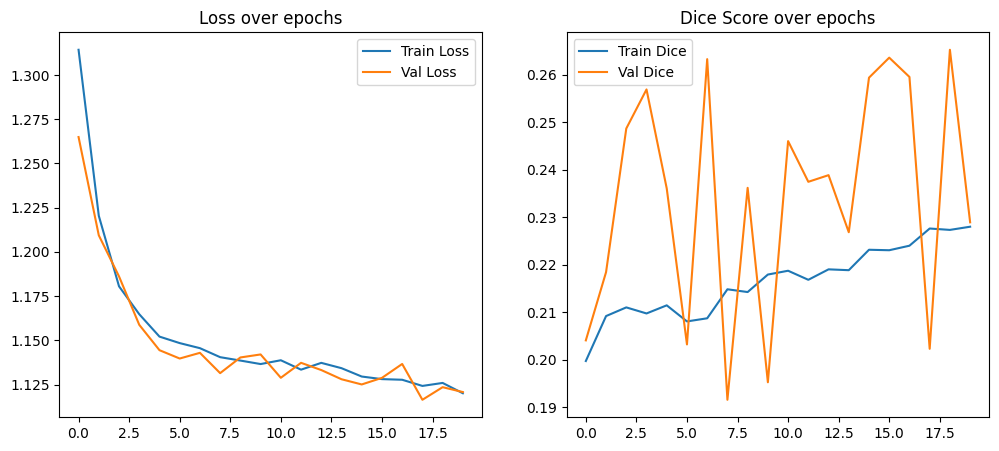


Final Test Results:
Test Loss: 1.1429 | Test Dice: 0.2165


TypeError: Invalid shape (256,) for image data

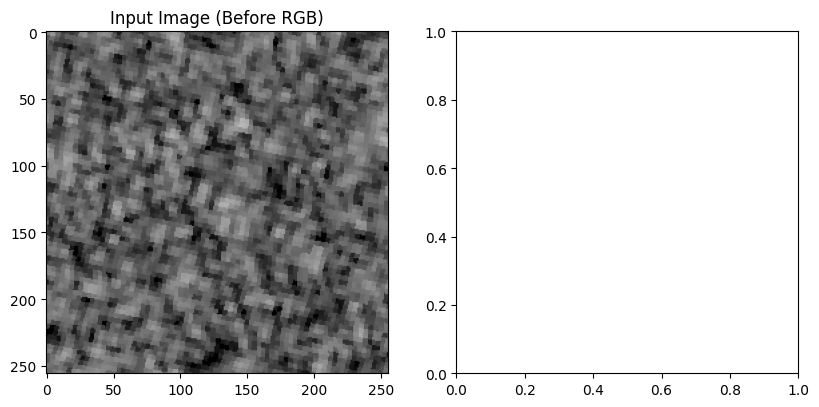

In [7]:
import os
import re
import glob
import numpy as np
from PIL import Image
import torch
from torch.utils.data import Dataset, DataLoader, random_split
import torch.nn as nn
from torch.cuda.amp import GradScaler, autocast
import matplotlib.pyplot as plt

# 1. Key extraction and dataset pairing
def extract_key(filename):
    name = os.path.basename(filename).lower()
    if any(city in name for city in ['gorakhpur', 'chennai', 'brahmaputra']):
        if 'mask' in name:
            match = re.search(r'sen_\w+_mask_(\d+)', name)
            return f'divit_{match.group(1)}' if match else None
        else:
            match = re.search(r'sen_\w+_(\d{8})_(\d+)', name)
            return f'divit_{match.group(2)}' if match else None
    if re.match(r'sen_gj_\d{4}_', name):
        match = re.search(r'sen_(\w{2})_(\d{4})', name)
        if match:
            state, tile = match.groups()
            return f"{state}_{tile}"
    match_vijay2 = re.search(r'sen_(\w{2})_(\d{6})_(\d{4})', name)
    if match_vijay2:
        state, _, tile = match_vijay2.groups()
        return f"{state}_{tile}"
    match_vijay = re.search(r'sen_(\w{2})_(\d{4})_\d{4}', name)
    if match_vijay:
        state, tile = match_vijay.groups()
        return f"{state}_{tile}"
    match_general = re.search(r'sen_(\w{2})_\d{8}_(\d{4})', name)
    if match_general:
        state, tile = match_general.groups()
        return f"{state}_{tile}"
    return None

def load_dataset(base_dir, target_size=(256, 256)):
    before_folder = os.path.join(base_dir, 'before')
    after_folder = os.path.join(base_dir, 'after')
    mask_folder = os.path.join(base_dir, 'masked')
    before_images = sorted(glob.glob(os.path.join(before_folder, '*.png')))
    after_images = sorted(glob.glob(os.path.join(after_folder, '*.png')))
    mask_images = sorted(glob.glob(os.path.join(mask_folder, '*.png')))
    before_dict = {extract_key(f): f for f in before_images if extract_key(f)}
    after_dict = {extract_key(f): f for f in after_images if extract_key(f)}
    mask_dict = {extract_key(f): f for f in mask_images if extract_key(f)}
    paired_data = []
    for key in before_dict:
        if key in after_dict and key in mask_dict:
            paired_data.append((before_dict[key], after_dict[key], mask_dict[key]))
    print(f"✅ Total Paired Samples: {len(paired_data)}")
    return paired_data

# 2. Preprocess images
IMG_SIZE = (256, 256)

def preprocess(img, is_mask=False):
    img = Image.open(img).resize(IMG_SIZE)
    img = np.array(img)
    if not is_mask:
        if img.ndim == 2:  # grayscale to 3-channel
            img = np.stack([img]*3, axis=-1)
        img = img.astype(np.float32) / 255.0
        img = np.transpose(img, (2, 0, 1))  # HWC -> CHW
    else:
        if img.ndim == 3:
            img = img[:, :, 0]
        img = (img > 127).astype(np.uint8)
    return img

def make_numpy_arrays(paired_data):
    before_list, after_list, mask_list = [], [], []
    for before_path, after_path, mask_path in paired_data:
        before = preprocess(before_path)
        after = preprocess(after_path)
        mask = preprocess(mask_path, is_mask=True)
        before_list.append(before)
        after_list.append(after)
        mask_list.append(mask)
    before_arr = np.stack(before_list)
    after_arr = np.stack(after_list)
    mask_arr = np.stack(mask_list)
    return before_arr, after_arr, mask_arr

# 3. Combine and create Dataset/DataLoader
class FloodDataset(Dataset):
    def __init__(self, before, after, mask):
        self.X = np.concatenate([before, after], axis=1)  # (N, 6, H, W)
        self.y = mask

    def __len__(self):
        return len(self.X)

    def __getitem__(self, idx):
        return torch.tensor(self.X[idx], dtype=torch.float32), torch.tensor(self.y[idx], dtype=torch.float32)

# 4. Define the model
class UNetPlusPlus(nn.Module):
    def __init__(self, in_channels=6, out_channels=1, deep_supervision=False):
        super(UNetPlusPlus, self).__init__()
        self.deep_supervision = deep_supervision

        def conv_block(in_c, out_c):
            return nn.Sequential(
                nn.Conv2d(in_c, out_c, 3, padding=1),
                nn.BatchNorm2d(out_c),
                nn.ReLU(inplace=True),
                nn.Conv2d(out_c, out_c, 3, padding=1),
                nn.BatchNorm2d(out_c),
                nn.ReLU(inplace=True)
            )

        self.pool = nn.MaxPool2d(2, 2)
        self.conv0_0 = conv_block(in_channels, 64)
        self.conv1_0 = conv_block(64, 128)
        self.conv2_0 = conv_block(128, 256)
        self.conv3_0 = conv_block(256, 512)
        self.conv4_0 = conv_block(512, 1024)
        self.up1_0 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.up2_0 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.up3_0 = nn.ConvTranspose2d(512, 256, 2, stride=2)
        self.up4_0 = nn.ConvTranspose2d(1024, 512, 2, stride=2)
        self.conv0_1 = conv_block(64+64, 64)
        self.conv1_1 = conv_block(128+128, 128)
        self.conv2_1 = conv_block(256+256, 256)
        self.conv3_1 = conv_block(512+512, 512)
        self.up1_1 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.up2_1 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.up3_1 = nn.ConvTranspose2d(512, 256, 2, stride=2)
        self.conv0_2 = conv_block(64*3, 64)
        self.conv1_2 = conv_block(128*3, 128)
        self.conv2_2 = conv_block(256*3, 256)
        self.up1_2 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.up2_2 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.conv0_3 = conv_block(64*4, 64)
        self.conv1_3 = conv_block(128*4, 128)
        self.up1_3 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.conv0_4 = conv_block(64*5, 64)
        self.final = nn.Conv2d(64, out_channels, kernel_size=1)

    def forward(self, x):
        x0_0 = self.conv0_0(x)
        x1_0 = self.conv1_0(self.pool(x0_0))
        x0_1 = self.conv0_1(torch.cat([x0_0, self.up1_0(x1_0)], 1))
        x2_0 = self.conv2_0(self.pool(x1_0))
        x1_1 = self.conv1_1(torch.cat([x1_0, self.up2_0(x2_0)], 1))
        x0_2 = self.conv0_2(torch.cat([x0_0, x0_1, self.up1_1(x1_1)], 1))
        x3_0 = self.conv3_0(self.pool(x2_0))
        x2_1 = self.conv2_1(torch.cat([x2_0, self.up3_0(x3_0)], 1))
        x1_2 = self.conv1_2(torch.cat([x1_0, x1_1, self.up2_1(x2_1)], 1))
        x0_3 = self.conv0_3(torch.cat([x0_0, x0_1, x0_2, self.up1_2(x1_2)], 1))
        x4_0 = self.conv4_0(self.pool(x3_0))
        x3_1 = self.conv3_1(torch.cat([x3_0, self.up4_0(x4_0)], 1))
        x2_2 = self.conv2_2(torch.cat([x2_0, x2_1, self.up3_1(x3_1)], 1))
        x1_3 = self.conv1_3(torch.cat([x1_0, x1_1, x1_2, self.up2_2(x2_2)], 1))
        x0_4 = self.conv0_4(torch.cat([x0_0, x0_1, x0_2, x0_3, self.up1_3(x1_3)], 1))
        output = self.final(x0_4)
        return output

# 5. Prepare data arrays and DataLoaders
base_dir = "/kaggle/input/compvisdata/compvis/Data"  # Adjust if needed
paired_data = load_dataset(base_dir)
before_arr, after_arr, mask_arr = make_numpy_arrays(paired_data)
dataset = FloodDataset(before_arr, after_arr, mask_arr)
total = len(dataset)
train_size = int(0.7 * total)
val_size = int(0.15 * total)
test_size = total - train_size - val_size
train_ds, val_ds, test_ds = random_split(dataset, [train_size, val_size, test_size])
train_loader = DataLoader(train_ds, batch_size=8, shuffle=True, pin_memory=True)
val_loader = DataLoader(val_ds, batch_size=8, pin_memory=True)
test_loader = DataLoader(test_ds, batch_size=8, pin_memory=True)

# 6. Dice Score and Loss
def dice_score(pred, target, smooth=1e-6):
    pred = torch.sigmoid(pred)
    pred = (pred > 0.5).float()
    target = target.float()
    intersection = (pred * target).sum(dim=(1,2,3))
    union = pred.sum(dim=(1,2,3)) + target.sum(dim=(1,2,3))
    dice = (2 * intersection + smooth) / (union + smooth)
    return dice.mean().item()

class DiceBCELoss(nn.Module):
    def __init__(self):
        super(DiceBCELoss, self).__init__()
        self.bce = nn.BCEWithLogitsLoss()

    def forward(self, pred, target, smooth=1e-6):
        bce_loss = self.bce(pred, target.float())
        pred = torch.sigmoid(pred)
        pred_flat = pred.view(-1)
        target_flat = target.view(-1)
        intersection = (pred_flat * target_flat).sum()
        dice_loss = 1 - (2. * intersection + smooth) / (pred_flat.sum() + target_flat.sum() + smooth)
        return bce_loss + dice_loss

# 7. Model, Optimizer, Loss, Scaler
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = UNetPlusPlus(in_channels=6, out_channels=1).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4, weight_decay=1e-5)
scaler = GradScaler()
loss_fn = DiceBCELoss()

# 8. Model Saving and Loading
model_path = "/kaggle/working/flood_segmentation_unetplusplus_train.pth"

def save_model(model, optimizer, path):
    torch.save({
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
    }, path)
    print(f"Model saved to {path}")

def load_model(model, optimizer, path):
    if os.path.exists(path):
        checkpoint = torch.load(path, map_location=device)
        model.load_state_dict(checkpoint['model_state_dict'])
        optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
        model.eval()
        print(f"Model loaded from {path}")
        return True
    return False

model_loaded = load_model(model, optimizer, model_path)

# 9. Training and Validation Loop
best_dice = 0.500
num_epochs = 20

def train_epoch(model, loader, optimizer, loss_fn, scaler):
    model.train()
    running_loss = 0.0
    running_dice = 0.0
    for images, masks in loader:
        images, masks = images.to(device), masks.to(device).unsqueeze(1)
        optimizer.zero_grad()
        with autocast():
            preds = model(images)
            loss = loss_fn(preds, masks)
        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()
        running_loss += loss.item()
        running_dice += dice_score(preds, masks)
    return running_loss / len(loader), running_dice / len(loader)

def validate(model, loader, loss_fn):
    model.eval()
    running_loss = 0.0
    running_dice = 0.0
    with torch.no_grad():
        for images, masks in loader:
            images, masks = images.to(device), masks.to(device).unsqueeze(1)
            preds = model(images)
            loss = loss_fn(preds, masks)
            running_loss += loss.item()
            running_dice += dice_score(preds, masks)
    return running_loss / len(loader), running_dice / len(loader)

if not model_loaded:
    print("Starting training from scratch...")
    train_losses, val_losses = [], []
    train_dices, val_dices = [], []
    for epoch in range(num_epochs):
        train_loss, train_dice = train_epoch(model, train_loader, optimizer, loss_fn, scaler)
        val_loss, val_dice = validate(model, val_loader, loss_fn)
        train_losses.append(train_loss)
        train_dices.append(train_dice)
        val_losses.append(val_loss)
        val_dices.append(val_dice)
        print(f"Epoch {epoch+1}/{num_epochs}")
        print(f"Train Loss: {train_loss:.4f} | Train Dice: {train_dice:.4f}")
        print(f"Val Loss: {val_loss:.4f} | Val Dice: {val_dice:.4f}")
        if val_dice > best_dice:
            best_dice = val_dice
            save_model(model, optimizer, model_path)
            print(f"New best model saved with Dice: {best_dice:.4f}")
        print("-" * 50)
    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    plt.plot(train_losses, label='Train Loss')
    plt.plot(val_losses, label='Val Loss')
    plt.legend()
    plt.title('Loss over epochs')
    plt.subplot(1, 2, 2)
    plt.plot(train_dices, label='Train Dice')
    plt.plot(val_dices, label='Val Dice')
    plt.legend()
    plt.title('Dice Score over epochs')
    plt.show()

# 10. Test the model
test_loss, test_dice = validate(model, test_loader, loss_fn)
print(f"\nFinal Test Results:")
print(f"Test Loss: {test_loss:.4f} | Test Dice: {test_dice:.4f}")

# 11. Visualize some predictions
def visualize_predictions(model, loader, num_samples=3):
    model.eval()
    with torch.no_grad():
        for i, (images, masks) in enumerate(loader):
            if i >= num_samples:
                break
            images, masks = images.to(device), masks.to(device)
            preds = torch.sigmoid(model(images))
            preds = (preds > 0.5).float()
            img_np = images[0, :3].cpu().numpy().transpose(1, 2, 0)  # Show "before" RGB
            mask_np = masks[0, 0].cpu().numpy()
            pred_np = preds[0, 0].cpu().numpy()
            plt.figure(figsize=(15, 5))
            plt.subplot(1, 3, 1)
            plt.imshow(img_np)
            plt.title('Input Image (Before RGB)')
            plt.subplot(1, 3, 2)
            plt.imshow(mask_np, cmap='gray')
            plt.title('Ground Truth')
            plt.subplot(1, 3, 3)
            plt.imshow(pred_np, cmap='gray')
            plt.title('Prediction')
            plt.show()

visualize_predictions(model, test_loader)


In [ ]:
test_loss, test_dice = validate(model, test_loader, loss_fn)
print(f"\nFinal Test Results:")
print(f"Test Loss: {test_loss:.4f} | Test Dice: {test_dice:.4f}")

In [ ]:
import os
import re
import glob
import numpy as np
from PIL import Image
import torch
from torch.utils.data import Dataset, DataLoader, random_split
import torch.nn as nn
from torch.cuda.amp import GradScaler, autocast
import matplotlib.pyplot as plt

# 1. Key extraction and dataset pairing
def extract_key(filename):
    name = os.path.basename(filename).lower()
    if any(city in name for city in ['gorakhpur', 'chennai', 'brahmaputra']):
        if 'mask' in name:
            match = re.search(r'sen_\w+_mask_(\d+)', name)
            return f'divit_{match.group(1)}' if match else None
        else:
            match = re.search(r'sen_\w+_(\d{8})_(\d+)', name)
            return f'divit_{match.group(2)}' if match else None
    if re.match(r'sen_gj_\d{4}_', name):
        match = re.search(r'sen_(\w{2})_(\d{4})', name)
        if match:
            state, tile = match.groups()
            return f"{state}_{tile}"
    match_vijay2 = re.search(r'sen_(\w{2})_(\d{6})_(\d{4})', name)
    if match_vijay2:
        state, _, tile = match_vijay2.groups()
        return f"{state}_{tile}"
    match_vijay = re.search(r'sen_(\w{2})_(\d{4})_\d{4}', name)
    if match_vijay:
        state, tile = match_vijay.groups()
        return f"{state}_{tile}"
    match_general = re.search(r'sen_(\w{2})_\d{8}_(\d{4})', name)
    if match_general:
        state, tile = match_general.groups()
        return f"{state}_{tile}"
    return None

def load_dataset(base_dir, target_size=(256, 256)):
    before_folder = os.path.join(base_dir, 'before')
    after_folder = os.path.join(base_dir, 'after')
    mask_folder = os.path.join(base_dir, 'masked')
    before_images = sorted(glob.glob(os.path.join(before_folder, '*.png')))
    after_images = sorted(glob.glob(os.path.join(after_folder, '*.png')))
    mask_images = sorted(glob.glob(os.path.join(mask_folder, '*.png')))
    before_dict = {extract_key(f): f for f in before_images if extract_key(f)}
    after_dict = {extract_key(f): f for f in after_images if extract_key(f)}
    mask_dict = {extract_key(f): f for f in mask_images if extract_key(f)}
    paired_data = []
    for key in before_dict:
        if key in after_dict and key in mask_dict:
            paired_data.append((before_dict[key], after_dict[key], mask_dict[key]))
    print(f"✅ Total Paired Samples: {len(paired_data)}")
    return paired_data

# 2. Preprocess images
IMG_SIZE = (256, 256)

def preprocess(img, is_mask=False):
    img = Image.open(img).resize(IMG_SIZE)
    if not is_mask:
        img = img.convert('RGB')
        img = np.array(img).astype(np.float32) / 255.0
        img = np.transpose(img, (2, 0, 1))  # HWC -> CHW
    else:
        img = img.convert('L')
        img = np.array(img)
        img = (img > 127).astype(np.float32)
    return img

def make_numpy_arrays(paired_data):
    before_list, after_list, mask_list = [], [], []
    for before_path, after_path, mask_path in paired_data:
        before = preprocess(before_path)
        after = preprocess(after_path)
        mask = preprocess(mask_path, is_mask=True)
        before_list.append(before)
        after_list.append(after)
        mask_list.append(mask)
    before_arr = np.stack(before_list)
    after_arr = np.stack(after_list)
    mask_arr = np.stack(mask_list)
    return before_arr, after_arr, mask_arr

# 3. Combine and create Dataset/DataLoader
class FloodDataset(Dataset):
    def __init__(self, before, after, mask):
        self.X = np.concatenate([before, after], axis=1)  # (N, 6, H, W)
        self.y = mask

    def __len__(self):
        return len(self.X)

    def __getitem__(self, idx):
        x = torch.tensor(self.X[idx], dtype=torch.float32)
        y = torch.tensor(self.y[idx], dtype=torch.float32)
        if y.ndim == 2:
            y = y.unsqueeze(0)  # (1, H, W)
        return x, y

# 4. Define the model
class UNetPlusPlus(nn.Module):
    def __init__(self, in_channels=6, out_channels=1, deep_supervision=False):
        super(UNetPlusPlus, self).__init__()
        self.deep_supervision = deep_supervision
        def conv_block(in_c, out_c):
            return nn.Sequential(
                nn.Conv2d(in_c, out_c, 3, padding=1),
                nn.BatchNorm2d(out_c),
                nn.ReLU(inplace=True),
                nn.Conv2d(out_c, out_c, 3, padding=1),
                nn.BatchNorm2d(out_c),
                nn.ReLU(inplace=True)
            )
        self.pool = nn.MaxPool2d(2, 2)
        self.conv0_0 = conv_block(in_channels, 64)
        self.conv1_0 = conv_block(64, 128)
        self.conv2_0 = conv_block(128, 256)
        self.conv3_0 = conv_block(256, 512)
        self.conv4_0 = conv_block(512, 1024)
        self.up1_0 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.up2_0 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.up3_0 = nn.ConvTranspose2d(512, 256, 2, stride=2)
        self.up4_0 = nn.ConvTranspose2d(1024, 512, 2, stride=2)
        self.conv0_1 = conv_block(64+64, 64)
        self.conv1_1 = conv_block(128+128, 128)
        self.conv2_1 = conv_block(256+256, 256)
        self.conv3_1 = conv_block(512+512, 512)
        self.up1_1 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.up2_1 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.up3_1 = nn.ConvTranspose2d(512, 256, 2, stride=2)
        self.conv0_2 = conv_block(64*3, 64)
        self.conv1_2 = conv_block(128*3, 128)
        self.conv2_2 = conv_block(256*3, 256)
        self.up1_2 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.up2_2 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.conv0_3 = conv_block(64*4, 64)
        self.conv1_3 = conv_block(128*4, 128)
        self.up1_3 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.conv0_4 = conv_block(64*5, 64)
        self.final = nn.Conv2d(64, out_channels, kernel_size=1)
    def forward(self, x):
        x0_0 = self.conv0_0(x)
        x1_0 = self.conv1_0(self.pool(x0_0))
        x0_1 = self.conv0_1(torch.cat([x0_0, self.up1_0(x1_0)], 1))
        x2_0 = self.conv2_0(self.pool(x1_0))
        x1_1 = self.conv1_1(torch.cat([x1_0, self.up2_0(x2_0)], 1))
        x0_2 = self.conv0_2(torch.cat([x0_0, x0_1, self.up1_1(x1_1)], 1))
        x3_0 = self.conv3_0(self.pool(x2_0))
        x2_1 = self.conv2_1(torch.cat([x2_0, self.up3_0(x3_0)], 1))
        x1_2 = self.conv1_2(torch.cat([x1_0, x1_1, self.up2_1(x2_1)], 1))
        x0_3 = self.conv0_3(torch.cat([x0_0, x0_1, x0_2, self.up1_2(x1_2)], 1))
        x4_0 = self.conv4_0(self.pool(x3_0))
        x3_1 = self.conv3_1(torch.cat([x3_0, self.up4_0(x4_0)], 1))
        x2_2 = self.conv2_2(torch.cat([x2_0, x2_1, self.up3_1(x3_1)], 1))
        x1_3 = self.conv1_3(torch.cat([x1_0, x1_1, x1_2, self.up2_2(x2_2)], 1))
        x0_4 = self.conv0_4(torch.cat([x0_0, x0_1, x0_2, x0_3, self.up1_3(x1_3)], 1))
        output = self.final(x0_4)
        return output

# 5. Prepare data arrays and DataLoaders
base_dir = "/kaggle/input/compvisdata/compvis/Data"  # Adjust if needed
paired_data = load_dataset(base_dir)
before_arr, after_arr, mask_arr = make_numpy_arrays(paired_data)
dataset = FloodDataset(before_arr, after_arr, mask_arr)
total = len(dataset)
train_size = int(0.7 * total)
val_size = int(0.15 * total)
test_size = total - train_size - val_size
train_ds, val_ds, test_ds = random_split(dataset, [train_size, val_size, test_size])
train_loader = DataLoader(train_ds, batch_size=8, shuffle=True, pin_memory=True)
val_loader = DataLoader(val_ds, batch_size=8, pin_memory=True)
test_loader = DataLoader(test_ds, batch_size=8, pin_memory=True)

# 6. Dice Score and Loss
def dice_score(pred, target, smooth=1e-6):
    pred = torch.sigmoid(pred)
    pred = (pred > 0.5).float()
    target = target.float()
    intersection = (pred * target).sum(dim=(1,2,3))
    union = pred.sum(dim=(1,2,3)) + target.sum(dim=(1,2,3))
    dice = (2 * intersection + smooth) / (union + smooth)
    return dice.mean().item()

class DiceBCELoss(nn.Module):
    def __init__(self):
        super(DiceBCELoss, self).__init__()
        self.bce = nn.BCEWithLogitsLoss()
    def forward(self, pred, target, smooth=1e-6):
        bce_loss = self.bce(pred, target.float())
        pred = torch.sigmoid(pred)
        pred_flat = pred.view(-1)
        target_flat = target.view(-1)
        intersection = (pred_flat * target_flat).sum()
        dice_loss = 1 - (2. * intersection + smooth) / (pred_flat.sum() + target_flat.sum() + smooth)
        return bce_loss + dice_loss

# 7. Model, Optimizer, Loss, Scaler
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = UNetPlusPlus(in_channels=6, out_channels=1).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4, weight_decay=1e-5)
scaler = GradScaler()
loss_fn = DiceBCELoss()

# 8. Model Saving and Loading
model_path = "/kaggle/working/flood_segmentation_unetplusplus_train.pth"
def save_model(model, optimizer, path):
    torch.save({
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
    }, path)
    print(f"Model saved to {path}")

def load_model(model, optimizer, path):
    if os.path.exists(path):
        checkpoint = torch.load(path, map_location=device)
        model.load_state_dict(checkpoint['model_state_dict'])
        optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
        model.eval()
        print(f"Model loaded from {path}")
        return True
    return False

model_loaded = load_model(model, optimizer, model_path)

# 9. Training and Validation Loop
best_dice = 0.500
num_epochs = 20
def train_epoch(model, loader, optimizer, loss_fn, scaler):
    model.train()
    running_loss = 0.0
    running_dice = 0.0
    for images, masks in loader:
        images, masks = images.to(device), masks.to(device)  # FIXED: no .unsqueeze(1)
        optimizer.zero_grad()
        with autocast():
            preds = model(images)
            loss = loss_fn(preds, masks)
        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()
        running_loss += loss.item()
        running_dice += dice_score(preds, masks)
    return running_loss / len(loader), running_dice / len(loader)

def validate(model, loader, loss_fn):
    model.eval()
    running_loss = 0.0
    running_dice = 0.0
    with torch.no_grad():
        for images, masks in loader:
            images, masks = images.to(device), masks.to(device)  # FIXED: no .unsqueeze(1)
            preds = model(images)
            loss = loss_fn(preds, masks)
            running_loss += loss.item()
            running_dice += dice_score(preds, masks)
    return running_loss / len(loader), running_dice / len(loader)

if not model_loaded:
    print("Starting training from scratch...")
    train_losses, val_losses = [], []
    train_dices, val_dices = [], []
    for epoch in range(num_epochs):
        train_loss, train_dice = train_epoch(model, train_loader, optimizer, loss_fn, scaler)
        val_loss, val_dice = validate(model, val_loader, loss_fn)
        train_losses.append(train_loss)
        train_dices.append(train_dice)
        val_losses.append(val_loss)
        val_dices.append(val_dice)
        print(f"Epoch {epoch+1}/{num_epochs}")
        print(f"Train Loss: {train_loss:.4f} | Train Dice: {train_dice:.4f}")
        print(f"Val Loss: {val_loss:.4f} | Val Dice: {val_dice:.4f}")
        if val_dice > best_dice:
            best_dice = val_dice
            save_model(model, optimizer, model_path)
            print(f"New best model saved with Dice: {best_dice:.4f}")
        print("-" * 50)
    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    plt.plot(train_losses, label='Train Loss')
    plt.plot(val_losses, label='Val Loss')
    plt.legend()
    plt.title('Loss over epochs')
    plt.subplot(1, 2, 2)
    plt.plot(train_dices, label='Train Dice')
    plt.plot(val_dices, label='Val Dice')
    plt.legend()
    plt.title('Dice Score over epochs')
    plt.show()

# 10. Test the model
test_loss, test_dice = validate(model, test_loader, loss_fn)
print(f"\nFinal Test Results:")
print(f"Test Loss: {test_loss:.4f} | Test Dice: {test_dice:.4f}")

# 11. Visualize some predictions
def visualize_predictions(model, loader, num_samples=3):
    model.eval()
    with torch.no_grad():
        for i, (images, masks) in enumerate(loader):
            if i >= num_samples:
                break
            images, masks = images.to(device), masks.to(device)
            preds = torch.sigmoid(model(images))
            preds = (preds > 0.5).float()
            img_np = images[0, :3].cpu().numpy().transpose(1, 2, 0)  # Show "before" RGB
            mask_np = masks[0, 0].cpu().numpy()
            pred_np = preds[0, 0].cpu().numpy()
            plt.figure(figsize=(15, 5))
            plt.subplot(1, 3, 1)
            plt.imshow(img_np)
            plt.title('Input Image (Before RGB)')
            plt.subplot(1, 3, 2)
            plt.imshow(mask_np, cmap='gray')
            plt.title('Ground Truth')
            plt.subplot(1, 3, 3)
            plt.imshow(pred_np, cmap='gray')
            plt.title('Prediction')
            plt.show()

visualize_predictions(model, test_loader)


✅ Total Paired Samples: 2734


/tmp/ipykernel_31/3177711520.py:204: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler()
/tmp/ipykernel_31/3177711520.py:238: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():


Starting training from scratch...
Epoch 1/20
Train Loss: 1.2224 | Train Dice: 0.1873
Val Loss: 1.1846 | Val Dice: 0.2228
--------------------------------------------------
Epoch 2/20
Train Loss: 1.1702 | Train Dice: 0.1940
Val Loss: 1.1527 | Val Dice: 0.2018
--------------------------------------------------
Epoch 3/20
Train Loss: 1.1564 | Train Dice: 0.2054
Val Loss: 1.1665 | Val Dice: 0.1980
--------------------------------------------------
Epoch 4/20
Train Loss: 1.1520 | Train Dice: 0.2056
Val Loss: 1.1609 | Val Dice: 0.2173
--------------------------------------------------
Epoch 5/20
Train Loss: 1.1484 | Train Dice: 0.2117
Val Loss: 1.1430 | Val Dice: 0.2092
--------------------------------------------------


In [1]:
import os
import re
import glob
import numpy as np
from PIL import Image

def extract_key(filename):
    name = os.path.basename(filename).lower()
    if any(city in name for city in ['gorakhpur', 'chennai', 'brahmaputra']):
        if 'mask' in name:
            match = re.search(r'sen_\w+_mask_(\d+)', name)
            return f'divit_{match.group(1)}' if match else None
        else:
            match = re.search(r'sen_\w+_(\d{8})_(\d+)', name)
            return f'divit_{match.group(2)}' if match else None
    if re.match(r'sen_gj_\d{4}_', name):
        match = re.search(r'sen_(\w{2})_(\d{4})', name)
        if match:
            state, tile = match.groups()
            return f"{state}_{tile}"
    match_vijay2 = re.search(r'sen_(\w{2})_(\d{6})_(\d{4})', name)
    if match_vijay2:
        state, _, tile = match_vijay2.groups()
        return f"{state}_{tile}"
    match_vijay = re.search(r'sen_(\w{2})_(\d{4})_\d{4}', name)
    if match_vijay:
        state, tile = match_vijay.groups()
        return f"{state}_{tile}"
    match_general = re.search(r'sen_(\w{2})_\d{8}_(\d{4})', name)
    if match_general:
        state, tile = match_general.groups()
        return f"{state}_{tile}"
    return None

def load_dataset(base_dir, target_size=(256, 256)):
    before_folder = os.path.join(base_dir, 'before')
    after_folder = os.path.join(base_dir, 'after')
    mask_folder = os.path.join(base_dir, 'masked')
    before_images = sorted(glob.glob(os.path.join(before_folder, '*.png')))
    after_images = sorted(glob.glob(os.path.join(after_folder, '*.png')))
    mask_images = sorted(glob.glob(os.path.join(mask_folder, '*.png')))
    before_dict = {extract_key(f): f for f in before_images if extract_key(f)}
    after_dict = {extract_key(f): f for f in after_images if extract_key(f)}
    mask_dict = {extract_key(f): f for f in mask_images if extract_key(f)}
    paired_data = []
    for key in before_dict:
        if key in after_dict and key in mask_dict:
            paired_data.append((before_dict[key], after_dict[key], mask_dict[key]))
    print(f"✅ Total Paired Samples: {len(paired_data)}")
    return paired_data

def save_npz_from_paired_images(paired_data, output_path, target_size=(256, 256)):
    before_list, after_list, mask_list = [], [], []
    for before_path, after_path, mask_path in paired_data:
        before_img = Image.open(before_path).convert('RGB').resize(target_size)
        after_img = Image.open(after_path).convert('RGB').resize(target_size)
        mask_img = Image.open(mask_path).convert('L').resize(target_size)
        before_arr = np.array(before_img).astype(np.float32)
        after_arr = np.array(after_img).astype(np.float32)
        mask_arr = np.array(mask_img).astype(np.uint8)
        mask_arr = (mask_arr > 127).astype(np.uint8)
        before_list.append(before_arr)
        after_list.append(after_arr)
        mask_list.append(mask_arr)
    before_np = np.stack(before_list)
    after_np = np.stack(after_list)
    mask_np = np.stack(mask_list)
    np.savez_compressed(output_path, before=before_np, after=after_np, mask=mask_np)
    print(f"Saved .npz file to {output_path}")

# --- Run this once to create your .npz file ---
base_dir = "/kaggle/input/compvisdata/compvis/Data"  # Adjust as needed
paired_data = load_dataset(base_dir)
save_npz_from_paired_images(paired_data, "flood_data.npz")


✅ Total Paired Samples: 2734
Saved .npz file to flood_data.npz


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, random_split
from torch.cuda.amp import GradScaler, autocast
import os

# 1. Load .npz data
data = np.load("flood_data.npz")
before_dataset = data['before']  # (N, H, W, 3)
after_dataset = data['after']    # (N, H, W, 3)
mask_dataset = data['mask']      # (N, H, W)

IMG_SIZE = (256, 256)

def preprocess(img, is_mask=False):
    if not is_mask:
        img = img.astype(np.float32) / 255.0
        img = np.transpose(img, (2, 0, 1))  # HWC -> CHW
    else:
        if img.ndim == 3:
            img = img[:, :, 0]
        img = (img > 0.5).astype(np.float32)
    return img

before_dataset = np.array([preprocess(img) for img in before_dataset])
after_dataset = np.array([preprocess(img) for img in after_dataset])
mask_dataset = np.array([preprocess(mask, is_mask=True) for mask in mask_dataset])

combined_dataset = np.concatenate([before_dataset, after_dataset], axis=1)  # (N, 6, H, W)

class FloodDataset(Dataset):
    def __init__(self, X, y):
        self.X = X
        self.y = y
    def __len__(self):
        return len(self.X)
    def __getitem__(self, idx):
        return torch.tensor(self.X[idx], dtype=torch.float32), torch.tensor(self.y[idx], dtype=torch.float32).unsqueeze(0)

dataset = FloodDataset(combined_dataset, mask_dataset)
total = len(dataset)
train_size = int(0.7 * total)
val_size = int(0.15 * total)
test_size = total - train_size - val_size

train_ds, val_ds, test_ds = random_split(dataset, [train_size, val_size, test_size])
train_loader = DataLoader(train_ds, batch_size=8, shuffle=True, pin_memory=True)
val_loader = DataLoader(val_ds, batch_size=8, pin_memory=True)
test_loader = DataLoader(test_ds, batch_size=8, pin_memory=True)

# UNet++ Model
class UNetPlusPlus(nn.Module):
    def __init__(self, in_channels=6, out_channels=1, deep_supervision=True):
        super(UNetPlusPlus, self).__init__()
        self.deep_supervision = deep_supervision
        def conv_block(in_c, out_c):
            return nn.Sequential(
                nn.Conv2d(in_c, out_c, 3, padding=1),
                nn.BatchNorm2d(out_c),
                nn.ReLU(inplace=True),
                nn.Conv2d(out_c, out_c, 3, padding=1),
                nn.BatchNorm2d(out_c),
                nn.ReLU(inplace=True)
            )
        self.pool = nn.MaxPool2d(2, 2)
        self.conv0_0 = conv_block(in_channels, 64)
        self.conv1_0 = conv_block(64, 128)
        self.conv2_0 = conv_block(128, 256)
        self.conv3_0 = conv_block(256, 512)
        self.conv4_0 = conv_block(512, 1024)
        self.up1_0 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.up2_0 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.up3_0 = nn.ConvTranspose2d(512, 256, 2, stride=2)
        self.up4_0 = nn.ConvTranspose2d(1024, 512, 2, stride=2)
        self.conv0_1 = conv_block(64+64, 64)
        self.conv1_1 = conv_block(128+128, 128)
        self.conv2_1 = conv_block(256+256, 256)
        self.conv3_1 = conv_block(512+512, 512)
        self.up1_1 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.up2_1 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.up3_1 = nn.ConvTranspose2d(512, 256, 2, stride=2)
        self.conv0_2 = conv_block(64*3, 64)
        self.conv1_2 = conv_block(128*3, 128)
        self.conv2_2 = conv_block(256*3, 256)
        self.up1_2 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.up2_2 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.conv0_3 = conv_block(64*4, 64)
        self.conv1_3 = conv_block(128*4, 128)
        self.up1_3 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.conv0_4 = conv_block(64*5, 64)
        self.final = nn.Conv2d(64, out_channels, kernel_size=1)
    def forward(self, x):
        x0_0 = self.conv0_0(x)
        x1_0 = self.conv1_0(self.pool(x0_0))
        x0_1 = self.conv0_1(torch.cat([x0_0, self.up1_0(x1_0)], 1))
        x2_0 = self.conv2_0(self.pool(x1_0))
        x1_1 = self.conv1_1(torch.cat([x1_0, self.up2_0(x2_0)], 1))
        x0_2 = self.conv0_2(torch.cat([x0_0, x0_1, self.up1_1(x1_1)], 1))
        x3_0 = self.conv3_0(self.pool(x2_0))
        x2_1 = self.conv2_1(torch.cat([x2_0, self.up3_0(x3_0)], 1))
        x1_2 = self.conv1_2(torch.cat([x1_0, x1_1, self.up2_1(x2_1)], 1))
        x0_3 = self.conv0_3(torch.cat([x0_0, x0_1, x0_2, self.up1_2(x1_2)], 1))
        x4_0 = self.conv4_0(self.pool(x3_0))
        x3_1 = self.conv3_1(torch.cat([x3_0, self.up4_0(x4_0)], 1))
        x2_2 = self.conv2_2(torch.cat([x2_0, x2_1, self.up3_1(x3_1)], 1))
        x1_3 = self.conv1_3(torch.cat([x1_0, x1_1, x1_2, self.up2_2(x2_2)], 1))
        x0_4 = self.conv0_4(torch.cat([x0_0, x0_1, x0_2, x0_3, self.up1_3(x1_3)], 1))
        output = self.final(x0_4)
        return output

def dice_score(pred, target, smooth=1e-6):
    pred = torch.sigmoid(pred)
    pred = (pred > 0.5).float()
    target = target.float()
    intersection = (pred * target).sum(dim=(1,2,3))
    union = pred.sum(dim=(1,2,3)) + target.sum(dim=(1,2,3))
    dice = (2 * intersection + smooth) / (union + smooth)
    return dice.mean().item()

class DiceBCELoss(nn.Module):
    def __init__(self):
        super(DiceBCELoss, self).__init__()
        self.bce = nn.BCEWithLogitsLoss()
    def forward(self, pred, target, smooth=1e-6):
        bce_loss = self.bce(pred, target.float())
        pred = torch.sigmoid(pred)
        pred_flat = pred.view(-1)
        target_flat = target.view(-1)
        intersection = (pred_flat * target_flat).sum()
        dice_loss = 1 - (2. * intersection + smooth) / (pred_flat.sum() + target_flat.sum() + smooth)
        return bce_loss + dice_loss

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = UNetPlusPlus(in_channels=6, out_channels=1).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4, weight_decay=1e-5)
scaler = GradScaler()
loss_fn = DiceBCELoss()
model_path = "flood_segmentation_unetplusplus_train.pth"

def save_model(model, optimizer, path):
    torch.save({
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
    }, path)
    print(f"Model saved to {path}")

def load_model(model, optimizer, path):
    if os.path.exists(path):
        checkpoint = torch.load(path, map_location=device)
        model.load_state_dict(checkpoint['model_state_dict'])
        optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
        model.eval()
        print(f"Model loaded from {path}")
        return True
    return False

model_loaded = load_model(model, optimizer, model_path)

best_dice = 0.500
num_epochs = 20

def train_epoch(model, loader, optimizer, loss_fn, scaler):
    model.train()
    running_loss = 0.0
    running_dice = 0.0
    for images, masks in loader:
        images, masks = images.to(device), masks.to(device)
        optimizer.zero_grad()
        with autocast():
            preds = model(images)
            loss = loss_fn(preds, masks)
        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()
        running_loss += loss.item()
        running_dice += dice_score(preds, masks)
    return running_loss / len(loader), running_dice / len(loader)

def validate(model, loader, loss_fn):
    model.eval()
    running_loss = 0.0
    running_dice = 0.0
    with torch.no_grad():
        for images, masks in loader:
            images, masks = images.to(device), masks.to(device)
            preds = model(images)
            loss = loss_fn(preds, masks)
            running_loss += loss.item()
            running_dice += dice_score(preds, masks)
    return running_loss / len(loader), running_dice / len(loader)

if not model_loaded:
    print("Starting training from scratch...")
    train_losses, val_losses = [], []
    train_dices, val_dices = [], []
    for epoch in range(num_epochs):
        train_loss, train_dice = train_epoch(model, train_loader, optimizer, loss_fn, scaler)
        val_loss, val_dice = validate(model, val_loader, loss_fn)
        train_losses.append(train_loss)
        train_dices.append(train_dice)
        val_losses.append(val_loss)
        val_dices.append(val_dice)
        print(f"Epoch {epoch+1}/{num_epochs}")
        print(f"Train Loss: {train_loss:.4f} | Train Dice: {train_dice:.4f}")
        print(f"Val Loss: {val_loss:.4f} | Val Dice: {val_dice:.4f}")
        if val_dice > best_dice:
            best_dice = val_dice
            save_model(model, optimizer, model_path)
            print(f"New best model saved with Dice: {best_dice:.4f}")
        print("-" * 50)
    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    plt.plot(train_losses, label='Train Loss')
    plt.plot(val_losses, label='Val Loss')
    plt.legend()
    plt.title('Loss over epochs')
    plt.subplot(1, 2, 2)
    plt.plot(train_dices, label='Train Dice')
    plt.plot(val_dices, label='Val Dice')
    plt.legend()
    plt.title('Dice Score over epochs')
    plt.show()

# 7. Test the model
test_loss, test_dice = validate(model, test_loader, loss_fn)
print(f"\nFinal Test Results:")
print(f"Test Loss: {test_loss:.4f} | Test Dice: {test_dice:.4f}")

def visualize_predictions(model, loader, num_samples=3):
    model.eval()
    with torch.no_grad():
        for i, (images, masks) in enumerate(loader):
            if i >= num_samples:
                break
            images, masks = images.to(device), masks.to(device)
            preds = torch.sigmoid(model(images))
            preds = (preds > 0.5).float()
            img_np = images[0, :3].cpu().numpy().transpose(1, 2, 0)  # Show "before" RGB
            mask_np = masks[0, 0].cpu().numpy()
            pred_np = preds[0, 0].cpu().numpy()
            plt.figure(figsize=(15, 5))
            plt.subplot(1, 3, 1)
            plt.imshow(img_np)
            plt.title('Input Image (Before RGB)')
            plt.subplot(1, 3, 2)
            plt.imshow(mask_np, cmap='gray')
            plt.title('Ground Truth')
            plt.subplot(1, 3, 3)
            plt.imshow(pred_np, cmap='gray')
            plt.title('Prediction')
            plt.show()

visualize_predictions(model, test_loader)


/tmp/ipykernel_31/2316254426.py:138: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler()
/tmp/ipykernel_31/2316254426.py:171: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():


Starting training from scratch...
Epoch 1/20
Train Loss: 1.2775 | Train Dice: 0.2088
Val Loss: 1.2285 | Val Dice: 0.2046
--------------------------------------------------
Epoch 2/20
Train Loss: 1.1961 | Train Dice: 0.2003
Val Loss: 1.1916 | Val Dice: 0.1889
--------------------------------------------------
Epoch 3/20
Train Loss: 1.1723 | Train Dice: 0.2088
Val Loss: 1.1680 | Val Dice: 0.1794
--------------------------------------------------
Epoch 4/20
Train Loss: 1.1604 | Train Dice: 0.2051
Val Loss: 1.1863 | Val Dice: 0.1964
--------------------------------------------------


In [1]:
import os
import re
import glob
import numpy as np
from PIL import Image

def extract_key(filename):
    name = os.path.basename(filename).lower()
    if any(city in name for city in ['gorakhpur', 'chennai', 'brahmaputra']):
        if 'mask' in name:
            match = re.search(r'sen_\w+_mask_(\d+)', name)
            return f'divit_{match.group(1)}' if match else None
        else:
            match = re.search(r'sen_\w+_(\d{8})_(\d+)', name)
            return f'divit_{match.group(2)}' if match else None
    if re.match(r'sen_gj_\d{4}_', name):
        match = re.search(r'sen_(\w{2})_(\d{4})', name)
        if match:
            state, tile = match.groups()
            return f"{state}_{tile}"
    match_vijay2 = re.search(r'sen_(\w{2})_(\d{6})_(\d{4})', name)
    if match_vijay2:
        state, _, tile = match_vijay2.groups()
        return f"{state}_{tile}"
    match_vijay = re.search(r'sen_(\w{2})_(\d{4})_\d{4}', name)
    if match_vijay:
        state, tile = match_vijay.groups()
        return f"{state}_{tile}"
    match_general = re.search(r'sen_(\w{2})_\d{8}_(\d{4})', name)
    if match_general:
        state, tile = match_general.groups()
        return f"{state}_{tile}"
    return None

def load_dataset(base_dir, target_size=(256, 256)):
    before_folder = os.path.join(base_dir, 'before')
    after_folder = os.path.join(base_dir, 'after')
    mask_folder = os.path.join(base_dir, 'masked')
    before_images = sorted(glob.glob(os.path.join(before_folder, '*.png')))
    after_images = sorted(glob.glob(os.path.join(after_folder, '*.png')))
    mask_images = sorted(glob.glob(os.path.join(mask_folder, '*.png')))
    before_dict = {extract_key(f): f for f in before_images if extract_key(f)}
    after_dict = {extract_key(f): f for f in after_images if extract_key(f)}
    mask_dict = {extract_key(f): f for f in mask_images if extract_key(f)}
    paired_data = []
    for key in before_dict:
        if key in after_dict and key in mask_dict:
            paired_data.append((before_dict[key], after_dict[key], mask_dict[key]))
    print(f"✅ Total Paired Samples: {len(paired_data)}")
    return paired_data

def preprocess_and_save_npz(paired_data, output_path, target_size=(256, 256)):
    before_list, after_list, mask_list = [], [], []
    for before_path, after_path, mask_path in paired_data:
        before_img = Image.open(before_path).convert('RGB').resize(target_size)
        after_img = Image.open(after_path).convert('RGB').resize(target_size)
        mask_img = Image.open(mask_path).convert('L').resize(target_size)
        before_arr = np.array(before_img).astype(np.float32)
        after_arr = np.array(after_img).astype(np.float32)
        mask_arr = np.array(mask_img).astype(np.uint8)
        mask_arr = (mask_arr > 127).astype(np.uint8)
        before_list.append(before_arr)
        after_list.append(after_arr)
        mask_list.append(mask_arr)
    before_np = np.stack(before_list)
    after_np = np.stack(after_list)
    mask_np = np.stack(mask_list)
    np.savez_compressed(output_path, before=before_np, after=after_np, mask=mask_np)
    print(f"Saved .npz file to {output_path}")

# --- Run this ONCE to create your .npz ---
base_dir = "/kaggle/input/compvisdata/compvis/Data"  # Adjust as needed
paired_data = load_dataset(base_dir)
preprocess_and_save_npz(paired_data, "flood_data.npz")


✅ Total Paired Samples: 2734
Saved .npz file to flood_data.npz


In [2]:
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, random_split
from torch.cuda.amp import GradScaler, autocast
import os
from PIL import Image

# 1. Load .npz data
data = np.load("flood_data.npz")
before_dataset = data['before']  # (N, H, W, 3)
after_dataset = data['after']    # (N, H, W, 3)
mask_dataset = data['mask']      # (N, H, W)

IMG_SIZE = (256, 256)

def preprocess(img, is_mask=False):
    # Remove singleton dimensions if present
    img = np.squeeze(img)
    if not is_mask:
        # Ensure img is (H, W, 3) and uint8 for PIL
        if img.dtype != np.uint8:
            img = (img * 255).clip(0,255).astype(np.uint8) if img.max() <= 1.0 else img.astype(np.uint8)
        if img.ndim == 2:
            img = np.stack([img]*3, axis=-1)
        img = Image.fromarray(img)
        img = img.resize(IMG_SIZE)
        img = np.array(img).astype(np.float32) / 255.0
        img = np.transpose(img, (2, 0, 1))  # HWC -> CHW
    else:
        # Ensure mask is (H, W) and uint8 for PIL
        if img.dtype != np.uint8:
            img = (img * 255).clip(0,255).astype(np.uint8) if img.max() <= 1.0 else img.astype(np.uint8)
        if img.ndim == 3:
            img = img[:, :, 0]
        img = Image.fromarray(img)
        img = img.resize(IMG_SIZE)
        img = np.array(img)
        img = (img > 127).astype(np.float32)
    return img

before_dataset = np.array([preprocess(img) for img in before_dataset])
after_dataset = np.array([preprocess(img) for img in after_dataset])
mask_dataset = np.array([preprocess(mask, is_mask=True) for mask in mask_dataset])

combined_dataset = np.concatenate([before_dataset, after_dataset], axis=1)  # (N, 6, H, W)

class FloodDataset(Dataset):
    def __init__(self, X, y):
        self.X = X
        self.y = y
    def __len__(self):
        return len(self.X)
    def __getitem__(self, idx):
        return torch.tensor(self.X[idx], dtype=torch.float32), torch.tensor(self.y[idx], dtype=torch.float32).unsqueeze(0)

dataset = FloodDataset(combined_dataset, mask_dataset)
total = len(dataset)
train_size = int(0.7 * total)
val_size = int(0.15 * total)
test_size = total - train_size - val_size

train_ds, val_ds, test_ds = random_split(dataset, [train_size, val_size, test_size])
train_loader = DataLoader(train_ds, batch_size=8, shuffle=True, pin_memory=True)
val_loader = DataLoader(val_ds, batch_size=8, pin_memory=True)
test_loader = DataLoader(test_ds, batch_size=8, pin_memory=True)

# UNet++ Model
class UNetPlusPlus(nn.Module):
    def __init__(self, in_channels=6, out_channels=1, deep_supervision=True):
        super(UNetPlusPlus, self).__init__()
        self.deep_supervision = deep_supervision
        def conv_block(in_c, out_c):
            return nn.Sequential(
                nn.Conv2d(in_c, out_c, 3, padding=1),
                nn.BatchNorm2d(out_c),
                nn.ReLU(inplace=True),
                nn.Conv2d(out_c, out_c, 3, padding=1),
                nn.BatchNorm2d(out_c),
                nn.ReLU(inplace=True)
            )
        self.pool = nn.MaxPool2d(2, 2)
        self.conv0_0 = conv_block(in_channels, 64)
        self.conv1_0 = conv_block(64, 128)
        self.conv2_0 = conv_block(128, 256)
        self.conv3_0 = conv_block(256, 512)
        self.conv4_0 = conv_block(512, 1024)
        self.up1_0 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.up2_0 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.up3_0 = nn.ConvTranspose2d(512, 256, 2, stride=2)
        self.up4_0 = nn.ConvTranspose2d(1024, 512, 2, stride=2)
        self.conv0_1 = conv_block(64+64, 64)
        self.conv1_1 = conv_block(128+128, 128)
        self.conv2_1 = conv_block(256+256, 256)
        self.conv3_1 = conv_block(512+512, 512)
        self.up1_1 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.up2_1 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.up3_1 = nn.ConvTranspose2d(512, 256, 2, stride=2)
        self.conv0_2 = conv_block(64*3, 64)
        self.conv1_2 = conv_block(128*3, 128)
        self.conv2_2 = conv_block(256*3, 256)
        self.up1_2 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.up2_2 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.conv0_3 = conv_block(64*4, 64)
        self.conv1_3 = conv_block(128*4, 128)
        self.up1_3 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.conv0_4 = conv_block(64*5, 64)
        self.final = nn.Conv2d(64, out_channels, kernel_size=1)
    def forward(self, x):
        x0_0 = self.conv0_0(x)
        x1_0 = self.conv1_0(self.pool(x0_0))
        x0_1 = self.conv0_1(torch.cat([x0_0, self.up1_0(x1_0)], 1))
        x2_0 = self.conv2_0(self.pool(x1_0))
        x1_1 = self.conv1_1(torch.cat([x1_0, self.up2_0(x2_0)], 1))
        x0_2 = self.conv0_2(torch.cat([x0_0, x0_1, self.up1_1(x1_1)], 1))
        x3_0 = self.conv3_0(self.pool(x2_0))
        x2_1 = self.conv2_1(torch.cat([x2_0, self.up3_0(x3_0)], 1))
        x1_2 = self.conv1_2(torch.cat([x1_0, x1_1, self.up2_1(x2_1)], 1))
        x0_3 = self.conv0_3(torch.cat([x0_0, x0_1, x0_2, self.up1_2(x1_2)], 1))
        x4_0 = self.conv4_0(self.pool(x3_0))
        x3_1 = self.conv3_1(torch.cat([x3_0, self.up4_0(x4_0)], 1))
        x2_2 = self.conv2_2(torch.cat([x2_0, x2_1, self.up3_1(x3_1)], 1))
        x1_3 = self.conv1_3(torch.cat([x1_0, x1_1, x1_2, self.up2_2(x2_2)], 1))
        x0_4 = self.conv0_4(torch.cat([x0_0, x0_1, x0_2, x0_3, self.up1_3(x1_3)], 1))
        output = self.final(x0_4)
        return output

def dice_score(pred, target, smooth=1e-6):
    pred = torch.sigmoid(pred)
    pred = (pred > 0.5).float()
    target = target.float()
    intersection = (pred * target).sum(dim=(1,2,3))
    union = pred.sum(dim=(1,2,3)) + target.sum(dim=(1,2,3))
    dice = (2 * intersection + smooth) / (union + smooth)
    return dice.mean().item()

class DiceBCELoss(nn.Module):
    def __init__(self):
        super(DiceBCELoss, self).__init__()
        self.bce = nn.BCEWithLogitsLoss()
    def forward(self, pred, target, smooth=1e-6):
        bce_loss = self.bce(pred, target.float())
        pred = torch.sigmoid(pred)
        pred_flat = pred.view(-1)
        target_flat = target.view(-1)
        intersection = (pred_flat * target_flat).sum()
        dice_loss = 1 - (2. * intersection + smooth) / (pred_flat.sum() + target_flat.sum() + smooth)
        return bce_loss + dice_loss

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = UNetPlusPlus(in_channels=6, out_channels=1).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4, weight_decay=1e-5)
scaler = GradScaler()
loss_fn = DiceBCELoss()
model_path = "flood_segmentation_unetplusplus_train.pth"

def save_model(model, optimizer, path):
    torch.save({
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
    }, path)
    print(f"Model saved to {path}")

def load_model(model, optimizer, path):
    if os.path.exists(path):
        checkpoint = torch.load(path, map_location=device)
        model.load_state_dict(checkpoint['model_state_dict'])
        optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
        model.eval()
        print(f"Model loaded from {path}")
        return True
    return False

model_loaded = load_model(model, optimizer, model_path)

best_dice = 0.500
num_epochs = 20

def train_epoch(model, loader, optimizer, loss_fn, scaler):
    model.train()
    running_loss = 0.0
    running_dice = 0.0
    for images, masks in loader:
        images, masks = images.to(device), masks.to(device)
        optimizer.zero_grad()
        with autocast():
            preds = model(images)
            loss = loss_fn(preds, masks)
        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()
        running_loss += loss.item()
        running_dice += dice_score(preds, masks)
    return running_loss / len(loader), running_dice / len(loader)

def validate(model, loader, loss_fn):
    model.eval()
    running_loss = 0.0
    running_dice = 0.0
    with torch.no_grad():
        for images, masks in loader:
            images, masks = images.to(device), masks.to(device)
            preds = model(images)
            loss = loss_fn(preds, masks)
            running_loss += loss.item()
            running_dice += dice_score(preds, masks)
    return running_loss / len(loader), running_dice / len(loader)

if not model_loaded:
    print("Starting training from scratch...")
    train_losses, val_losses = [], []
    train_dices, val_dices = [], []
    for epoch in range(num_epochs):
        train_loss, train_dice = train_epoch(model, train_loader, optimizer, loss_fn, scaler)
        val_loss, val_dice = validate(model, val_loader, loss_fn)
        train_losses.append(train_loss)
        train_dices.append(train_dice)
        val_losses.append(val_loss)
        val_dices.append(val_dice)
        print(f"Epoch {epoch+1}/{num_epochs}")
        print(f"Train Loss: {train_loss:.4f} | Train Dice: {train_dice:.4f}")
        print(f"Val Loss: {val_loss:.4f} | Val Dice: {val_dice:.4f}")
        if val_dice > best_dice:
            best_dice = val_dice
            save_model(model, optimizer, model_path)
            print(f"New best model saved with Dice: {best_dice:.4f}")
        print("-" * 50)
    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    plt.plot(train_losses, label='Train Loss')
    plt.plot(val_losses, label='Val Loss')
    plt.legend()
    plt.title('Loss over epochs')
    plt.subplot(1, 2, 2)
    plt.plot(train_dices, label='Train Dice')
    plt.plot(val_dices, label='Val Dice')
    plt.legend()
    plt.title('Dice Score over epochs')
    plt.show()

# 7. Test the model
test_loss, test_dice = validate(model, test_loader, loss_fn)
print(f"\nFinal Test Results:")
print(f"Test Loss: {test_loss:.4f} | Test Dice: {test_dice:.4f}")

def visualize_predictions(model, loader, num_samples=3):
    model.eval()
    with torch.no_grad():
        for i, (images, masks) in enumerate(loader):
            if i >= num_samples:
                break
            images, masks = images.to(device), masks.to(device)
            preds = torch.sigmoid(model(images))
            preds = (preds > 0.5).float()
            img_np = images[0, :3].cpu().numpy().transpose(1, 2, 0)  # Show "before" RGB
            mask_np = masks[0, 0].cpu().numpy()
            pred_np = preds[0, 0].cpu().numpy()
            plt.figure(figsize=(15, 5))
            plt.subplot(1, 3, 1)
            plt.imshow(img_np)
            plt.title('Input Image (Before RGB)')
            plt.subplot(1, 3, 2)
            plt.imshow(mask_np, cmap='gray')
            plt.title('Ground Truth')
            plt.subplot(1, 3, 3)
            plt.imshow(pred_np, cmap='gray')
            plt.title('Prediction')
            plt.show()

visualize_predictions(model, test_loader)


/tmp/ipykernel_31/2932083183.py:154: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler()
/tmp/ipykernel_31/2932083183.py:187: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():


Starting training from scratch...
Epoch 1/20
Train Loss: 1.2597 | Train Dice: 0.6422
Val Loss: 1.1841 | Val Dice: 0.7788
Model saved to flood_segmentation_unetplusplus_train.pth
New best model saved with Dice: 0.7788
--------------------------------------------------
Epoch 2/20
Train Loss: 1.1443 | Train Dice: 0.8365
Val Loss: 1.1183 | Val Dice: 0.8149
Model saved to flood_segmentation_unetplusplus_train.pth
New best model saved with Dice: 0.8149
--------------------------------------------------
Epoch 3/20
Train Loss: 1.0949 | Train Dice: 0.9339
Val Loss: 1.0774 | Val Dice: 0.9279
Model saved to flood_segmentation_unetplusplus_train.pth
New best model saved with Dice: 0.9279
--------------------------------------------------
Epoch 4/20
Train Loss: 1.0656 | Train Dice: 0.9693
Val Loss: 1.0550 | Val Dice: 0.8462
--------------------------------------------------
Epoch 5/20
Train Loss: 1.0471 | Train Dice: 0.9979
Val Loss: 1.0397 | Val Dice: 1.0000
Model saved to flood_segmentation_unetp

KeyboardInterrupt: 

Train/Val overlap: 0
Train/Test overlap: 0
Val/Test overlap: 0
Duplicate before images: 0
Duplicate after images: 0
Duplicate masks: 2733
All-zero masks: 2734, All-one masks: 0, Total: 2734
Train Samples:


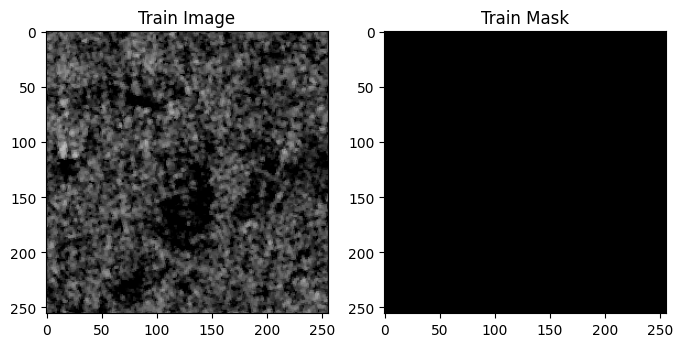

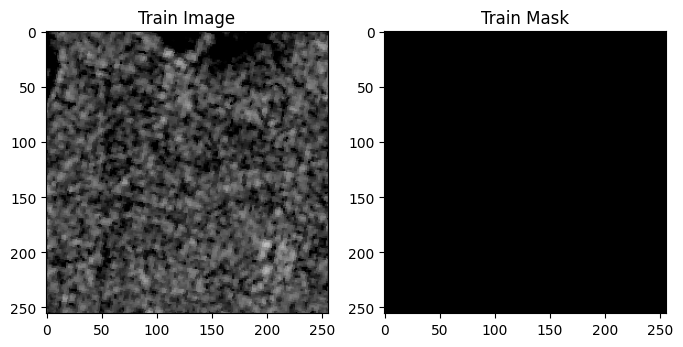

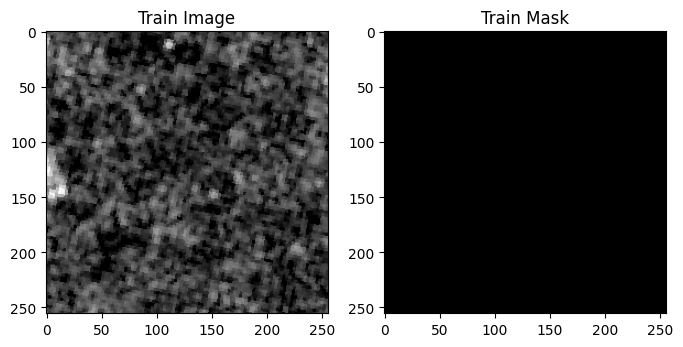

Validation Samples:


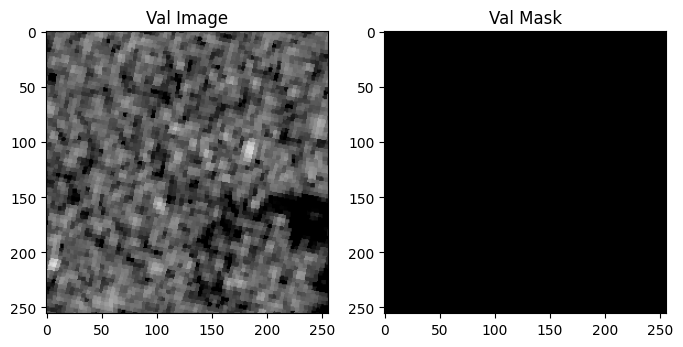

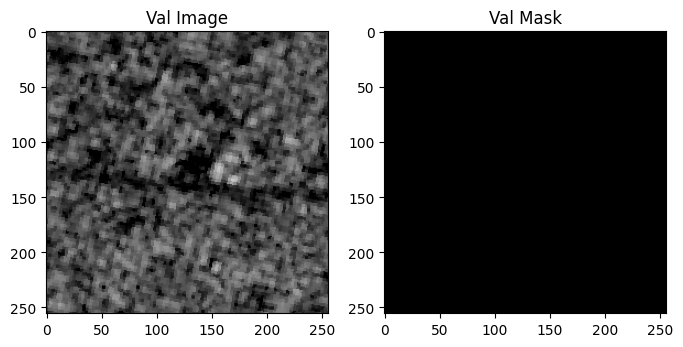

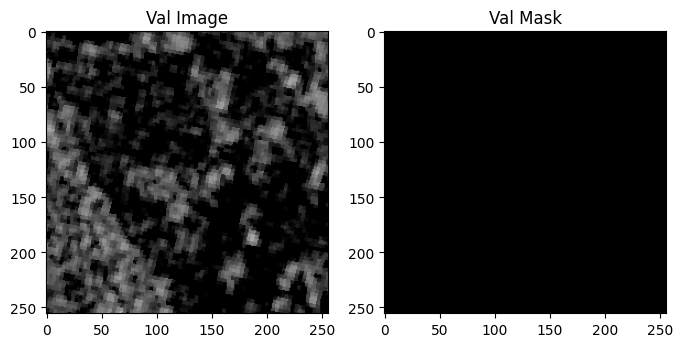

Test Samples:


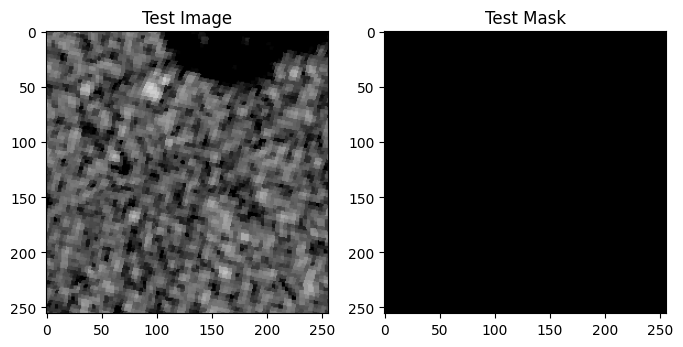

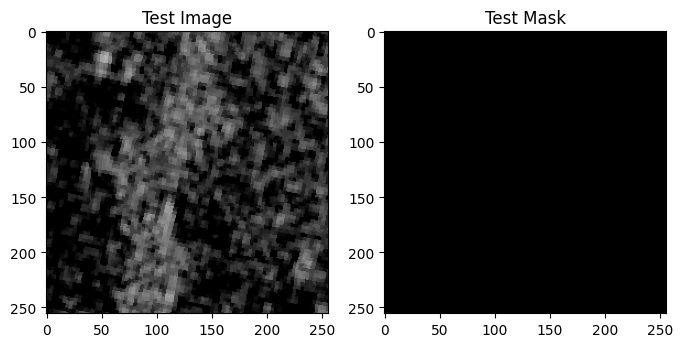

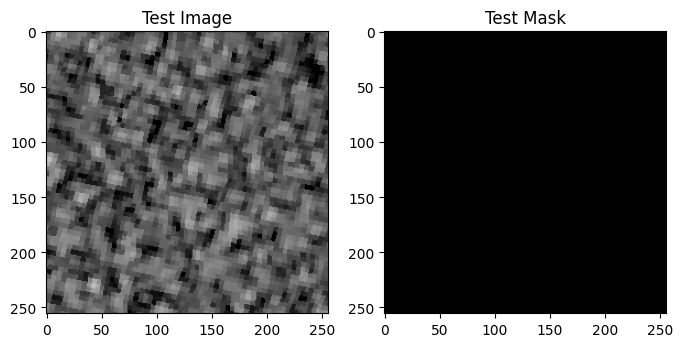

/tmp/ipykernel_31/3892581939.py:204: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler()
/tmp/ipykernel_31/3892581939.py:217: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the l

Model loaded from flood_segmentation_unetplusplus_train.pth

Final Test Results:
Test Loss: 1.0397 | Test Dice: 1.0000


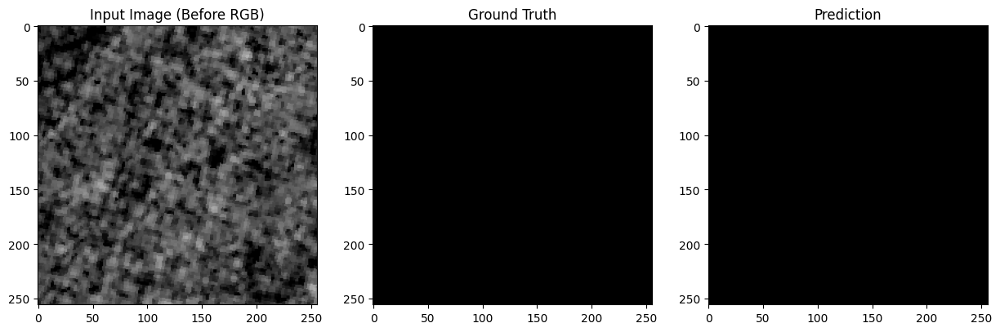

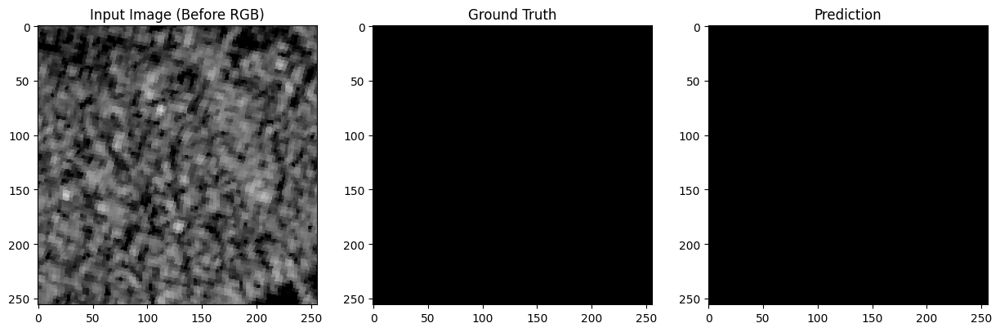

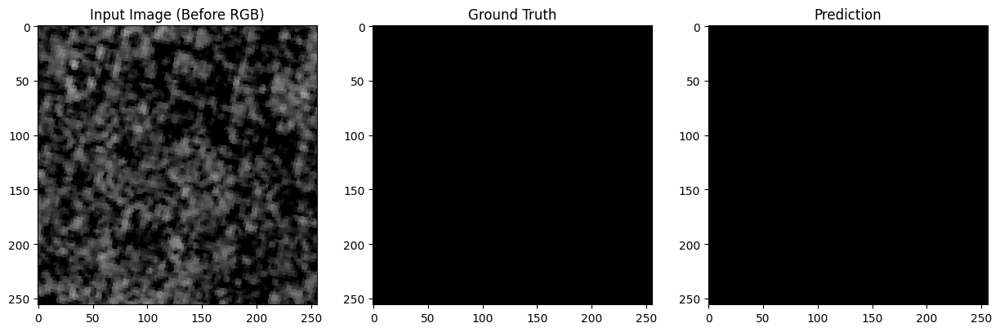

In [9]:
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, random_split
from torch.cuda.amp import GradScaler, autocast
import os
from PIL import Image
import random

# 1. Load .npz data
data = np.load("flood_data.npz")
before_dataset = data['before']  # (N, H, W, 3)
after_dataset = data['after']    # (N, H, W, 3)
mask_dataset = data['mask']      # (N, H, W)

IMG_SIZE = (256, 256)

def preprocess(img, is_mask=False):
    img = np.squeeze(img)
    if not is_mask:
        if img.dtype != np.uint8:
            img = (img * 255).clip(0,255).astype(np.uint8) if img.max() <= 1.0 else img.astype(np.uint8)
        if img.ndim == 2:
            img = np.stack([img]*3, axis=-1)
        img = Image.fromarray(img)
        img = img.resize(IMG_SIZE)
        img = np.array(img).astype(np.float32) / 255.0
        img = np.transpose(img, (2, 0, 1))  # HWC -> CHW
    else:
        if img.dtype != np.uint8:
            img = (img * 255).clip(0,255).astype(np.uint8) if img.max() <= 1.0 else img.astype(np.uint8)
        if img.ndim == 3:
            img = img[:, :, 0]
        img = Image.fromarray(img)
        img = img.resize(IMG_SIZE)
        img = np.array(img)
        img = (img > 127).astype(np.float32)
    return img

before_dataset = np.array([preprocess(img) for img in before_dataset])
after_dataset = np.array([preprocess(img) for img in after_dataset])
mask_dataset = np.array([preprocess(mask, is_mask=True) for mask in mask_dataset])

combined_dataset = np.concatenate([before_dataset, after_dataset], axis=1)  # (N, 6, H, W)

class FloodDataset(Dataset):
    def __init__(self, X, y):
        self.X = X
        self.y = y
    def __len__(self):
        return len(self.X)
    def __getitem__(self, idx):
        return torch.tensor(self.X[idx], dtype=torch.float32), torch.tensor(self.y[idx], dtype=torch.float32).unsqueeze(0)

dataset = FloodDataset(combined_dataset, mask_dataset)
total = len(dataset)
train_size = int(0.7 * total)
val_size = int(0.15 * total)
test_size = total - train_size - val_size

# Set a fixed random seed for reproducibility
generator = torch.Generator().manual_seed(42)
train_ds, val_ds, test_ds = random_split(dataset, [train_size, val_size, test_size], generator=generator)
train_loader = DataLoader(train_ds, batch_size=8, shuffle=True, pin_memory=True)
val_loader = DataLoader(val_ds, batch_size=8, pin_memory=True)
test_loader = DataLoader(test_ds, batch_size=8, pin_memory=True)

# --- AUDIT: Check for overlap between splits ---
def get_indices(ds):
    # Use the byte representation of the first image in each sample as a unique identifier
    return set([x[0].numpy().flatten().tobytes() for x in ds])

train_indices = get_indices(train_ds)
val_indices = get_indices(val_ds)
test_indices = get_indices(test_ds)

print("Train/Val overlap:", len(train_indices & val_indices))
print("Train/Test overlap:", len(train_indices & test_indices))
print("Val/Test overlap:", len(val_indices & test_indices))

# --- AUDIT: Check for duplicate images and masks ---
def count_duplicates(arr):
    arr_flat = [img.flatten().tobytes() for img in arr]
    return len(arr_flat) - len(set(arr_flat))

print("Duplicate before images:", count_duplicates(before_dataset))
print("Duplicate after images:", count_duplicates(after_dataset))
print("Duplicate masks:", count_duplicates(mask_dataset))

# --- AUDIT: Check for trivial masks (all 0s or all 1s) ---
all_zeros = np.sum([np.all(mask == 0) for mask in mask_dataset])
all_ones = np.sum([np.all(mask == 1) for mask in mask_dataset])
print(f"All-zero masks: {all_zeros}, All-one masks: {all_ones}, Total: {len(mask_dataset)}")

# --- VISUALIZATION: Show random samples from each split ---
def show_samples(ds, n=3, title="Sample"):
    for i in range(n):
        idx = random.randint(0, len(ds)-1)
        img, mask = ds[idx]
        img = img[:3].numpy().transpose(1,2,0)  # Show "before" RGB
        mask = mask[0].numpy()
        plt.figure(figsize=(8,4))
        plt.subplot(1,2,1)
        plt.imshow(img)
        plt.title(f"{title} Image")
        plt.subplot(1,2,2)
        plt.imshow(mask, cmap='gray')
        plt.title(f"{title} Mask")
        plt.show()

print("Train Samples:")
show_samples(train_ds, n=3, title="Train")
print("Validation Samples:")
show_samples(val_ds, n=3, title="Val")
print("Test Samples:")
show_samples(test_ds, n=3, title="Test")

# --- UNet++ Model (unchanged) ---
class UNetPlusPlus(nn.Module):
    def __init__(self, in_channels=6, out_channels=1, deep_supervision=True):
        super(UNetPlusPlus, self).__init__()
        self.deep_supervision = deep_supervision
        def conv_block(in_c, out_c):
            return nn.Sequential(
                nn.Conv2d(in_c, out_c, 3, padding=1),
                nn.BatchNorm2d(out_c),
                nn.ReLU(inplace=True),
                nn.Conv2d(out_c, out_c, 3, padding=1),
                nn.BatchNorm2d(out_c),
                nn.ReLU(inplace=True)
            )
        self.pool = nn.MaxPool2d(2, 2)
        self.conv0_0 = conv_block(in_channels, 64)
        self.conv1_0 = conv_block(64, 128)
        self.conv2_0 = conv_block(128, 256)
        self.conv3_0 = conv_block(256, 512)
        self.conv4_0 = conv_block(512, 1024)
        self.up1_0 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.up2_0 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.up3_0 = nn.ConvTranspose2d(512, 256, 2, stride=2)
        self.up4_0 = nn.ConvTranspose2d(1024, 512, 2, stride=2)
        self.conv0_1 = conv_block(64+64, 64)
        self.conv1_1 = conv_block(128+128, 128)
        self.conv2_1 = conv_block(256+256, 256)
        self.conv3_1 = conv_block(512+512, 512)
        self.up1_1 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.up2_1 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.up3_1 = nn.ConvTranspose2d(512, 256, 2, stride=2)
        self.conv0_2 = conv_block(64*3, 64)
        self.conv1_2 = conv_block(128*3, 128)
        self.conv2_2 = conv_block(256*3, 256)
        self.up1_2 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.up2_2 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.conv0_3 = conv_block(64*4, 64)
        self.conv1_3 = conv_block(128*4, 128)
        self.up1_3 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.conv0_4 = conv_block(64*5, 64)
        self.final = nn.Conv2d(64, out_channels, kernel_size=1)
    def forward(self, x):
        x0_0 = self.conv0_0(x)
        x1_0 = self.conv1_0(self.pool(x0_0))
        x0_1 = self.conv0_1(torch.cat([x0_0, self.up1_0(x1_0)], 1))
        x2_0 = self.conv2_0(self.pool(x1_0))
        x1_1 = self.conv1_1(torch.cat([x1_0, self.up2_0(x2_0)], 1))
        x0_2 = self.conv0_2(torch.cat([x0_0, x0_1, self.up1_1(x1_1)], 1))
        x3_0 = self.conv3_0(self.pool(x2_0))
        x2_1 = self.conv2_1(torch.cat([x2_0, self.up3_0(x3_0)], 1))
        x1_2 = self.conv1_2(torch.cat([x1_0, x1_1, self.up2_1(x2_1)], 1))
        x0_3 = self.conv0_3(torch.cat([x0_0, x0_1, x0_2, self.up1_2(x1_2)], 1))
        x4_0 = self.conv4_0(self.pool(x3_0))
        x3_1 = self.conv3_1(torch.cat([x3_0, self.up4_0(x4_0)], 1))
        x2_2 = self.conv2_2(torch.cat([x2_0, x2_1, self.up3_1(x3_1)], 1))
        x1_3 = self.conv1_3(torch.cat([x1_0, x1_1, x1_2, self.up2_2(x2_2)], 1))
        x0_4 = self.conv0_4(torch.cat([x0_0, x0_1, x0_2, x0_3, self.up1_3(x1_3)], 1))
        output = self.final(x0_4)
        return output

def dice_score(pred, target, smooth=1e-6):
    pred = torch.sigmoid(pred)
    pred = (pred > 0.5).float()
    target = target.float()
    intersection = (pred * target).sum(dim=(1,2,3))
    union = pred.sum(dim=(1,2,3)) + target.sum(dim=(1,2,3))
    dice = (2 * intersection + smooth) / (union + smooth)
    return dice.mean().item()

class DiceBCELoss(nn.Module):
    def __init__(self):
        super(DiceBCELoss, self).__init__()
        self.bce = nn.BCEWithLogitsLoss()
    def forward(self, pred, target, smooth=1e-6):
        bce_loss = self.bce(pred, target.float())
        pred = torch.sigmoid(pred)
        pred_flat = pred.view(-1)
        target_flat = target.view(-1)
        intersection = (pred_flat * target_flat).sum()
        dice_loss = 1 - (2. * intersection + smooth) / (pred_flat.sum() + target_flat.sum() + smooth)
        return bce_loss + dice_loss

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = UNetPlusPlus(in_channels=6, out_channels=1).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4, weight_decay=1e-5)
scaler = GradScaler()
loss_fn = DiceBCELoss()
model_path = "flood_segmentation_unetplusplus_train.pth"

def save_model(model, optimizer, path):
    torch.save({
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
    }, path)
    print(f"Model saved to {path}")

def load_model(model, optimizer, path):
    if os.path.exists(path):
        checkpoint = torch.load(path, map_location=device)
        model.load_state_dict(checkpoint['model_state_dict'])
        optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
        model.eval()
        print(f"Model loaded from {path}")
        return True
    return False

model_loaded = load_model(model, optimizer, model_path)

best_dice = 0.500
num_epochs = 20

def train_epoch(model, loader, optimizer, loss_fn, scaler):
    model.train()
    running_loss = 0.0
    running_dice = 0.0
    for images, masks in loader:
        images, masks = images.to(device), masks.to(device)
        optimizer.zero_grad()
        with autocast():
            preds = model(images)
            loss = loss_fn(preds, masks)
        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()
        running_loss += loss.item()
        running_dice += dice_score(preds, masks)
    return running_loss / len(loader), running_dice / len(loader)

def validate(model, loader, loss_fn):
    model.eval()
    running_loss = 0.0
    running_dice = 0.0
    with torch.no_grad():
        for images, masks in loader:
            images, masks = images.to(device), masks.to(device)
            preds = model(images)
            loss = loss_fn(preds, masks)
            running_loss += loss.item()
            running_dice += dice_score(preds, masks)
    return running_loss / len(loader), running_dice / len(loader)

if not model_loaded:
    print("Starting training from scratch...")
    train_losses, val_losses = [], []
    train_dices, val_dices = [], []
    for epoch in range(num_epochs):
        train_loss, train_dice = train_epoch(model, train_loader, optimizer, loss_fn, scaler)
        val_loss, val_dice = validate(model, val_loader, loss_fn)
        train_losses.append(train_loss)
        train_dices.append(train_dice)
        val_losses.append(val_loss)
        val_dices.append(val_dice)
        print(f"Epoch {epoch+1}/{num_epochs}")
        print(f"Train Loss: {train_loss:.4f} | Train Dice: {train_dice:.4f}")
        print(f"Val Loss: {val_loss:.4f} | Val Dice: {val_dice:.4f}")
        if val_dice > best_dice:
            best_dice = val_dice
            save_model(model, optimizer, model_path)
            print(f"New best model saved with Dice: {best_dice:.4f}")
        print("-" * 50)
    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    plt.plot(train_losses, label='Train Loss')
    plt.plot(val_losses, label='Val Loss')
    plt.legend()
    plt.title('Loss over epochs')
    plt.subplot(1, 2, 2)
    plt.plot(train_dices, label='Train Dice')
    plt.plot(val_dices, label='Val Dice')
    plt.legend()
    plt.title('Dice Score over epochs')
    plt.show()

# 7. Test the model
test_loss, test_dice = validate(model, test_loader, loss_fn)
print(f"\nFinal Test Results:")
print(f"Test Loss: {test_loss:.4f} | Test Dice: {test_dice:.4f}")

def visualize_predictions(model, loader, num_samples=3):
    model.eval()
    with torch.no_grad():
        for i, (images, masks) in enumerate(loader):
            if i >= num_samples:
                break
            images, masks = images.to(device), masks.to(device)
            preds = torch.sigmoid(model(images))
            preds = (preds > 0.5).float()
            img_np = images[0, :3].cpu().numpy().transpose(1, 2, 0)
            mask_np = masks[0, 0].cpu().numpy()
            pred_np = preds[0, 0].cpu().numpy()
            plt.figure(figsize=(15, 5))
            plt.subplot(1, 3, 1)
            plt.imshow(img_np)
            plt.title('Input Image (Before RGB)')
            plt.subplot(1, 3, 2)
            plt.imshow(mask_np, cmap='gray')
            plt.title('Ground Truth')
            plt.subplot(1, 3, 3)
            plt.imshow(pred_np, cmap='gray')
            plt.title('Prediction')
            plt.show()

visualize_predictions(model, test_loader)


SEN_GJ_10102024_0067_masked.png: min=0, max=255, unique=[  0 255]
SEN_GJ_0062_mask.png: min=0, max=255, unique=[  0 255]
SEN_GJ_2143_mask.png: min=0, max=255, unique=[  0 255]
SEN_GJ_1411_mask.png: min=0, max=255, unique=[  0 255]
SEN_MG_01072020_27072020_0064_mask.png: min=0, max=255, unique=[  0   1 254 255]


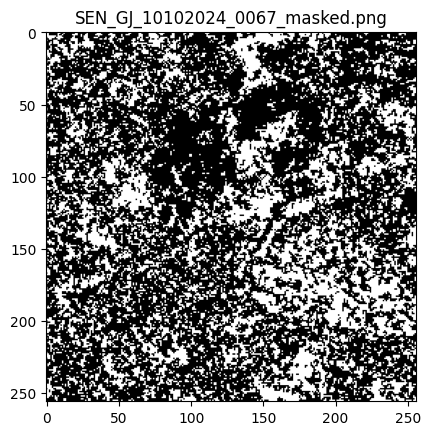

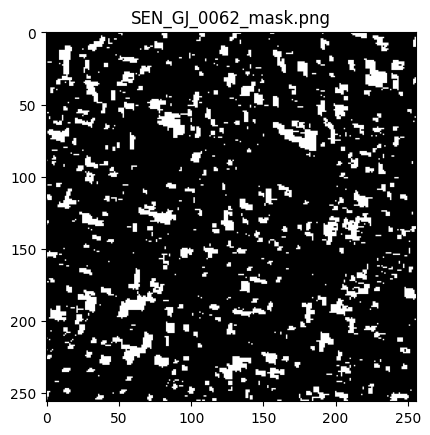

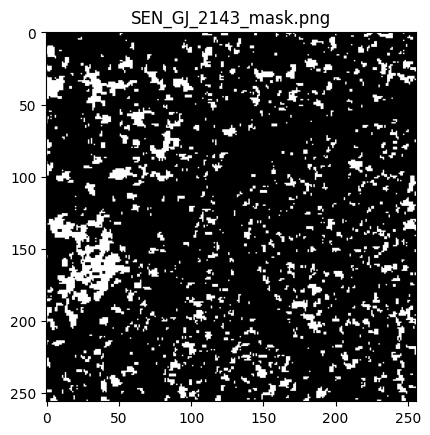

In [4]:
import numpy as np
from PIL import Image
import glob

mask_folder = "/kaggle/input/compvisdata/compvis/Data/masked"  # Adjust if needed
mask_files = glob.glob(mask_folder + "/*.png")

for mask_path in mask_files[:5]:  # Check first 5 masks
    mask_img = Image.open(mask_path).convert('L')
    mask_arr = np.array(mask_img)
    print(f"{os.path.basename(mask_path)}: min={mask_arr.min()}, max={mask_arr.max()}, unique={np.unique(mask_arr)}")
import matplotlib.pyplot as plt

for mask_path in mask_files[:3]:
    mask_img = Image.open(mask_path).convert('L')
    plt.imshow(mask_img, cmap='gray')
    plt.title(os.path.basename(mask_path))
    plt.show()


SEN_GJ_10102024_0067_masked.png: foreground pixels = 36.34%
SEN_GJ_0062_mask.png: foreground pixels = 13.15%
SEN_GJ_2143_mask.png: foreground pixels = 13.71%
SEN_GJ_1411_mask.png: foreground pixels = 11.08%
SEN_MG_01072020_27072020_0064_mask.png: foreground pixels = 41.33%
SEN_OD_16082022_0085_mask.png: foreground pixels = 41.06%
SEN_HR_06082019_18082019_0009_mask.png: foreground pixels = 33.10%
SEN_UP_10102022_0023_masked.png: foreground pixels = 21.55%
SEN_CG_17082020_1004_Mask.png: foreground pixels = 15.33%
SEN_GJ_0439_mask.png: foreground pixels = 26.20%


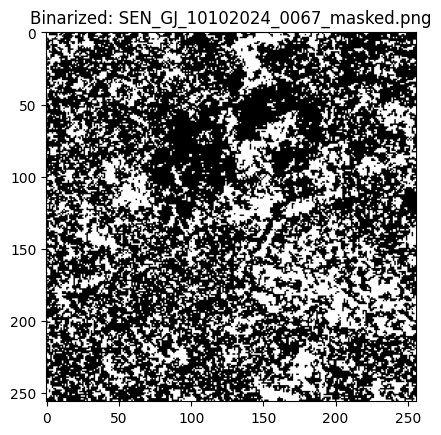

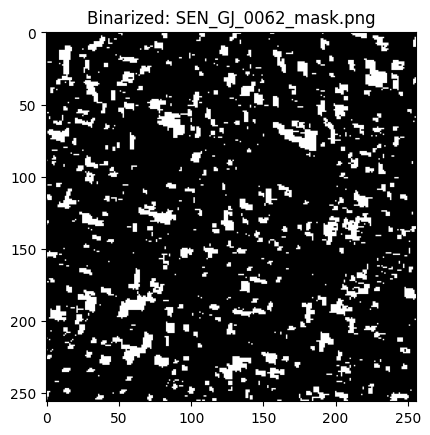

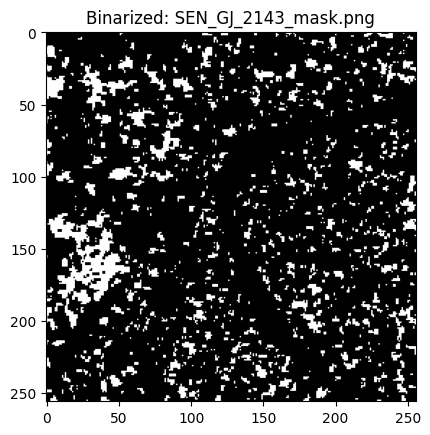

In [5]:
for mask_path in mask_files[:10]:
    mask_img = Image.open(mask_path).convert('L')
    mask_arr = np.array(mask_img)
    bin_mask = (mask_arr > 127).astype(np.uint8)
    percent_fg = 100 * bin_mask.sum() / bin_mask.size
    print(f"{os.path.basename(mask_path)}: foreground pixels = {percent_fg:.2f}%")

for mask_path in mask_files[:3]:
    mask_img = Image.open(mask_path).convert('L')
    mask_arr = np.array(mask_img)
    bin_mask = (mask_arr > 127).astype(np.uint8)
    plt.imshow(bin_mask, cmap='gray')
    plt.title(f"Binarized: {os.path.basename(mask_path)}")
    plt.show()



SEN_CG_17082020_1001_Mask.png: foreground pixels = 17.13%


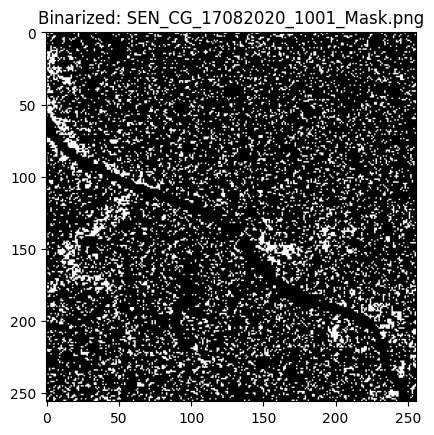

SEN_CG_17082020_1002_Mask.png: foreground pixels = 14.74%


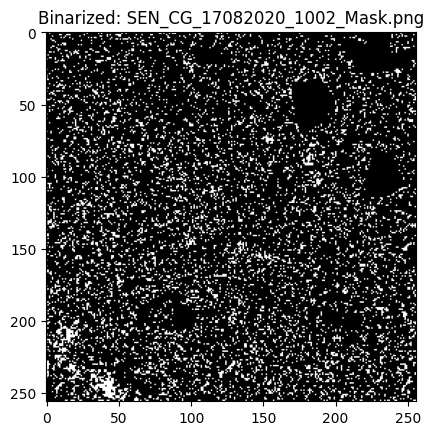

SEN_CG_17082020_1004_Mask.png: foreground pixels = 15.33%


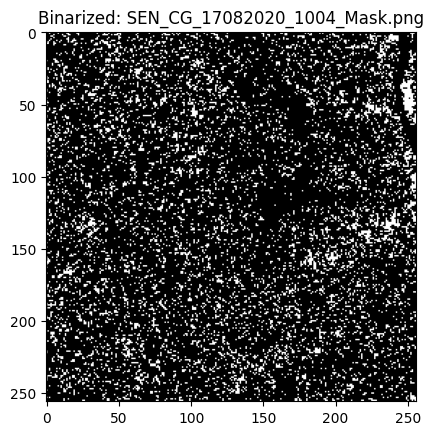

SEN_CG_17082020_1005_Mask.png: foreground pixels = 18.18%


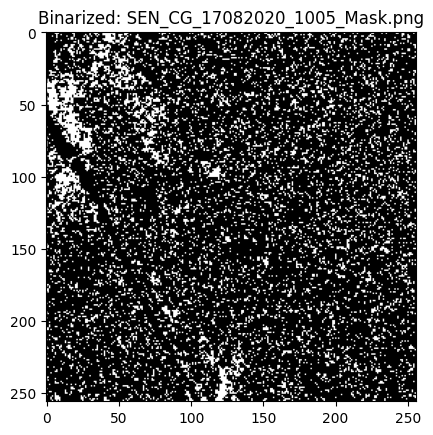

SEN_CG_17082020_1007_Mask.png: foreground pixels = 14.23%


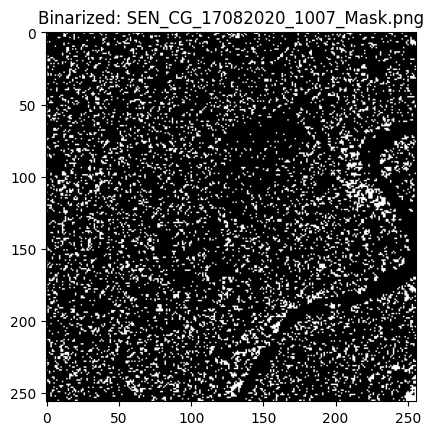

In [6]:
for before_path, after_path, mask_path in paired_data[:5]:
    mask_img = Image.open(mask_path).convert('L').resize((256, 256))
    mask_arr = np.array(mask_img).astype(np.uint8)
    bin_mask = (mask_arr > 127).astype(np.uint8)
    percent_fg = 100 * bin_mask.sum() / bin_mask.size
    print(f"{os.path.basename(mask_path)}: foreground pixels = {percent_fg:.2f}%")
    plt.imshow(bin_mask, cmap='gray')
    plt.title(f"Binarized: {os.path.basename(mask_path)}")
    plt.show()


Saved mask 0: foreground pixels = 17.13%


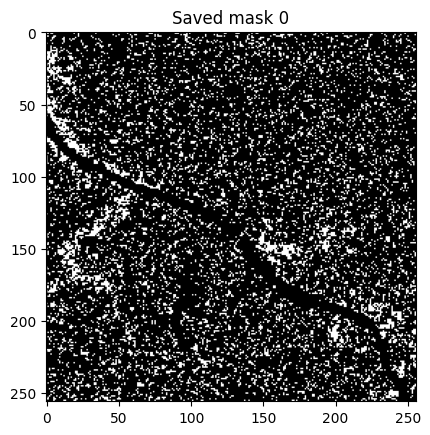

Saved mask 1: foreground pixels = 14.74%


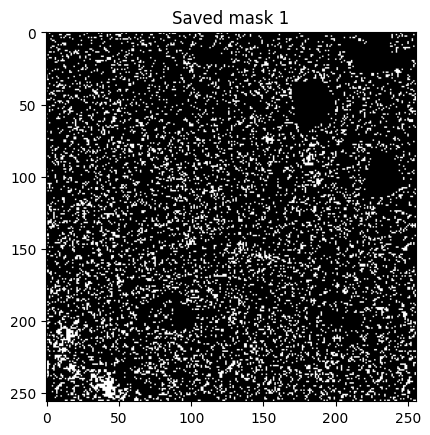

Saved mask 2: foreground pixels = 15.33%


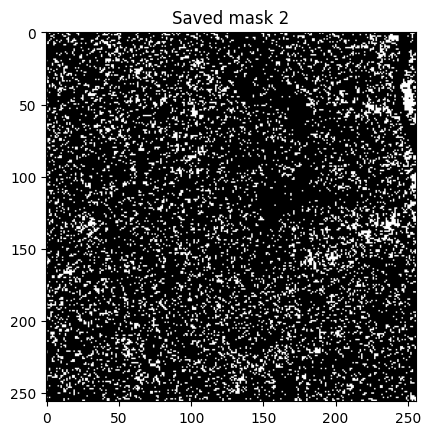

Saved mask 3: foreground pixels = 18.18%


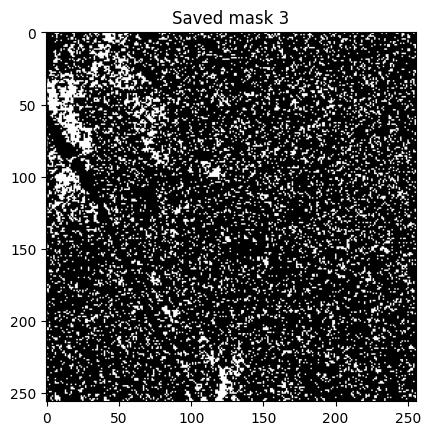

Saved mask 4: foreground pixels = 14.23%


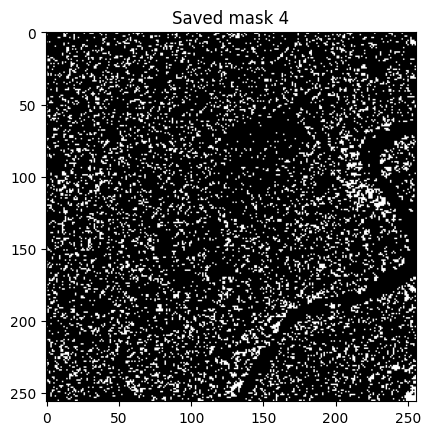

In [7]:
data = np.load("flood_data.npz")
mask_dataset = data['mask']
for i in range(5):
    mask = mask_dataset[i]
    percent_fg = 100 * (mask > 0).sum() / mask.size
    print(f"Saved mask {i}: foreground pixels = {percent_fg:.2f}%")
    plt.imshow(mask, cmap='gray')
    plt.title(f"Saved mask {i}")
    plt.show()


✅ Total Paired Samples: 2734
Saved .npz file to flood_data.npz
Total all-zero masks: 1 out of 2734
Sample 1042: Foreground pixels = 9.81%


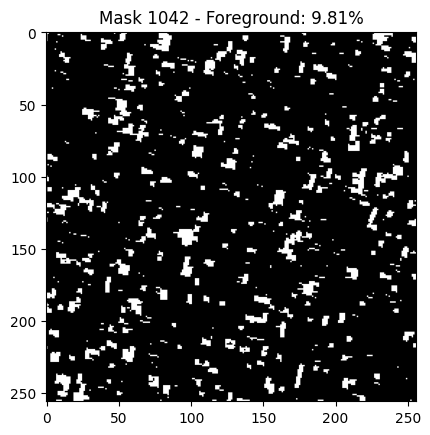

Sample 2581: Foreground pixels = 30.72%


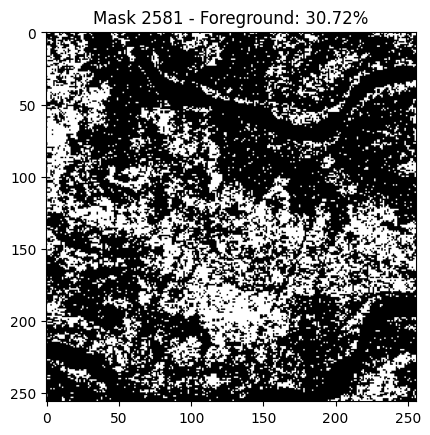

Sample 668: Foreground pixels = 23.41%


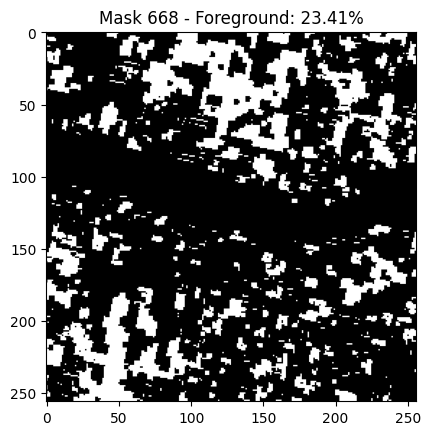

Sample 1382: Foreground pixels = 13.50%


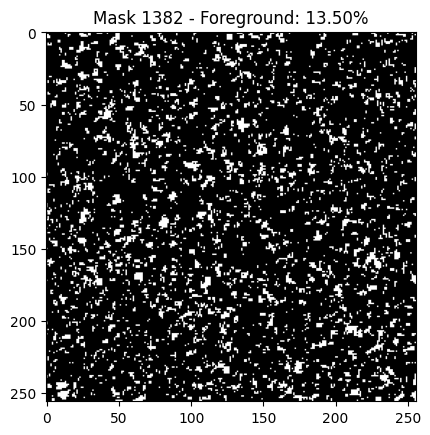

Sample 2064: Foreground pixels = 14.81%


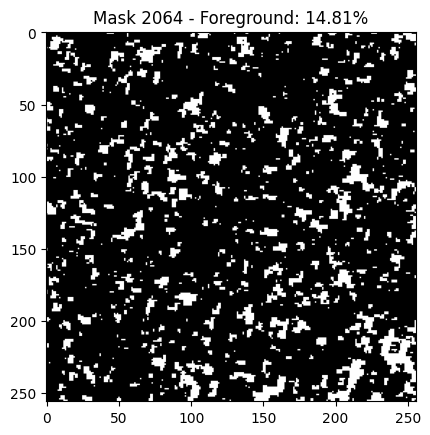

Total all-zero masks in visualization: 0 out of 5


In [10]:
import os
import re
import glob
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import random

def extract_key(filename):
    name = os.path.basename(filename).lower()
    if any(city in name for city in ['gorakhpur', 'chennai', 'brahmaputra']):
        if 'mask' in name:
            match = re.search(r'sen_\w+_mask_(\d+)', name)
            return f'divit_{match.group(1)}' if match else None
        else:
            match = re.search(r'sen_\w+_(\d{8})_(\d+)', name)
            return f'divit_{match.group(2)}' if match else None
    if re.match(r'sen_gj_\d{4}_', name):
        match = re.search(r'sen_(\w{2})_(\d{4})', name)
        if match:
            state, tile = match.groups()
            return f"{state}_{tile}"
    match_vijay2 = re.search(r'sen_(\w{2})_(\d{6})_(\d{4})', name)
    if match_vijay2:
        state, _, tile = match_vijay2.groups()
        return f"{state}_{tile}"
    match_vijay = re.search(r'sen_(\w{2})_(\d{4})_\d{4}', name)
    if match_vijay:
        state, tile = match_vijay.groups()
        return f"{state}_{tile}"
    match_general = re.search(r'sen_(\w{2})_\d{8}_(\d{4})', name)
    if match_general:
        state, tile = match_general.groups()
        return f"{state}_{tile}"
    return None

def load_dataset(base_dir, target_size=(256, 256)):
    before_folder = os.path.join(base_dir, 'before')
    after_folder = os.path.join(base_dir, 'after')
    mask_folder = os.path.join(base_dir, 'masked')
    before_images = sorted(glob.glob(os.path.join(before_folder, '*.png')))
    after_images = sorted(glob.glob(os.path.join(after_folder, '*.png')))
    mask_images = sorted(glob.glob(os.path.join(mask_folder, '*.png')))
    before_dict = {extract_key(f): f for f in before_images if extract_key(f)}
    after_dict = {extract_key(f): f for f in after_images if extract_key(f)}
    mask_dict = {extract_key(f): f for f in mask_images if extract_key(f)}
    paired_data = []
    for key in before_dict:
        if key in after_dict and key in mask_dict:
            paired_data.append((before_dict[key], after_dict[key], mask_dict[key]))
    print(f"✅ Total Paired Samples: {len(paired_data)}")
    return paired_data

def preprocess_and_save_npz(paired_data, output_path, target_size=(256, 256)):
    before_list, after_list, mask_list = [], [], []
    all_zero_count = 0
    for idx, (before_path, after_path, mask_path) in enumerate(paired_data):
        before_img = Image.open(before_path).convert('RGB').resize(target_size)
        after_img = Image.open(after_path).convert('RGB').resize(target_size)
        mask_img = Image.open(mask_path).convert('L').resize(target_size)
        before_arr = np.array(before_img).astype(np.float32)
        after_arr = np.array(after_img).astype(np.float32)
        mask_arr = np.array(mask_img).astype(np.uint8)
        bin_mask = (mask_arr > 127).astype(np.uint8)
        # Check for all-zero mask
        if np.all(bin_mask == 0):
            all_zero_count += 1
            print(f"Warning: All-zero mask for {mask_path}")
        before_list.append(before_arr)
        after_list.append(after_arr)
        mask_list.append(bin_mask)
    before_np = np.stack(before_list)
    after_np = np.stack(after_list)
    mask_np = np.stack(mask_list)
    np.savez_compressed(output_path, before=before_np, after=after_np, mask=mask_np)
    print(f"Saved .npz file to {output_path}")
    print(f"Total all-zero masks: {all_zero_count} out of {len(mask_list)}")

# --- Run this ONCE to create your .npz ---
base_dir = "/kaggle/input/compvisdata/compvis/Data"  # Adjust as needed
paired_data = load_dataset(base_dir)
preprocess_and_save_npz(paired_data, "flood_data.npz")

# --- Visualize random masks from the saved .npz file to ensure no all-zero masks ---
def visualize_masks(npz_path, num_samples=5):
    data = np.load(npz_path)
    masks = data['mask']
    total = len(masks)
    all_zero_count = 0
    for i in range(num_samples):
        idx = random.randint(0, total-1)
        mask = masks[idx]
        percent_fg = 100 * (mask > 0).sum() / mask.size
        if np.all(mask == 0):
            all_zero_count += 1
        print(f"Sample {idx}: Foreground pixels = {percent_fg:.2f}%")
        plt.imshow(mask, cmap='gray')
        plt.title(f"Mask {idx} - Foreground: {percent_fg:.2f}%")
        plt.show()
    print(f"Total all-zero masks in visualization: {all_zero_count} out of {num_samples}")

# --- Call this to check your saved masks ---
visualize_masks("flood_data.npz", num_samples=5)


/tmp/ipykernel_31/3380303740.py:144: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler()
/tmp/ipykernel_31/3380303740.py:165: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():


Starting training from scratch...
Epoch 1/20
Train Loss: 1.2202 | Train Dice: 0.1879
Val Loss: 1.1796 | Val Dice: 0.2190
--------------------------------------------------
Epoch 2/20
Train Loss: 1.1689 | Train Dice: 0.1997
Val Loss: 1.1713 | Val Dice: 0.2378
--------------------------------------------------
Epoch 3/20
Train Loss: 1.1556 | Train Dice: 0.2045
Val Loss: 1.1642 | Val Dice: 0.2201
--------------------------------------------------
Epoch 4/20
Train Loss: 1.1489 | Train Dice: 0.2131
Val Loss: 1.1652 | Val Dice: 0.1848
--------------------------------------------------
Epoch 5/20
Train Loss: 1.1452 | Train Dice: 0.2095
Val Loss: 1.1666 | Val Dice: 0.2336
--------------------------------------------------
Epoch 6/20
Train Loss: 1.1441 | Train Dice: 0.2071
Val Loss: 1.1617 | Val Dice: 0.1986
--------------------------------------------------
Epoch 7/20
Train Loss: 1.1409 | Train Dice: 0.2155
Val Loss: 1.1653 | Val Dice: 0.1633
--------------------------------------------------


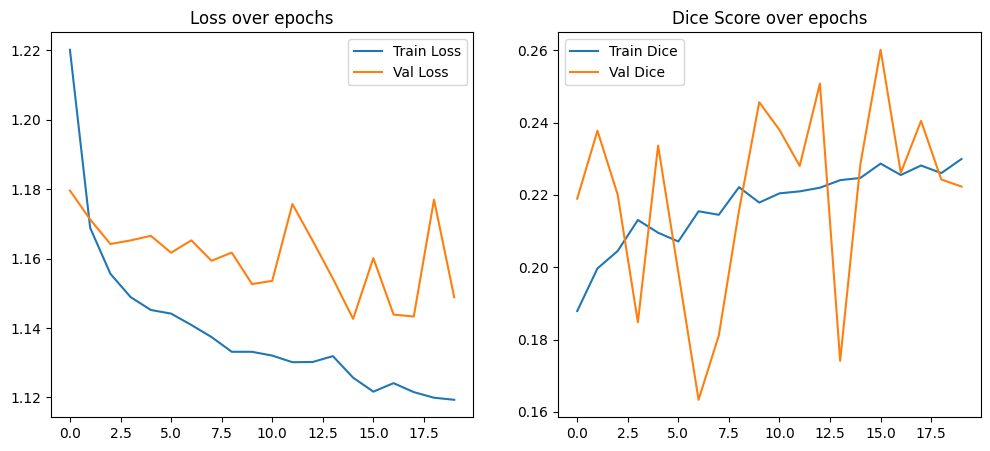


Final Test Results:
Test Loss: 1.1267 | Test Dice: 0.2155


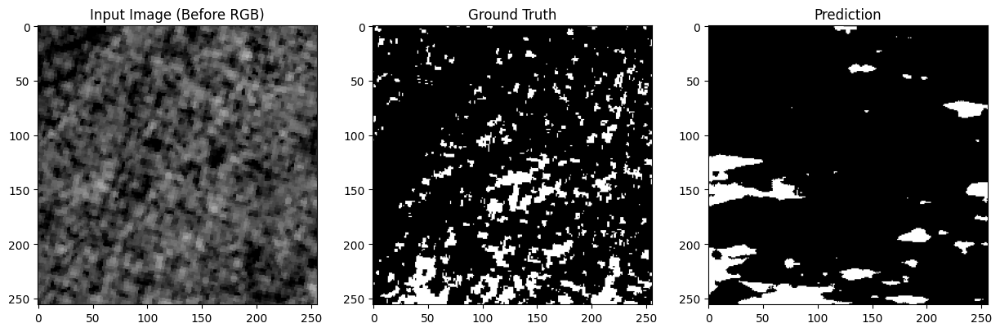

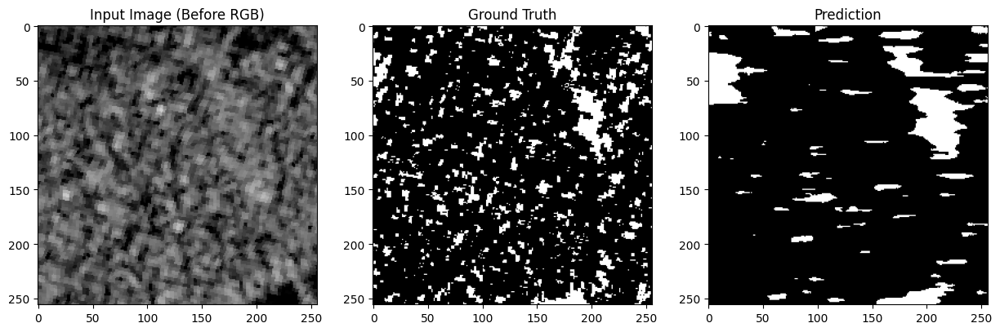

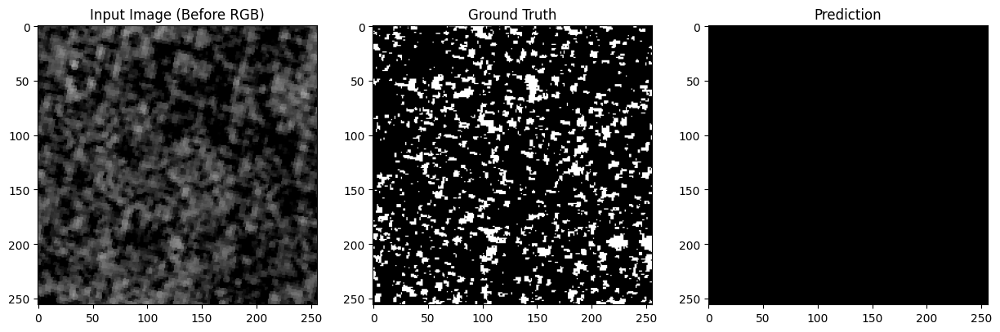

In [13]:
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, random_split
from torch.cuda.amp import GradScaler, autocast
import os
import random

# 1. Load .npz data
data = np.load("flood_data.npz")
before_dataset = data['before']  # (N, H, W, 3)
after_dataset = data['after']    # (N, H, W, 3)
mask_dataset = data['mask']      # (N, H, W) -- already binarized and resized!

IMG_SIZE = (256, 256)

def preprocess(img):
    img = np.squeeze(img)
    if img.dtype != np.uint8:
        img = (img * 255).clip(0,255).astype(np.uint8) if img.max() <= 1.0 else img.astype(np.uint8)
    if img.ndim == 2:
        img = np.stack([img]*3, axis=-1)
    from PIL import Image
    img = Image.fromarray(img)
    img = img.resize(IMG_SIZE)
    img = np.array(img).astype(np.float32) / 255.0
    img = np.transpose(img, (2, 0, 1))  # HWC -> CHW
    return img

# Only preprocess the before and after images, NOT the mask!
before_dataset = np.array([preprocess(img) for img in before_dataset])
after_dataset = np.array([preprocess(img) for img in after_dataset])
mask_dataset = mask_dataset.astype(np.float32)  # Use as-is!

combined_dataset = np.concatenate([before_dataset, after_dataset], axis=1)  # (N, 6, H, W)

class FloodDataset(Dataset):
    def __init__(self, X, y):
        self.X = X
        self.y = y
    def __len__(self):
        return len(self.X)
    def __getitem__(self, idx):
        return torch.tensor(self.X[idx], dtype=torch.float32), torch.tensor(self.y[idx], dtype=torch.float32).unsqueeze(0)

dataset = FloodDataset(combined_dataset, mask_dataset)
total = len(dataset)
train_size = int(0.7 * total)
val_size = int(0.15 * total)
test_size = total - train_size - val_size

generator = torch.Generator().manual_seed(42)
train_ds, val_ds, test_ds = random_split(dataset, [train_size, val_size, test_size], generator=generator)
train_loader = DataLoader(train_ds, batch_size=8, shuffle=True, pin_memory=True)
val_loader = DataLoader(val_ds, batch_size=8, pin_memory=True)
test_loader = DataLoader(test_ds, batch_size=8, pin_memory=True)

# 2. UNet++ Model (unchanged)
class UNetPlusPlus(nn.Module):
    def __init__(self, in_channels=6, out_channels=1, deep_supervision=True):
        super(UNetPlusPlus, self).__init__()
        self.deep_supervision = deep_supervision
        def conv_block(in_c, out_c):
            return nn.Sequential(
                nn.Conv2d(in_c, out_c, 3, padding=1),
                nn.BatchNorm2d(out_c),
                nn.ReLU(inplace=True),
                nn.Conv2d(out_c, out_c, 3, padding=1),
                nn.BatchNorm2d(out_c),
                nn.ReLU(inplace=True)
            )
        self.pool = nn.MaxPool2d(2, 2)
        self.conv0_0 = conv_block(in_channels, 64)
        self.conv1_0 = conv_block(64, 128)
        self.conv2_0 = conv_block(128, 256)
        self.conv3_0 = conv_block(256, 512)
        self.conv4_0 = conv_block(512, 1024)
        self.up1_0 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.up2_0 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.up3_0 = nn.ConvTranspose2d(512, 256, 2, stride=2)
        self.up4_0 = nn.ConvTranspose2d(1024, 512, 2, stride=2)
        self.conv0_1 = conv_block(64+64, 64)
        self.conv1_1 = conv_block(128+128, 128)
        self.conv2_1 = conv_block(256+256, 256)
        self.conv3_1 = conv_block(512+512, 512)
        self.up1_1 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.up2_1 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.up3_1 = nn.ConvTranspose2d(512, 256, 2, stride=2)
        self.conv0_2 = conv_block(64*3, 64)
        self.conv1_2 = conv_block(128*3, 128)
        self.conv2_2 = conv_block(256*3, 256)
        self.up1_2 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.up2_2 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.conv0_3 = conv_block(64*4, 64)
        self.conv1_3 = conv_block(128*4, 128)
        self.up1_3 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.conv0_4 = conv_block(64*5, 64)
        self.final = nn.Conv2d(64, out_channels, kernel_size=1)
    def forward(self, x):
        x0_0 = self.conv0_0(x)
        x1_0 = self.conv1_0(self.pool(x0_0))
        x0_1 = self.conv0_1(torch.cat([x0_0, self.up1_0(x1_0)], 1))
        x2_0 = self.conv2_0(self.pool(x1_0))
        x1_1 = self.conv1_1(torch.cat([x1_0, self.up2_0(x2_0)], 1))
        x0_2 = self.conv0_2(torch.cat([x0_0, x0_1, self.up1_1(x1_1)], 1))
        x3_0 = self.conv3_0(self.pool(x2_0))
        x2_1 = self.conv2_1(torch.cat([x2_0, self.up3_0(x3_0)], 1))
        x1_2 = self.conv1_2(torch.cat([x1_0, x1_1, self.up2_1(x2_1)], 1))
        x0_3 = self.conv0_3(torch.cat([x0_0, x0_1, x0_2, self.up1_2(x1_2)], 1))
        x4_0 = self.conv4_0(self.pool(x3_0))
        x3_1 = self.conv3_1(torch.cat([x3_0, self.up4_0(x4_0)], 1))
        x2_2 = self.conv2_2(torch.cat([x2_0, x2_1, self.up3_1(x3_1)], 1))
        x1_3 = self.conv1_3(torch.cat([x1_0, x1_1, x1_2, self.up2_2(x2_2)], 1))
        x0_4 = self.conv0_4(torch.cat([x0_0, x0_1, x0_2, x0_3, self.up1_3(x1_3)], 1))
        output = self.final(x0_4)
        return output

def dice_score(pred, target, smooth=1e-6):
    pred = torch.sigmoid(pred)
    pred = (pred > 0.5).float()
    target = target.float()
    intersection = (pred * target).sum(dim=(1,2,3))
    union = pred.sum(dim=(1,2,3)) + target.sum(dim=(1,2,3))
    dice = (2 * intersection + smooth) / (union + smooth)
    return dice.mean().item()

class DiceBCELoss(nn.Module):
    def __init__(self):
        super(DiceBCELoss, self).__init__()
        self.bce = nn.BCEWithLogitsLoss()
    def forward(self, pred, target, smooth=1e-6):
        bce_loss = self.bce(pred, target.float())
        pred = torch.sigmoid(pred)
        pred_flat = pred.view(-1)
        target_flat = target.view(-1)
        intersection = (pred_flat * target_flat).sum()
        dice_loss = 1 - (2. * intersection + smooth) / (pred_flat.sum() + target_flat.sum() + smooth)
        return bce_loss + dice_loss

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = UNetPlusPlus(in_channels=6, out_channels=1).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4, weight_decay=1e-5)
scaler = GradScaler()
loss_fn = DiceBCELoss()
model_path = "flood_segmentation_unetplusplus_train.pth"

def save_model(model, optimizer, path):
    torch.save({
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
    }, path)
    print(f"Model saved to {path}")

best_dice = 0.500
num_epochs = 20

def train_epoch(model, loader, optimizer, loss_fn, scaler):
    model.train()
    running_loss = 0.0
    running_dice = 0.0
    for images, masks in loader:
        images, masks = images.to(device), masks.to(device)
        optimizer.zero_grad()
        with autocast():
            preds = model(images)
            loss = loss_fn(preds, masks)
        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()
        running_loss += loss.item()
        running_dice += dice_score(preds, masks)
    return running_loss / len(loader), running_dice / len(loader)

def validate(model, loader, loss_fn):
    model.eval()
    running_loss = 0.0
    running_dice = 0.0
    with torch.no_grad():
        for images, masks in loader:
            images, masks = images.to(device), masks.to(device)
            preds = model(images)
            loss = loss_fn(preds, masks)
            running_loss += loss.item()
            running_dice += dice_score(preds, masks)
    return running_loss / len(loader), running_dice / len(loader)

print("Starting training from scratch...")
train_losses, val_losses = [], []
train_dices, val_dices = [], []
for epoch in range(num_epochs):
    train_loss, train_dice = train_epoch(model, train_loader, optimizer, loss_fn, scaler)
    val_loss, val_dice = validate(model, val_loader, loss_fn)
    train_losses.append(train_loss)
    train_dices.append(train_dice)
    val_losses.append(val_loss)
    val_dices.append(val_dice)
    print(f"Epoch {epoch+1}/{num_epochs}")
    print(f"Train Loss: {train_loss:.4f} | Train Dice: {train_dice:.4f}")
    print(f"Val Loss: {val_loss:.4f} | Val Dice: {val_dice:.4f}")
    if val_dice > best_dice:
        best_dice = val_dice
        save_model(model, optimizer, model_path)
        print(f"New best model saved with Dice: {best_dice:.4f}")
    print("-" * 50)
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(train_losses, label='Train Loss')
plt.plot(val_losses, label='Val Loss')
plt.legend()
plt.title('Loss over epochs')
plt.subplot(1, 2, 2)
plt.plot(train_dices, label='Train Dice')
plt.plot(val_dices, label='Val Dice')
plt.legend()
plt.title('Dice Score over epochs')
plt.show()

# 7. Test the model
test_loss, test_dice = validate(model, test_loader, loss_fn)
print(f"\nFinal Test Results:")
print(f"Test Loss: {test_loss:.4f} | Test Dice: {test_dice:.4f}")

def visualize_predictions(model, loader, num_samples=3):
    model.eval()
    with torch.no_grad():
        for i, (images, masks) in enumerate(loader):
            if i >= num_samples:
                break
            images, masks = images.to(device), masks.to(device)
            preds = torch.sigmoid(model(images))
            preds = (preds > 0.5).float()
            img_np = images[0, :3].cpu().numpy().transpose(1, 2, 0)
            mask_np = masks[0, 0].cpu().numpy()
            pred_np = preds[0, 0].cpu().numpy()
            plt.figure(figsize=(15, 5))
            plt.subplot(1, 3, 1)
            plt.imshow(img_np)
            plt.title('Input Image (Before RGB)')
            plt.subplot(1, 3, 2)
            plt.imshow(mask_np, cmap='gray')
            plt.title('Ground Truth')
            plt.subplot(1, 3, 3)
            plt.imshow(pred_np, cmap='gray')
            plt.title('Prediction')
            plt.show()

visualize_predictions(model, test_loader)


In [3]:
!pip install rasterio


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.2/22.2 MB 83.5 MB/s eta 0:00:00:00:0100:01


In [5]:
import os
import glob
import rasterio
from rasterio.transform import from_origin
from PIL import Image
import numpy as np

def png_to_geotiff(png_path, geotiff_path, crs='EPSG:4326', transform=None):
    img = Image.open(png_path)
    arr = np.array(img)
    # If grayscale, add channel dimension
    if arr.ndim == 2:
        arr = arr[np.newaxis, ...]
    elif arr.ndim == 3:
        arr = arr.transpose(2, 0, 1)  # CHW for rasterio
    else:
        raise ValueError("Unexpected image shape: {}".format(arr.shape))
    height, width = arr.shape[1], arr.shape[2]
    # Use identity transform if not provided
    if transform is None:
        transform = from_origin(0, 0, 1, 1)  # top-left x, top-left y, xres, yres
    with rasterio.open(
        geotiff_path,
        'w',
        driver='GTiff',
        height=height,
        width=width,
        count=arr.shape[0],
        dtype=arr.dtype,
        crs=crs,
        transform=transform
    ) as dst:
        dst.write(arr)

def batch_convert(folder, out_folder, crs='EPSG:4326', transform=None):
    os.makedirs(out_folder, exist_ok=True)
    for png_path in glob.glob(os.path.join(folder, '*.png')):
        base = os.path.splitext(os.path.basename(png_path))[0]
        out_path = os.path.join(out_folder, base + '.tif')
        png_to_geotiff(png_path, out_path, crs=crs, transform=transform)
        print(f"Converted {png_path} -> {out_path}")

# --- Set your folders ---
base_dir = "/kaggle/input/compvisdata/compvis/Data"  # input data
out_base = "/kaggle/working"  # output directory (writable!)

folders = ['before', 'after', 'masked']

for folder in folders:
    in_folder = os.path.join(base_dir, folder)
    out_folder = os.path.join(out_base, folder + '_geotiff')
    batch_convert(in_folder, out_folder)




/usr/local/lib/python3.11/dist-packages/rasterio/__init__.py:366: NotGeoreferencedWarning: The given matrix is equal to Affine.identity or its flipped counterpart. GDAL may ignore this matrix and save no geotransform without raising an error. This behavior is somewhat driver-specific.
  dataset = writer(


Converted /kaggle/input/compvisdata/compvis/Data/before/SEN_GJ_1422_before.png -> /kaggle/working/before_geotiff/SEN_GJ_1422_before.tif
Converted /kaggle/input/compvisdata/compvis/Data/before/SEN_MG_09062022_0057_before.png -> /kaggle/working/before_geotiff/SEN_MG_09062022_0057_before.tif
Converted /kaggle/input/compvisdata/compvis/Data/before/SEN_GJ_0348_before.png -> /kaggle/working/before_geotiff/SEN_GJ_0348_before.tif
Converted /kaggle/input/compvisdata/compvis/Data/before/SEN_GJ_2732_before.png -> /kaggle/working/before_geotiff/SEN_GJ_2732_before.tif
Converted /kaggle/input/compvisdata/compvis/Data/before/SEN_MG_01072020_0055_before.png -> /kaggle/working/before_geotiff/SEN_MG_01072020_0055_before.tif
Converted /kaggle/input/compvisdata/compvis/Data/before/SEN_GJ_0264_before.png -> /kaggle/working/before_geotiff/SEN_GJ_0264_before.tif
Converted /kaggle/input/compvisdata/compvis/Data/before/SEN_MN_20052017_0097_before.png -> /kaggle/working/before_geotiff/SEN_MN_20052017_0097_befor

In [2]:
!pip install rasterio


import os
import re
import glob
import numpy as np
import matplotlib.pyplot as plt
import random
import cv2
import rasterio

# --- SAR-Specific Preprocessing Functions ---

def lee_filter(img, size=7):
    """Apply Lee filter for speckle reduction on a 2D SAR image."""
    img_mean = cv2.blur(img, (size, size))
    img_sqr_mean = cv2.blur(img**2, (size, size))
    img_variance = img_sqr_mean - img_mean**2
    overall_variance = np.var(img)
    img_weights = img_variance / (img_variance + overall_variance + 1e-8)
    img_filtered = img_mean + img_weights * (img - img_mean)
    return img_filtered

def apply_layover_shadow_mask(img, mask_path):
    """Mask layover/shadow regions (set to 0) using a mask GeoTIFF."""
    with rasterio.open(mask_path) as src:
        mask = src.read(1)
    img[mask == 1] = 0  # or np.nan if you prefer
    return img

# --- Your Pairing Logic ---

def extract_key(filename):
    name = os.path.basename(filename).lower()
    if any(city in name for city in ['gorakhpur', 'chennai', 'brahmaputra']):
        if 'mask' in name:
            match = re.search(r'sen_\w+_mask_(\d+)', name)
            return f'divit_{match.group(1)}' if match else None
        else:
            match = re.search(r'sen_\w+_(\d{8})_(\d+)', name)
            return f'divit_{match.group(2)}' if match else None
    if re.match(r'sen_gj_\d{4}_', name):
        match = re.search(r'sen_(\w{2})_(\d{4})', name)
        if match:
            state, tile = match.groups()
            return f"{state}_{tile}"
    match_vijay2 = re.search(r'sen_(\w{2})_(\d{6})_(\d{4})', name)
    if match_vijay2:
        state, _, tile = match_vijay2.groups()
        return f"{state}_{tile}"
    match_vijay = re.search(r'sen_(\w{2})_(\d{4})_\d{4}', name)
    if match_vijay:
        state, tile = match_vijay.groups()
        return f"{state}_{tile}"
    match_general = re.search(r'sen_(\w{2})_\d{8}_(\d{4})', name)
    if match_general:
        state, tile = match_general.groups()
        return f"{state}_{tile}"
    return None

def load_dataset(base_dir, target_size=(256, 256)):
    before_folder = os.path.join(base_dir, 'before_geotiff')
    after_folder = os.path.join(base_dir, 'after_geotiff')
    mask_folder = os.path.join(base_dir, 'masked_geotiff')
    before_images = sorted(glob.glob(os.path.join(before_folder, '*.tif')))
    after_images = sorted(glob.glob(os.path.join(after_folder, '*.tif')))
    mask_images = sorted(glob.glob(os.path.join(mask_folder, '*.tif')))
    before_dict = {extract_key(f): f for f in before_images if extract_key(f)}
    after_dict = {extract_key(f): f for f in after_images if extract_key(f)}
    mask_dict = {extract_key(f): f for f in mask_images if extract_key(f)}
    paired_data = []
    for key in before_dict:
        if key in after_dict and key in mask_dict:
            paired_data.append((before_dict[key], after_dict[key], mask_dict[key]))
    print(f"✅ Total Paired Samples: {len(paired_data)}")
    return paired_data

def preprocess_sar_image_tiff(img_path, target_size=(256, 256), apply_lee=True, layover_mask_path=None):
    with rasterio.open(img_path) as src:
        img = src.read(1).astype(np.float32)  # Read first band
    # Normalize to [0,1]
    img = (img - img.min()) / (img.max() - img.min() + 1e-8)
    # Apply Lee filter for speckle reduction
    if apply_lee:
        img = lee_filter(img)
        img = (img - img.min()) / (img.max() - img.min() + 1e-8)
    # Optionally mask layover/shadow
    if layover_mask_path is not None:
        img = apply_layover_shadow_mask(img, layover_mask_path)
    # Resize to target size
    img = cv2.resize(img, target_size, interpolation=cv2.INTER_LINEAR)
    # Convert to 3-channel for compatibility
    img = np.stack([img]*3, axis=-1)
    return img

def preprocess_and_save_npz(
    paired_data, output_path, target_size=(256, 256),
    apply_lee=True, layover_mask_path=None
):
    before_list, after_list, mask_list = [], [], []
    all_zero_count = 0
    for idx, (before_path, after_path, mask_path) in enumerate(paired_data):
        before_img = preprocess_sar_image_tiff(before_path, target_size, apply_lee, layover_mask_path)
        after_img = preprocess_sar_image_tiff(after_path, target_size, apply_lee, layover_mask_path)
        # For mask, read as grayscale, resize, binarize
        with rasterio.open(mask_path) as src:
            mask_arr = src.read(1)
        mask_arr = cv2.resize(mask_arr, target_size, interpolation=cv2.INTER_NEAREST)
        bin_mask = (mask_arr > 127).astype(np.uint8)
        if np.all(bin_mask == 0):
            all_zero_count += 1
            print(f"Warning: All-zero mask for {mask_path}")
        before_list.append(before_img)
        after_list.append(after_img)
        mask_list.append(bin_mask)
    before_np = np.stack(before_list)
    after_np = np.stack(after_list)
    mask_np = np.stack(mask_list)
    np.savez_compressed(output_path, before=before_np, after=after_np, mask=mask_np)
    print(f"Saved .npz file to {output_path}")
    print(f"Total all-zero masks: {all_zero_count} out of {len(mask_list)}")

# --- Run this ONCE to create your .npz ---
base_dir = "/kaggle/working"  # This is where your *_geotiff folders are!
paired_data = load_dataset(base_dir)
preprocess_and_save_npz(
    paired_data,
    "flood_data.npz",
    target_size=(256, 256),
    apply_lee=True,              # Apply Lee filter for speckle reduction
    layover_mask_path=None       # Set path to layover/shadow mask GeoTIFF if available
)

# --- Visualize random masks from the saved .npz file to ensure no all-zero masks ---
def visualize_masks(npz_path, num_samples=5):
    data = np.load(npz_path)
    masks = data['mask']
    total = len(masks)
    all_zero_count = 0
    for i in range(num_samples):
        idx = random.randint(0, total-1)
        mask = masks[idx]
        percent_fg = 100 * (mask > 0).sum() / mask.size
        if np.all(mask == 0):
            all_zero_count += 1
        print(f"Sample {idx}: Foreground pixels = {percent_fg:.2f}%")
        plt.imshow(mask, cmap='gray')
        plt.title(f"Mask {idx} - Foreground: {percent_fg:.2f}%")
        plt.show()
    print(f"Total all-zero masks in visualization: {all_zero_count} out of {num_samples}")

# --- Call this to check your saved masks ---
visualize_masks("flood_data.npz", num_samples=5)


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.2/22.2 MB 80.5 MB/s eta 0:00:00:00:0100:01
✅ Total Paired Samples: 0


ValueError: need at least one array to stack

/tmp/ipykernel_31/429235708.py:136: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler()
/tmp/ipykernel_31/429235708.py:157: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():


Starting training from scratch...
Epoch 1/20
Train Loss: 1.2762 | Train Dice: 0.1883
Val Loss: 1.2185 | Val Dice: 0.1345
--------------------------------------------------
Epoch 2/20
Train Loss: 1.1955 | Train Dice: 0.1926
Val Loss: 1.1945 | Val Dice: 0.2275
--------------------------------------------------
Epoch 3/20
Train Loss: 1.1712 | Train Dice: 0.2002
Val Loss: 1.1845 | Val Dice: 0.1485
--------------------------------------------------
Epoch 4/20
Train Loss: 1.1651 | Train Dice: 0.2002
Val Loss: 1.1737 | Val Dice: 0.2123
--------------------------------------------------
Epoch 5/20
Train Loss: 1.1536 | Train Dice: 0.2024
Val Loss: 1.1756 | Val Dice: 0.2054
--------------------------------------------------
Epoch 6/20
Train Loss: 1.1545 | Train Dice: 0.2007
Val Loss: 1.1794 | Val Dice: 0.2007
--------------------------------------------------
Epoch 7/20
Train Loss: 1.1494 | Train Dice: 0.2039
Val Loss: 1.1982 | Val Dice: 0.2208
--------------------------------------------------


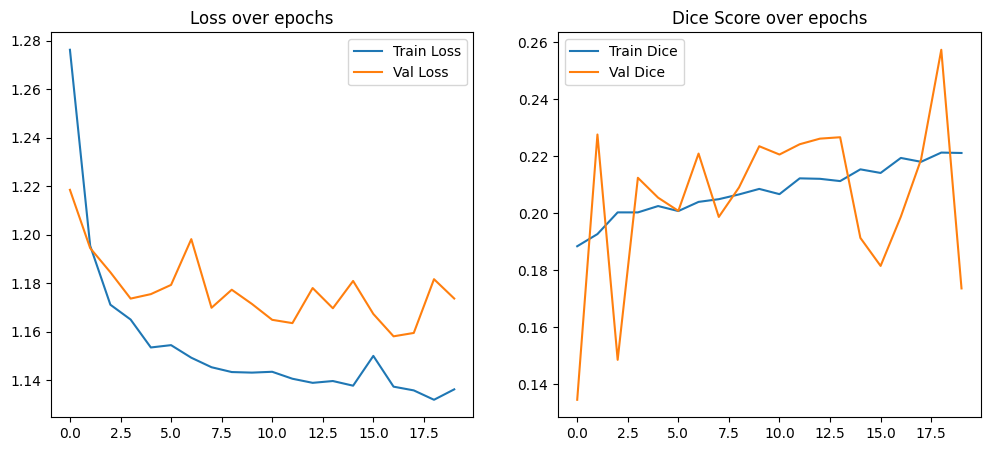


Final Test Results:
Test Loss: 1.1632 | Test Dice: 0.1621


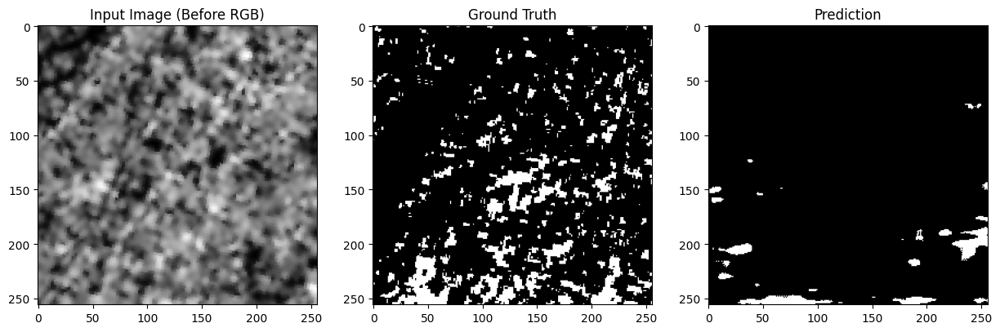

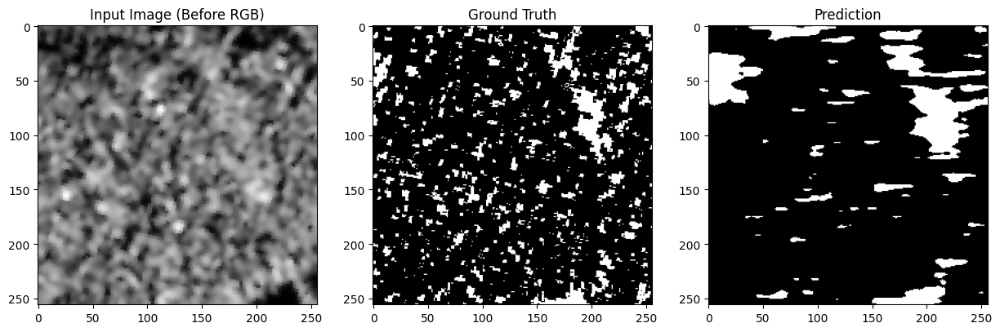

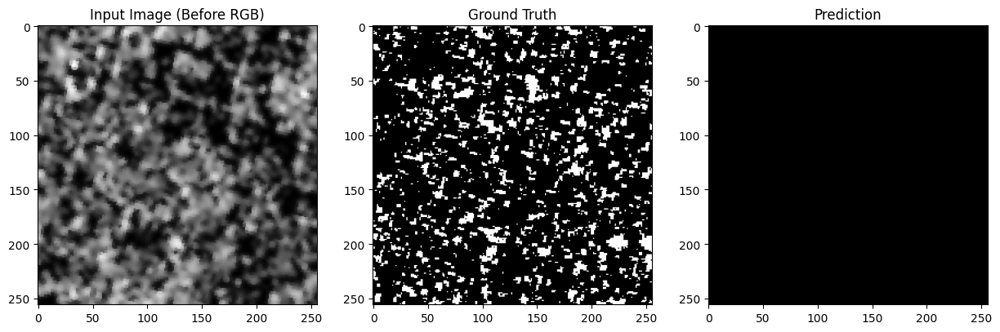

In [7]:
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, random_split
from torch.cuda.amp import GradScaler, autocast
import os
import random

# 1. Load .npz data (from your SAR preprocessing pipeline)
data = np.load("flood_data.npz")
before_dataset = data['before']  # (N, H, W, 3) already normalized, resized, 3-channel
after_dataset = data['after']    # (N, H, W, 3)
mask_dataset = data['mask']      # (N, H, W), already binarized and resized

# --- Only convert to channel-first and float32, no further preprocessing needed ---
def to_tensor_channel_first(img):
    # img: (H, W, 3) or (H, W) numpy array, already normalized
    if img.ndim == 3:
        img = np.transpose(img, (2, 0, 1))  # HWC -> CHW
    return img.astype(np.float32)

before_dataset = np.array([to_tensor_channel_first(img) for img in before_dataset])
after_dataset = np.array([to_tensor_channel_first(img) for img in after_dataset])
mask_dataset = np.array([img.astype(np.float32) for img in mask_dataset])  # shape (N, H, W)

# --- Combine before/after into 6-channel input ---
combined_dataset = np.concatenate([before_dataset, after_dataset], axis=1)  # (N, 6, H, W)

class FloodDataset(Dataset):
    def __init__(self, X, y):
        self.X = X
        self.y = y
    def __len__(self):
        return len(self.X)
    def __getitem__(self, idx):
        return torch.tensor(self.X[idx], dtype=torch.float32), torch.tensor(self.y[idx], dtype=torch.float32).unsqueeze(0)

dataset = FloodDataset(combined_dataset, mask_dataset)
total = len(dataset)
train_size = int(0.7 * total)
val_size = int(0.15 * total)
test_size = total - train_size - val_size

generator = torch.Generator().manual_seed(42)
train_ds, val_ds, test_ds = random_split(dataset, [train_size, val_size, test_size], generator=generator)
train_loader = DataLoader(train_ds, batch_size=8, shuffle=True, pin_memory=True)
val_loader = DataLoader(val_ds, batch_size=8, pin_memory=True)
test_loader = DataLoader(test_ds, batch_size=8, pin_memory=True)

# 2. UNet++ Model (unchanged)
class UNetPlusPlus(nn.Module):
    def __init__(self, in_channels=6, out_channels=1, deep_supervision=True):
        super(UNetPlusPlus, self).__init__()
        self.deep_supervision = deep_supervision
        def conv_block(in_c, out_c):
            return nn.Sequential(
                nn.Conv2d(in_c, out_c, 3, padding=1),
                nn.BatchNorm2d(out_c),
                nn.ReLU(inplace=True),
                nn.Conv2d(out_c, out_c, 3, padding=1),
                nn.BatchNorm2d(out_c),
                nn.ReLU(inplace=True)
            )
        self.pool = nn.MaxPool2d(2, 2)
        self.conv0_0 = conv_block(in_channels, 64)
        self.conv1_0 = conv_block(64, 128)
        self.conv2_0 = conv_block(128, 256)
        self.conv3_0 = conv_block(256, 512)
        self.conv4_0 = conv_block(512, 1024)
        self.up1_0 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.up2_0 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.up3_0 = nn.ConvTranspose2d(512, 256, 2, stride=2)
        self.up4_0 = nn.ConvTranspose2d(1024, 512, 2, stride=2)
        self.conv0_1 = conv_block(64+64, 64)
        self.conv1_1 = conv_block(128+128, 128)
        self.conv2_1 = conv_block(256+256, 256)
        self.conv3_1 = conv_block(512+512, 512)
        self.up1_1 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.up2_1 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.up3_1 = nn.ConvTranspose2d(512, 256, 2, stride=2)
        self.conv0_2 = conv_block(64*3, 64)
        self.conv1_2 = conv_block(128*3, 128)
        self.conv2_2 = conv_block(256*3, 256)
        self.up1_2 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.up2_2 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.conv0_3 = conv_block(64*4, 64)
        self.conv1_3 = conv_block(128*4, 128)
        self.up1_3 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.conv0_4 = conv_block(64*5, 64)
        self.final = nn.Conv2d(64, out_channels, kernel_size=1)
    def forward(self, x):
        x0_0 = self.conv0_0(x)
        x1_0 = self.conv1_0(self.pool(x0_0))
        x0_1 = self.conv0_1(torch.cat([x0_0, self.up1_0(x1_0)], 1))
        x2_0 = self.conv2_0(self.pool(x1_0))
        x1_1 = self.conv1_1(torch.cat([x1_0, self.up2_0(x2_0)], 1))
        x0_2 = self.conv0_2(torch.cat([x0_0, x0_1, self.up1_1(x1_1)], 1))
        x3_0 = self.conv3_0(self.pool(x2_0))
        x2_1 = self.conv2_1(torch.cat([x2_0, self.up3_0(x3_0)], 1))
        x1_2 = self.conv1_2(torch.cat([x1_0, x1_1, self.up2_1(x2_1)], 1))
        x0_3 = self.conv0_3(torch.cat([x0_0, x0_1, x0_2, self.up1_2(x1_2)], 1))
        x4_0 = self.conv4_0(self.pool(x3_0))
        x3_1 = self.conv3_1(torch.cat([x3_0, self.up4_0(x4_0)], 1))
        x2_2 = self.conv2_2(torch.cat([x2_0, x2_1, self.up3_1(x3_1)], 1))
        x1_3 = self.conv1_3(torch.cat([x1_0, x1_1, x1_2, self.up2_2(x2_2)], 1))
        x0_4 = self.conv0_4(torch.cat([x0_0, x0_1, x0_2, x0_3, self.up1_3(x1_3)], 1))
        output = self.final(x0_4)
        return output

def dice_score(pred, target, smooth=1e-6):
    pred = torch.sigmoid(pred)
    pred = (pred > 0.5).float()
    target = target.float()
    intersection = (pred * target).sum(dim=(1,2,3))
    union = pred.sum(dim=(1,2,3)) + target.sum(dim=(1,2,3))
    dice = (2 * intersection + smooth) / (union + smooth)
    return dice.mean().item()

class DiceBCELoss(nn.Module):
    def __init__(self):
        super(DiceBCELoss, self).__init__()
        self.bce = nn.BCEWithLogitsLoss()
    def forward(self, pred, target, smooth=1e-6):
        bce_loss = self.bce(pred, target.float())
        pred = torch.sigmoid(pred)
        pred_flat = pred.view(-1)
        target_flat = target.view(-1)
        intersection = (pred_flat * target_flat).sum()
        dice_loss = 1 - (2. * intersection + smooth) / (pred_flat.sum() + target_flat.sum() + smooth)
        return bce_loss + dice_loss

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = UNetPlusPlus(in_channels=6, out_channels=1).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4, weight_decay=1e-5)
scaler = GradScaler()
loss_fn = DiceBCELoss()
model_path = "flood_segmentation_unetplusplus_train.pth"

def save_model(model, optimizer, path):
    torch.save({
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
    }, path)
    print(f"Model saved to {path}")

best_dice = 0.500
num_epochs = 20

def train_epoch(model, loader, optimizer, loss_fn, scaler):
    model.train()
    running_loss = 0.0
    running_dice = 0.0
    for images, masks in loader:
        images, masks = images.to(device), masks.to(device)
        optimizer.zero_grad()
        with autocast():
            preds = model(images)
            loss = loss_fn(preds, masks)
        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()
        running_loss += loss.item()
        running_dice += dice_score(preds, masks)
    return running_loss / len(loader), running_dice / len(loader)

def validate(model, loader, loss_fn):
    model.eval()
    running_loss = 0.0
    running_dice = 0.0
    with torch.no_grad():
        for images, masks in loader:
            images, masks = images.to(device), masks.to(device)
            preds = model(images)
            loss = loss_fn(preds, masks)
            running_loss += loss.item()
            running_dice += dice_score(preds, masks)
    return running_loss / len(loader), running_dice / len(loader)

print("Starting training from scratch...")
train_losses, val_losses = [], []
train_dices, val_dices = [], []
for epoch in range(num_epochs):
    train_loss, train_dice = train_epoch(model, train_loader, optimizer, loss_fn, scaler)
    val_loss, val_dice = validate(model, val_loader, loss_fn)
    train_losses.append(train_loss)
    train_dices.append(train_dice)
    val_losses.append(val_loss)
    val_dices.append(val_dice)
    print(f"Epoch {epoch+1}/{num_epochs}")
    print(f"Train Loss: {train_loss:.4f} | Train Dice: {train_dice:.4f}")
    print(f"Val Loss: {val_loss:.4f} | Val Dice: {val_dice:.4f}")
    if val_dice > best_dice:
        best_dice = val_dice
        save_model(model, optimizer, model_path)
        print(f"New best model saved with Dice: {best_dice:.4f}")
    print("-" * 50)
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(train_losses, label='Train Loss')
plt.plot(val_losses, label='Val Loss')
plt.legend()
plt.title('Loss over epochs')
plt.subplot(1, 2, 2)
plt.plot(train_dices, label='Train Dice')
plt.plot(val_dices, label='Val Dice')
plt.legend()
plt.title('Dice Score over epochs')
plt.show()

# 7. Test the model
test_loss, test_dice = validate(model, test_loader, loss_fn)
print(f"\nFinal Test Results:")
print(f"Test Loss: {test_loss:.4f} | Test Dice: {test_dice:.4f}")

def visualize_predictions(model, loader, num_samples=3):
    model.eval()
    with torch.no_grad():
        for i, (images, masks) in enumerate(loader):
            if i >= num_samples:
                break
            images, masks = images.to(device), masks.to(device)
            preds = torch.sigmoid(model(images))
            preds = (preds > 0.5).float()
            img_np = images[0, :3].cpu().numpy().transpose(1, 2, 0)
            mask_np = masks[0, 0].cpu().numpy()
            pred_np = preds[0, 0].cpu().numpy()
            plt.figure(figsize=(15, 5))
            plt.subplot(1, 3, 1)
            plt.imshow(img_np)
            plt.title('Input Image (Before RGB)')
            plt.subplot(1, 3, 2)
            plt.imshow(mask_np, cmap='gray')
            plt.title('Ground Truth')
            plt.subplot(1, 3, 3)
            plt.imshow(pred_np, cmap='gray')
            plt.title('Prediction')
            plt.show()

visualize_predictions(model, test_loader)


In [8]:
for images, masks in test_loader:
    print("Images shape:", images.shape, "min/max:", images.min().item(), images.max().item())
    print("Masks shape:", masks.shape, "min/max:", masks.min().item(), masks.max().item(), "unique:", torch.unique(masks))
    break


Images shape: torch.Size([8, 6, 256, 256]) min/max: 0.0 1.0
Masks shape: torch.Size([8, 1, 256, 256]) min/max: 0.0 1.0 unique: tensor([0., 1.])


In [9]:
fg_pixels = []
for i in range(len(test_ds)):
    _, mask = test_ds[i]
    fg = (mask > 0).sum().item() / mask.numel()
    fg_pixels.append(fg)
print("Avg % foreground in test masks:", np.mean(fg_pixels)*100)
print("Min/Max % foreground in test masks:", np.min(fg_pixels)*100, np.max(fg_pixels)*100)


Avg % foreground in test masks: 16.371626285450883
Min/Max % foreground in test masks: 0.52032470703125 42.1173095703125


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, random_split
from torch.cuda.amp import GradScaler, autocast
import torchvision.transforms as T
import os
import random

# 1. Load .npz data (from your SAR preprocessing pipeline)
data = np.load("flood_data.npz")
before_dataset = data['before']  # (N, H, W, 3)
after_dataset = data['after']    # (N, H, W, 3)
mask_dataset = data['mask']      # (N, H, W)

def to_tensor_channel_first(img):
    if img.ndim == 3:
        img = np.transpose(img, (2, 0, 1))  # HWC -> CHW
    return img.astype(np.float32)

before_dataset = np.array([to_tensor_channel_first(img) for img in before_dataset])
after_dataset = np.array([to_tensor_channel_first(img) for img in after_dataset])
mask_dataset = np.array([img.astype(np.float32) for img in mask_dataset])

combined_dataset = np.concatenate([before_dataset, after_dataset], axis=1)  # (N, 6, H, W)

# --- Data Augmentation ---
class FloodDataset(Dataset):
    def __init__(self, X, y, augment=False):
        self.X = X
        self.y = y
        self.augment = augment
        self.transform = T.Compose([
            T.RandomHorizontalFlip(),
            T.RandomVerticalFlip(),
            T.RandomRotation(30)
        ]) if augment else None

    def __len__(self):
        return len(self.X)
    def __getitem__(self, idx):
        img = self.X[idx]
        mask = self.y[idx]
        if self.augment and random.random() < 0.8:
            # Apply the same augmentation to image and mask
            stacked = np.concatenate([img, mask[np.newaxis, ...]], axis=0)
            stacked = torch.tensor(stacked)
            stacked = self.transform(stacked)
            img = stacked[:-1].numpy()
            mask = stacked[-1].numpy()
        return torch.tensor(img, dtype=torch.float32), torch.tensor(mask, dtype=torch.float32).unsqueeze(0)

dataset = FloodDataset(combined_dataset, mask_dataset, augment=True)
total = len(dataset)
train_size = int(0.7 * total)
val_size = int(0.15 * total)
test_size = total - train_size - val_size

generator = torch.Generator().manual_seed(42)
train_ds, val_ds, test_ds = random_split(dataset, [train_size, val_size, test_size], generator=generator)
train_loader = DataLoader(train_ds, batch_size=8, shuffle=True, pin_memory=True)
val_loader = DataLoader(val_ds, batch_size=8, pin_memory=True)
test_loader = DataLoader(test_ds, batch_size=8, pin_memory=True)

# --- Tversky Loss for Class Imbalance ---
class TverskyLoss(nn.Module):
    def __init__(self, alpha=0.7, beta=0.3, smooth=1e-6):
        super().__init__()
        self.alpha = alpha
        self.beta = beta
        self.smooth = smooth
    def forward(self, pred, target):
        pred = torch.sigmoid(pred)
        tp = (pred * target).sum()
        fp = ((1 - target) * pred).sum()
        fn = (target * (1 - pred)).sum()
        tversky = (tp + self.smooth) / (tp + self.alpha * fp + self.beta * fn + self.smooth)
        return 1 - tversky

def dice_score(pred, target, smooth=1e-6):
    pred = torch.sigmoid(pred)
    pred = (pred > 0.5).float()
    target = target.float()
    intersection = (pred * target).sum(dim=(1,2,3))
    union = pred.sum(dim=(1,2,3)) + target.sum(dim=(1,2,3))
    dice = (2 * intersection + smooth) / (union + smooth)
    return dice.mean().item()

# --- UNet++ Model (unchanged) ---
class UNetPlusPlus(nn.Module):
    def __init__(self, in_channels=6, out_channels=1, deep_supervision=True):
        super(UNetPlusPlus, self).__init__()
        self.deep_supervision = deep_supervision
        def conv_block(in_c, out_c):
            return nn.Sequential(
                nn.Conv2d(in_c, out_c, 3, padding=1),
                nn.BatchNorm2d(out_c),
                nn.ReLU(inplace=True),
                nn.Conv2d(out_c, out_c, 3, padding=1),
                nn.BatchNorm2d(out_c),
                nn.ReLU(inplace=True)
            )
        self.pool = nn.MaxPool2d(2, 2)
        self.conv0_0 = conv_block(in_channels, 64)
        self.conv1_0 = conv_block(64, 128)
        self.conv2_0 = conv_block(128, 256)
        self.conv3_0 = conv_block(256, 512)
        self.conv4_0 = conv_block(512, 1024)
        self.up1_0 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.up2_0 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.up3_0 = nn.ConvTranspose2d(512, 256, 2, stride=2)
        self.up4_0 = nn.ConvTranspose2d(1024, 512, 2, stride=2)
        self.conv0_1 = conv_block(64+64, 64)
        self.conv1_1 = conv_block(128+128, 128)
        self.conv2_1 = conv_block(256+256, 256)
        self.conv3_1 = conv_block(512+512, 512)
        self.up1_1 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.up2_1 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.up3_1 = nn.ConvTranspose2d(512, 256, 2, stride=2)
        self.conv0_2 = conv_block(64*3, 64)
        self.conv1_2 = conv_block(128*3, 128)
        self.conv2_2 = conv_block(256*3, 256)
        self.up1_2 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.up2_2 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.conv0_3 = conv_block(64*4, 64)
        self.conv1_3 = conv_block(128*4, 128)
        self.up1_3 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.conv0_4 = conv_block(64*5, 64)
        self.final = nn.Conv2d(64, out_channels, kernel_size=1)
    def forward(self, x):
        x0_0 = self.conv0_0(x)
        x1_0 = self.conv1_0(self.pool(x0_0))
        x0_1 = self.conv0_1(torch.cat([x0_0, self.up1_0(x1_0)], 1))
        x2_0 = self.conv2_0(self.pool(x1_0))
        x1_1 = self.conv1_1(torch.cat([x1_0, self.up2_0(x2_0)], 1))
        x0_2 = self.conv0_2(torch.cat([x0_0, x0_1, self.up1_1(x1_1)], 1))
        x3_0 = self.conv3_0(self.pool(x2_0))
        x2_1 = self.conv2_1(torch.cat([x2_0, self.up3_0(x3_0)], 1))
        x1_2 = self.conv1_2(torch.cat([x1_0, x1_1, self.up2_1(x2_1)], 1))
        x0_3 = self.conv0_3(torch.cat([x0_0, x0_1, x0_2, self.up1_2(x1_2)], 1))
        x4_0 = self.conv4_0(self.pool(x3_0))
        x3_1 = self.conv3_1(torch.cat([x3_0, self.up4_0(x4_0)], 1))
        x2_2 = self.conv2_2(torch.cat([x2_0, x2_1, self.up3_1(x3_1)], 1))
        x1_3 = self.conv1_3(torch.cat([x1_0, x1_1, x1_2, self.up2_2(x2_2)], 1))
        x0_4 = self.conv0_4(torch.cat([x0_0, x0_1, x0_2, x0_3, self.up1_3(x1_3)], 1))
        output = self.final(x0_4)
        return output

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = UNetPlusPlus(in_channels=6, out_channels=1).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-5, weight_decay=1e-5)
scaler = GradScaler()
loss_fn = TverskyLoss(alpha=0.7, beta=0.3)
model_path = "flood_segmentation_unetplusplus_train.pth"

def save_model(model, optimizer, path):
    torch.save({
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
    }, path)
    print(f"Model saved to {path}")

best_dice = 0.500
num_epochs = 40

def train_epoch(model, loader, optimizer, loss_fn, scaler):
    model.train()
    running_loss = 0.0
    running_dice = 0.0
    for images, masks in loader:
        images, masks = images.to(device), masks.to(device)
        optimizer.zero_grad()
        with autocast():
            preds = model(images)
            loss = loss_fn(preds, masks)
        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()
        running_loss += loss.item()
        running_dice += dice_score(preds, masks)
    return running_loss / len(loader), running_dice / len(loader)

def validate(model, loader, loss_fn):
    model.eval()
    running_loss = 0.0
    running_dice = 0.0
    with torch.no_grad():
        for images, masks in loader:
            images, masks = images.to(device), masks.to(device)
            preds = model(images)
            loss = loss_fn(preds, masks)
            running_loss += loss.item()
            running_dice += dice_score(preds, masks)
    return running_loss / len(loader), running_dice / len(loader)

print("Starting training from scratch...")
train_losses, val_losses = [], []
train_dices, val_dices = [], []
for epoch in range(num_epochs):
    train_loss, train_dice = train_epoch(model, train_loader, optimizer, loss_fn, scaler)
    val_loss, val_dice = validate(model, val_loader, loss_fn)
    train_losses.append(train_loss)
    train_dices.append(train_dice)
    val_losses.append(val_loss)
    val_dices.append(val_dice)
    print(f"Epoch {epoch+1}/{num_epochs}")
    print(f"Train Loss: {train_loss:.4f} | Train Dice: {train_dice:.4f}")
    print(f"Val Loss: {val_loss:.4f} | Val Dice: {val_dice:.4f}")
    if val_dice > best_dice:
        best_dice = val_dice
        save_model(model, optimizer, model_path)
        print(f"New best model saved with Dice: {best_dice:.4f}")
    print("-" * 50)
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(train_losses, label='Train Loss')
plt.plot(val_losses, label='Val Loss')
plt.legend()
plt.title('Loss over epochs')
plt.subplot(1, 2, 2)
plt.plot(train_dices, label='Train Dice')
plt.plot(val_dices, label='Val Dice')
plt.legend()
plt.title('Dice Score over epochs')
plt.show()

# 7. Test the model
test_loss, test_dice = validate(model, test_loader, loss_fn)
print(f"\nFinal Test Results:")
print(f"Test Loss: {test_loss:.4f} | Test Dice: {test_dice:.4f}")

def visualize_predictions(model, loader, num_samples=10):
    model.eval()
    with torch.no_grad():
        for i, (images, masks) in enumerate(loader):
            if i >= num_samples:
                break
            images, masks = images.to(device), masks.to(device)
            preds = torch.sigmoid(model(images))
            preds_bin = (preds > 0.5).float()
            img_np = images[0, :3].cpu().numpy().transpose(1, 2, 0)
            mask_np = masks[0, 0].cpu().numpy()
            pred_np = preds_bin[0, 0].cpu().numpy()
            fg_pct = 100 * pred_np.sum() / pred_np.size
            print(f"Predicted mask {i}: {fg_pct:.2f}% foreground")
            plt.figure(figsize=(15, 5))
            plt.subplot(1, 3, 1)
            plt.imshow(img_np)
            plt.title('Input Image (Before RGB)')
            plt.subplot(1, 3, 2)
            plt.imshow(mask_np, cmap='gray')
            plt.title('Ground Truth')
            plt.subplot(1, 3, 3)
            plt.imshow(pred_np, cmap='gray')
            plt.title('Prediction')
            plt.show()

visualize_predictions(model, test_loader, num_samples=10)


In [3]:
import os
import glob
import rasterio
from rasterio.transform import from_origin
from PIL import Image
import numpy as np

def png_to_geotiff(png_path, geotiff_path, crs='EPSG:4326', transform=None):
    img = Image.open(png_path)
    arr = np.array(img)
    # If grayscale, add channel dimension
    if arr.ndim == 2:
        arr = arr[np.newaxis, ...]
    elif arr.ndim == 3:
        arr = arr.transpose(2, 0, 1)  # CHW for rasterio
    else:
        raise ValueError("Unexpected image shape: {}".format(arr.shape))
    height, width = arr.shape[1], arr.shape[2]
    # Use identity transform if not provided
    if transform is None:
        transform = from_origin(0, 0, 1, 1)  # top-left x, top-left y, xres, yres
    with rasterio.open(
        geotiff_path,
        'w',
        driver='GTiff',
        height=height,
        width=width,
        count=arr.shape[0],
        dtype=arr.dtype,
        crs=crs,
        transform=transform
    ) as dst:
        dst.write(arr)

def batch_convert(folder, out_folder, crs='EPSG:4326', transform=None):
    os.makedirs(out_folder, exist_ok=True)
    for png_path in glob.glob(os.path.join(folder, '*.png')):
        base = os.path.splitext(os.path.basename(png_path))[0]
        out_path = os.path.join(out_folder, base + '.tif')
        png_to_geotiff(png_path, out_path, crs=crs, transform=transform)
        print(f"Converted {png_path} -> {out_path}")

# --- Set your folders ---
base_dir = "/kaggle/input/compvisdata/compvis/Data"  # input data
out_base = "/kaggle/working"  # output directory (writable!)

folders = ['before', 'after', 'masked']

for folder in folders:
    in_folder = os.path.join(base_dir, folder)
    out_folder = os.path.join(out_base, folder + '_geotiff')
    batch_convert(in_folder, out_folder)




/usr/local/lib/python3.11/dist-packages/rasterio/__init__.py:366: NotGeoreferencedWarning: The given matrix is equal to Affine.identity or its flipped counterpart. GDAL may ignore this matrix and save no geotransform without raising an error. This behavior is somewhat driver-specific.
  dataset = writer(


Converted /kaggle/input/compvisdata/compvis/Data/before/SEN_GJ_1422_before.png -> /kaggle/working/before_geotiff/SEN_GJ_1422_before.tif
Converted /kaggle/input/compvisdata/compvis/Data/before/SEN_MG_09062022_0057_before.png -> /kaggle/working/before_geotiff/SEN_MG_09062022_0057_before.tif
Converted /kaggle/input/compvisdata/compvis/Data/before/SEN_GJ_0348_before.png -> /kaggle/working/before_geotiff/SEN_GJ_0348_before.tif
Converted /kaggle/input/compvisdata/compvis/Data/before/SEN_GJ_2732_before.png -> /kaggle/working/before_geotiff/SEN_GJ_2732_before.tif
Converted /kaggle/input/compvisdata/compvis/Data/before/SEN_MG_01072020_0055_before.png -> /kaggle/working/before_geotiff/SEN_MG_01072020_0055_before.tif
Converted /kaggle/input/compvisdata/compvis/Data/before/SEN_GJ_0264_before.png -> /kaggle/working/before_geotiff/SEN_GJ_0264_before.tif
Converted /kaggle/input/compvisdata/compvis/Data/before/SEN_MN_20052017_0097_before.png -> /kaggle/working/before_geotiff/SEN_MN_20052017_0097_befor

✅ Total Paired Samples: 2734
Saved .npz file to flood_data.npz
Total all-zero masks: 1 out of 2734
Sample 844: Foreground pixels = 11.77%


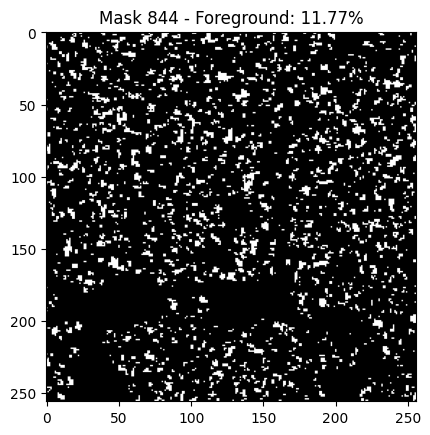

Sample 2467: Foreground pixels = 33.65%


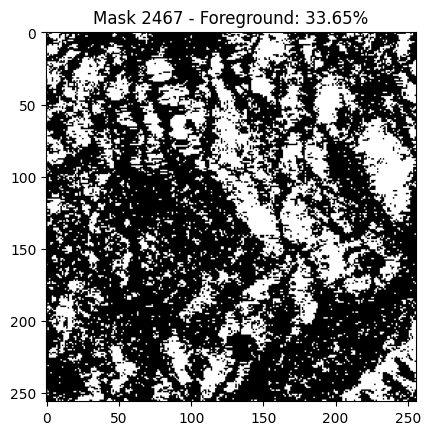

Sample 1930: Foreground pixels = 12.95%


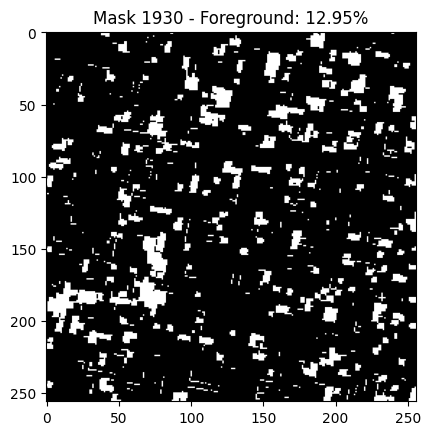

Sample 2354: Foreground pixels = 14.76%


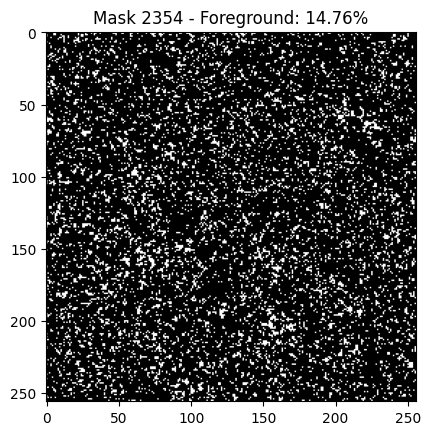

Sample 2021: Foreground pixels = 14.22%


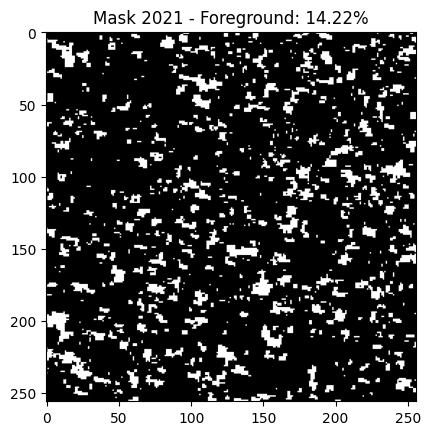

Total all-zero masks in visualization: 0 out of 5


In [4]:
!pip install rasterio


import os
import re
import glob
import numpy as np
import matplotlib.pyplot as plt
import random
import cv2
import rasterio

# --- SAR-Specific Preprocessing Functions ---

def lee_filter(img, size=7):
    """Apply Lee filter for speckle reduction on a 2D SAR image."""
    img_mean = cv2.blur(img, (size, size))
    img_sqr_mean = cv2.blur(img**2, (size, size))
    img_variance = img_sqr_mean - img_mean**2
    overall_variance = np.var(img)
    img_weights = img_variance / (img_variance + overall_variance + 1e-8)
    img_filtered = img_mean + img_weights * (img - img_mean)
    return img_filtered

def apply_layover_shadow_mask(img, mask_path):
    """Mask layover/shadow regions (set to 0) using a mask GeoTIFF."""
    with rasterio.open(mask_path) as src:
        mask = src.read(1)
    img[mask == 1] = 0  # or np.nan if you prefer
    return img

# --- Your Pairing Logic ---

def extract_key(filename):
    name = os.path.basename(filename).lower()
    if any(city in name for city in ['gorakhpur', 'chennai', 'brahmaputra']):
        if 'mask' in name:
            match = re.search(r'sen_\w+_mask_(\d+)', name)
            return f'divit_{match.group(1)}' if match else None
        else:
            match = re.search(r'sen_\w+_(\d{8})_(\d+)', name)
            return f'divit_{match.group(2)}' if match else None
    if re.match(r'sen_gj_\d{4}_', name):
        match = re.search(r'sen_(\w{2})_(\d{4})', name)
        if match:
            state, tile = match.groups()
            return f"{state}_{tile}"
    match_vijay2 = re.search(r'sen_(\w{2})_(\d{6})_(\d{4})', name)
    if match_vijay2:
        state, _, tile = match_vijay2.groups()
        return f"{state}_{tile}"
    match_vijay = re.search(r'sen_(\w{2})_(\d{4})_\d{4}', name)
    if match_vijay:
        state, tile = match_vijay.groups()
        return f"{state}_{tile}"
    match_general = re.search(r'sen_(\w{2})_\d{8}_(\d{4})', name)
    if match_general:
        state, tile = match_general.groups()
        return f"{state}_{tile}"
    return None

def load_dataset(base_dir, target_size=(256, 256)):
    before_folder = os.path.join(base_dir, 'before_geotiff')
    after_folder = os.path.join(base_dir, 'after_geotiff')
    mask_folder = os.path.join(base_dir, 'masked_geotiff')
    before_images = sorted(glob.glob(os.path.join(before_folder, '*.tif')))
    after_images = sorted(glob.glob(os.path.join(after_folder, '*.tif')))
    mask_images = sorted(glob.glob(os.path.join(mask_folder, '*.tif')))
    before_dict = {extract_key(f): f for f in before_images if extract_key(f)}
    after_dict = {extract_key(f): f for f in after_images if extract_key(f)}
    mask_dict = {extract_key(f): f for f in mask_images if extract_key(f)}
    paired_data = []
    for key in before_dict:
        if key in after_dict and key in mask_dict:
            paired_data.append((before_dict[key], after_dict[key], mask_dict[key]))
    print(f"✅ Total Paired Samples: {len(paired_data)}")
    return paired_data

def preprocess_sar_image_tiff(img_path, target_size=(256, 256), apply_lee=True, layover_mask_path=None):
    with rasterio.open(img_path) as src:
        img = src.read(1).astype(np.float32)  # Read first band
    # Normalize to [0,1]
    img = (img - img.min()) / (img.max() - img.min() + 1e-8)
    # Apply Lee filter for speckle reduction
    if apply_lee:
        img = lee_filter(img)
        img = (img - img.min()) / (img.max() - img.min() + 1e-8)
    # Optionally mask layover/shadow
    if layover_mask_path is not None:
        img = apply_layover_shadow_mask(img, layover_mask_path)
    # Resize to target size
    img = cv2.resize(img, target_size, interpolation=cv2.INTER_LINEAR)
    # Convert to 3-channel for compatibility
    img = np.stack([img]*3, axis=-1)
    return img

def preprocess_and_save_npz(
    paired_data, output_path, target_size=(256, 256),
    apply_lee=True, layover_mask_path=None
):
    before_list, after_list, mask_list = [], [], []
    all_zero_count = 0
    for idx, (before_path, after_path, mask_path) in enumerate(paired_data):
        before_img = preprocess_sar_image_tiff(before_path, target_size, apply_lee, layover_mask_path)
        after_img = preprocess_sar_image_tiff(after_path, target_size, apply_lee, layover_mask_path)
        # For mask, read as grayscale, resize, binarize
        with rasterio.open(mask_path) as src:
            mask_arr = src.read(1)
        mask_arr = cv2.resize(mask_arr, target_size, interpolation=cv2.INTER_NEAREST)
        bin_mask = (mask_arr > 127).astype(np.uint8)
        if np.all(bin_mask == 0):
            all_zero_count += 1
            print(f"Warning: All-zero mask for {mask_path}")
        before_list.append(before_img)
        after_list.append(after_img)
        mask_list.append(bin_mask)
    before_np = np.stack(before_list)
    after_np = np.stack(after_list)
    mask_np = np.stack(mask_list)
    np.savez_compressed(output_path, before=before_np, after=after_np, mask=mask_np)
    print(f"Saved .npz file to {output_path}")
    print(f"Total all-zero masks: {all_zero_count} out of {len(mask_list)}")

# --- Run this ONCE to create your .npz ---
base_dir = "/kaggle/working"  # This is where your *_geotiff folders are!
paired_data = load_dataset(base_dir)
preprocess_and_save_npz(
    paired_data,
    "flood_data.npz",
    target_size=(256, 256),
    apply_lee=True,              # Apply Lee filter for speckle reduction
    layover_mask_path=None       # Set path to layover/shadow mask GeoTIFF if available
)

# --- Visualize random masks from the saved .npz file to ensure no all-zero masks ---
def visualize_masks(npz_path, num_samples=5):
    data = np.load(npz_path)
    masks = data['mask']
    total = len(masks)
    all_zero_count = 0
    for i in range(num_samples):
        idx = random.randint(0, total-1)
        mask = masks[idx]
        percent_fg = 100 * (mask > 0).sum() / mask.size
        if np.all(mask == 0):
            all_zero_count += 1
        print(f"Sample {idx}: Foreground pixels = {percent_fg:.2f}%")
        plt.imshow(mask, cmap='gray')
        plt.title(f"Mask {idx} - Foreground: {percent_fg:.2f}%")
        plt.show()
    print(f"Total all-zero masks in visualization: {all_zero_count} out of {num_samples}")

# --- Call this to check your saved masks ---
visualize_masks("flood_data.npz", num_samples=5)


/tmp/ipykernel_31/608371932.py:153: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler()


Starting training from scratch...


/tmp/ipykernel_31/608371932.py:174: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():


Epoch 1/40
Train Loss: 0.7621 | Train Dice: 0.2787
Val Loss: 0.7381 | Val Dice: 0.2840
--------------------------------------------------
Epoch 2/40
Train Loss: 0.7418 | Train Dice: 0.2789
Val Loss: 0.7320 | Val Dice: 0.2963
--------------------------------------------------
Epoch 3/40
Train Loss: 0.7369 | Train Dice: 0.2857
Val Loss: 0.7296 | Val Dice: 0.2929
--------------------------------------------------
Epoch 4/40
Train Loss: 0.7328 | Train Dice: 0.2833
Val Loss: 0.7247 | Val Dice: 0.2740
--------------------------------------------------
Epoch 5/40
Train Loss: 0.7288 | Train Dice: 0.2817
Val Loss: 0.7279 | Val Dice: 0.2914
--------------------------------------------------
Epoch 6/40
Train Loss: 0.7273 | Train Dice: 0.2776
Val Loss: 0.7217 | Val Dice: 0.2716
--------------------------------------------------
Epoch 7/40
Train Loss: 0.7274 | Train Dice: 0.2740
Val Loss: 0.7206 | Val Dice: 0.2722
--------------------------------------------------
Epoch 8/40
Train Loss: 0.7247 | Tr

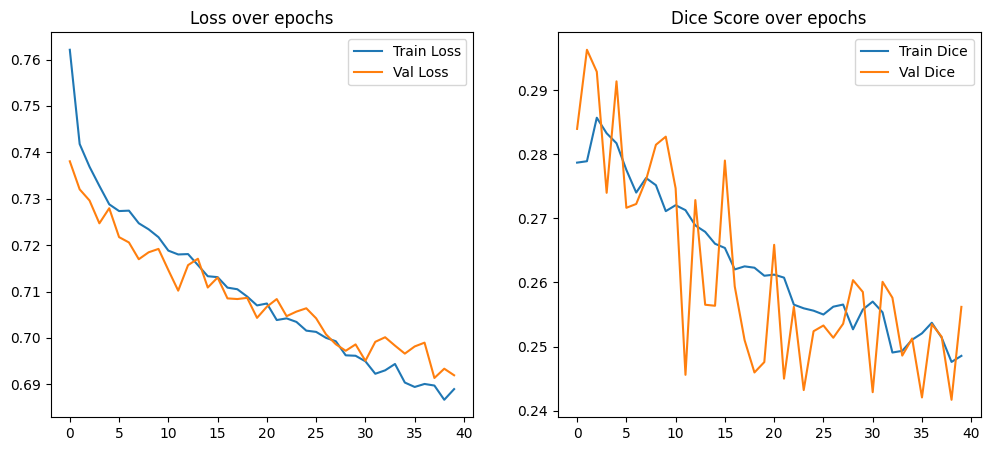


Final Test Results:
Test Loss: 0.6980 | Test Dice: 0.2406
Predicted mask 0: 24.72% foreground


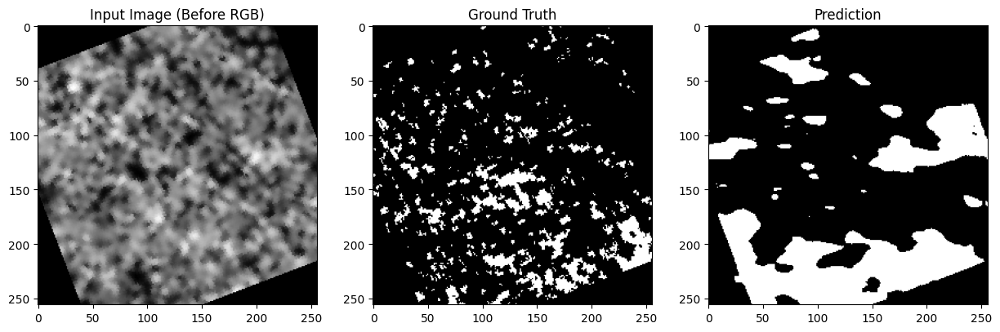

Predicted mask 1: 27.39% foreground


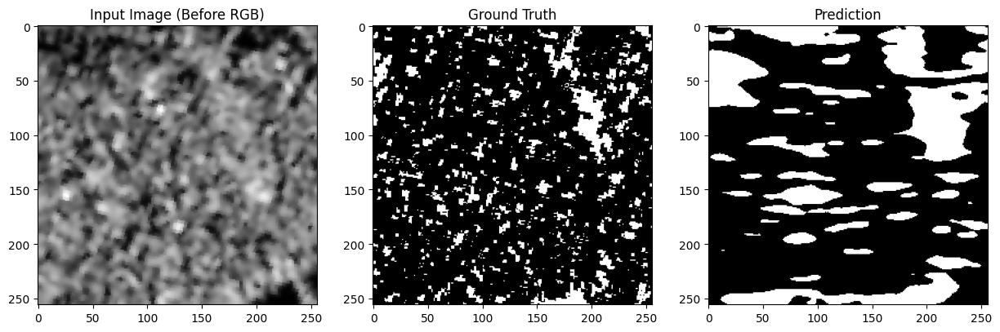

Predicted mask 2: 0.00% foreground


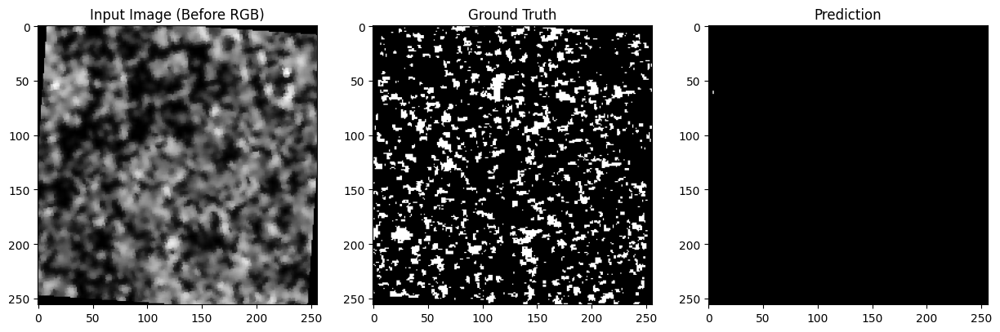

Predicted mask 3: 12.87% foreground


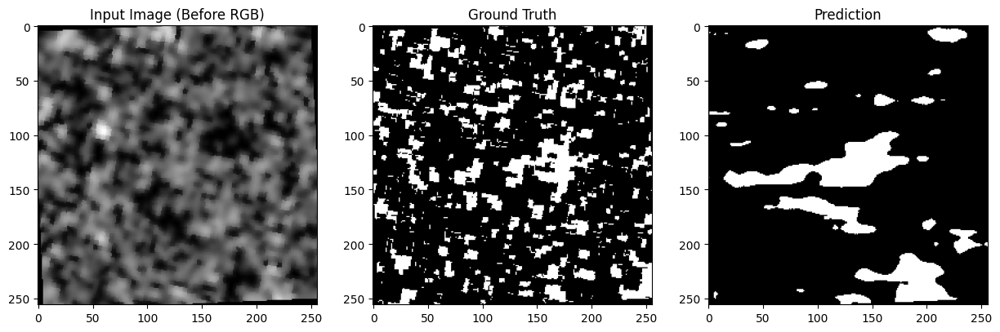

Predicted mask 4: 0.00% foreground


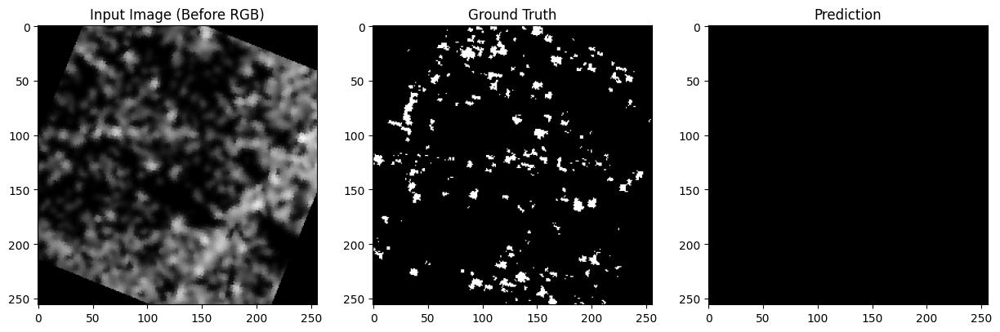

Predicted mask 5: 11.99% foreground


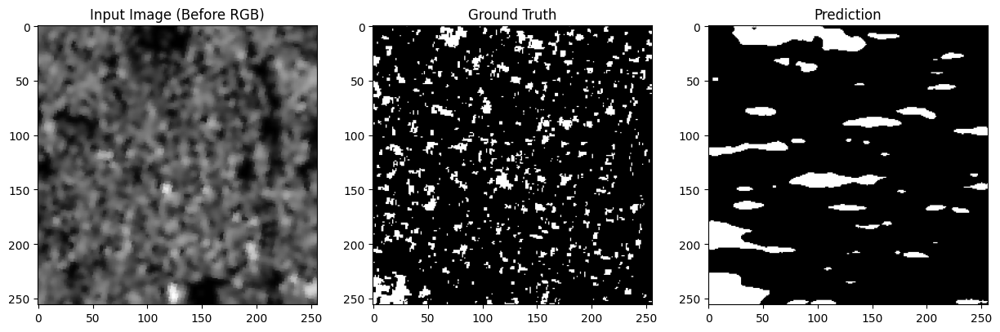

Predicted mask 6: 18.58% foreground


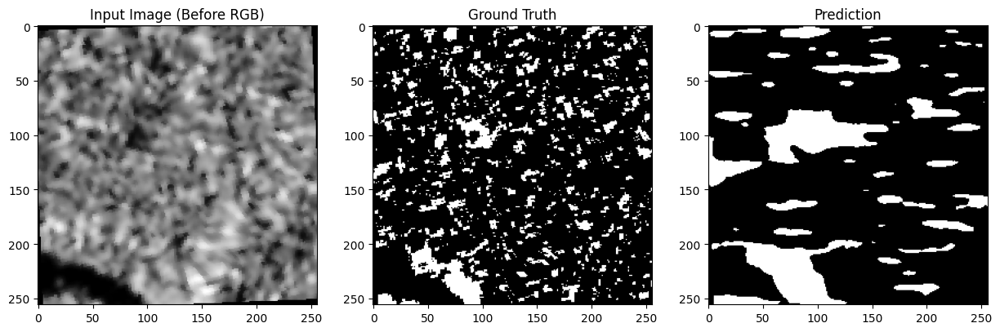

Predicted mask 7: 28.16% foreground


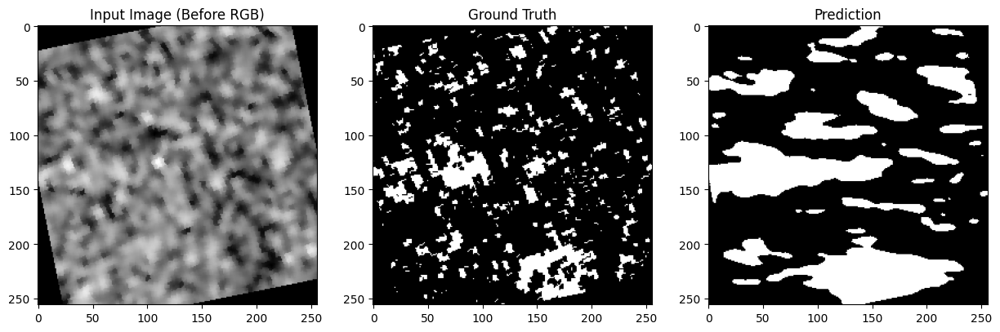

Predicted mask 8: 35.81% foreground


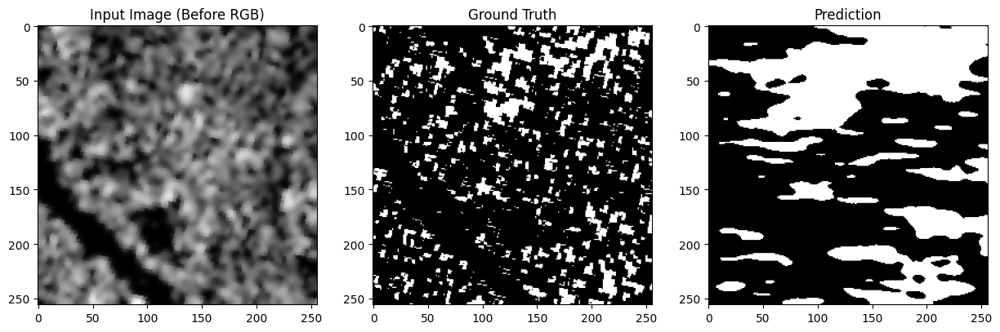

Predicted mask 9: 0.40% foreground


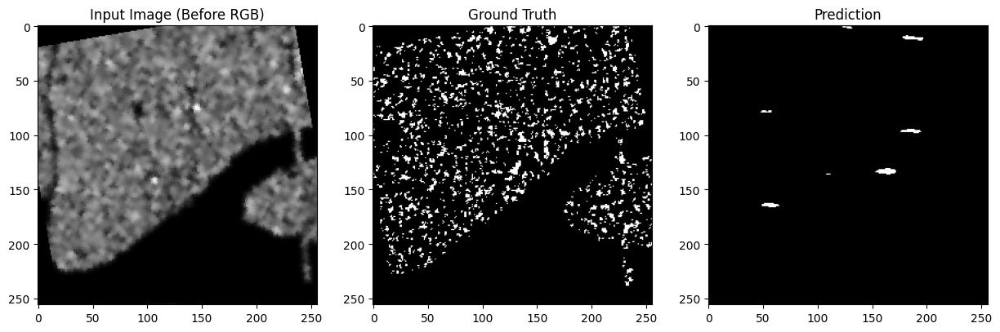

In [5]:
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, random_split
from torch.cuda.amp import GradScaler, autocast
import torchvision.transforms as T
import os
import random

# 1. Load .npz data (from your SAR preprocessing pipeline)
data = np.load("flood_data.npz")
before_dataset = data['before']  # (N, H, W, 3)
after_dataset = data['after']    # (N, H, W, 3)
mask_dataset = data['mask']      # (N, H, W)

def to_tensor_channel_first(img):
    if img.ndim == 3:
        img = np.transpose(img, (2, 0, 1))  # HWC -> CHW
    return img.astype(np.float32)

before_dataset = np.array([to_tensor_channel_first(img) for img in before_dataset])
after_dataset = np.array([to_tensor_channel_first(img) for img in after_dataset])
mask_dataset = np.array([img.astype(np.float32) for img in mask_dataset])

combined_dataset = np.concatenate([before_dataset, after_dataset], axis=1)  # (N, 6, H, W)

# --- Data Augmentation ---
class FloodDataset(Dataset):
    def __init__(self, X, y, augment=False):
        self.X = X
        self.y = y
        self.augment = augment
        self.transform = T.Compose([
            T.RandomHorizontalFlip(),
            T.RandomVerticalFlip(),
            T.RandomRotation(30)
        ]) if augment else None

    def __len__(self):
        return len(self.X)
    def __getitem__(self, idx):
        img = self.X[idx]
        mask = self.y[idx]
        if self.augment and random.random() < 0.8:
            # Apply the same augmentation to image and mask
            stacked = np.concatenate([img, mask[np.newaxis, ...]], axis=0)
            stacked = torch.tensor(stacked)
            stacked = self.transform(stacked)
            img = stacked[:-1].numpy()
            mask = stacked[-1].numpy()
        return torch.tensor(img, dtype=torch.float32), torch.tensor(mask, dtype=torch.float32).unsqueeze(0)

dataset = FloodDataset(combined_dataset, mask_dataset, augment=True)
total = len(dataset)
train_size = int(0.7 * total)
val_size = int(0.15 * total)
test_size = total - train_size - val_size

generator = torch.Generator().manual_seed(42)
train_ds, val_ds, test_ds = random_split(dataset, [train_size, val_size, test_size], generator=generator)
train_loader = DataLoader(train_ds, batch_size=8, shuffle=True, pin_memory=True)
val_loader = DataLoader(val_ds, batch_size=8, pin_memory=True)
test_loader = DataLoader(test_ds, batch_size=8, pin_memory=True)

# --- Tversky Loss for Class Imbalance ---
class TverskyLoss(nn.Module):
    def __init__(self, alpha=0.7, beta=0.3, smooth=1e-6):
        super().__init__()
        self.alpha = alpha
        self.beta = beta
        self.smooth = smooth
    def forward(self, pred, target):
        pred = torch.sigmoid(pred)
        tp = (pred * target).sum()
        fp = ((1 - target) * pred).sum()
        fn = (target * (1 - pred)).sum()
        tversky = (tp + self.smooth) / (tp + self.alpha * fp + self.beta * fn + self.smooth)
        return 1 - tversky

def dice_score(pred, target, smooth=1e-6):
    pred = torch.sigmoid(pred)
    pred = (pred > 0.5).float()
    target = target.float()
    intersection = (pred * target).sum(dim=(1,2,3))
    union = pred.sum(dim=(1,2,3)) + target.sum(dim=(1,2,3))
    dice = (2 * intersection + smooth) / (union + smooth)
    return dice.mean().item()

# --- UNet++ Model (unchanged) ---
class UNetPlusPlus(nn.Module):
    def __init__(self, in_channels=6, out_channels=1, deep_supervision=True):
        super(UNetPlusPlus, self).__init__()
        self.deep_supervision = deep_supervision
        def conv_block(in_c, out_c):
            return nn.Sequential(
                nn.Conv2d(in_c, out_c, 3, padding=1),
                nn.BatchNorm2d(out_c),
                nn.ReLU(inplace=True),
                nn.Conv2d(out_c, out_c, 3, padding=1),
                nn.BatchNorm2d(out_c),
                nn.ReLU(inplace=True)
            )
        self.pool = nn.MaxPool2d(2, 2)
        self.conv0_0 = conv_block(in_channels, 64)
        self.conv1_0 = conv_block(64, 128)
        self.conv2_0 = conv_block(128, 256)
        self.conv3_0 = conv_block(256, 512)
        self.conv4_0 = conv_block(512, 1024)
        self.up1_0 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.up2_0 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.up3_0 = nn.ConvTranspose2d(512, 256, 2, stride=2)
        self.up4_0 = nn.ConvTranspose2d(1024, 512, 2, stride=2)
        self.conv0_1 = conv_block(64+64, 64)
        self.conv1_1 = conv_block(128+128, 128)
        self.conv2_1 = conv_block(256+256, 256)
        self.conv3_1 = conv_block(512+512, 512)
        self.up1_1 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.up2_1 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.up3_1 = nn.ConvTranspose2d(512, 256, 2, stride=2)
        self.conv0_2 = conv_block(64*3, 64)
        self.conv1_2 = conv_block(128*3, 128)
        self.conv2_2 = conv_block(256*3, 256)
        self.up1_2 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.up2_2 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.conv0_3 = conv_block(64*4, 64)
        self.conv1_3 = conv_block(128*4, 128)
        self.up1_3 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.conv0_4 = conv_block(64*5, 64)
        self.final = nn.Conv2d(64, out_channels, kernel_size=1)
    def forward(self, x):
        x0_0 = self.conv0_0(x)
        x1_0 = self.conv1_0(self.pool(x0_0))
        x0_1 = self.conv0_1(torch.cat([x0_0, self.up1_0(x1_0)], 1))
        x2_0 = self.conv2_0(self.pool(x1_0))
        x1_1 = self.conv1_1(torch.cat([x1_0, self.up2_0(x2_0)], 1))
        x0_2 = self.conv0_2(torch.cat([x0_0, x0_1, self.up1_1(x1_1)], 1))
        x3_0 = self.conv3_0(self.pool(x2_0))
        x2_1 = self.conv2_1(torch.cat([x2_0, self.up3_0(x3_0)], 1))
        x1_2 = self.conv1_2(torch.cat([x1_0, x1_1, self.up2_1(x2_1)], 1))
        x0_3 = self.conv0_3(torch.cat([x0_0, x0_1, x0_2, self.up1_2(x1_2)], 1))
        x4_0 = self.conv4_0(self.pool(x3_0))
        x3_1 = self.conv3_1(torch.cat([x3_0, self.up4_0(x4_0)], 1))
        x2_2 = self.conv2_2(torch.cat([x2_0, x2_1, self.up3_1(x3_1)], 1))
        x1_3 = self.conv1_3(torch.cat([x1_0, x1_1, x1_2, self.up2_2(x2_2)], 1))
        x0_4 = self.conv0_4(torch.cat([x0_0, x0_1, x0_2, x0_3, self.up1_3(x1_3)], 1))
        output = self.final(x0_4)
        return output

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = UNetPlusPlus(in_channels=6, out_channels=1).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-5, weight_decay=1e-5)
scaler = GradScaler()
loss_fn = TverskyLoss(alpha=0.7, beta=0.3)
model_path = "flood_segmentation_unetplusplus_train.pth"

def save_model(model, optimizer, path):
    torch.save({
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
    }, path)
    print(f"Model saved to {path}")

best_dice = 0.500
num_epochs = 40

def train_epoch(model, loader, optimizer, loss_fn, scaler):
    model.train()
    running_loss = 0.0
    running_dice = 0.0
    for images, masks in loader:
        images, masks = images.to(device), masks.to(device)
        optimizer.zero_grad()
        with autocast():
            preds = model(images)
            loss = loss_fn(preds, masks)
        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()
        running_loss += loss.item()
        running_dice += dice_score(preds, masks)
    return running_loss / len(loader), running_dice / len(loader)

def validate(model, loader, loss_fn):
    model.eval()
    running_loss = 0.0
    running_dice = 0.0
    with torch.no_grad():
        for images, masks in loader:
            images, masks = images.to(device), masks.to(device)
            preds = model(images)
            loss = loss_fn(preds, masks)
            running_loss += loss.item()
            running_dice += dice_score(preds, masks)
    return running_loss / len(loader), running_dice / len(loader)

print("Starting training from scratch...")
train_losses, val_losses = [], []
train_dices, val_dices = [], []
for epoch in range(num_epochs):
    train_loss, train_dice = train_epoch(model, train_loader, optimizer, loss_fn, scaler)
    val_loss, val_dice = validate(model, val_loader, loss_fn)
    train_losses.append(train_loss)
    train_dices.append(train_dice)
    val_losses.append(val_loss)
    val_dices.append(val_dice)
    print(f"Epoch {epoch+1}/{num_epochs}")
    print(f"Train Loss: {train_loss:.4f} | Train Dice: {train_dice:.4f}")
    print(f"Val Loss: {val_loss:.4f} | Val Dice: {val_dice:.4f}")
    if val_dice > best_dice:
        best_dice = val_dice
        save_model(model, optimizer, model_path)
        print(f"New best model saved with Dice: {best_dice:.4f}")
    print("-" * 50)
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(train_losses, label='Train Loss')
plt.plot(val_losses, label='Val Loss')
plt.legend()
plt.title('Loss over epochs')
plt.subplot(1, 2, 2)
plt.plot(train_dices, label='Train Dice')
plt.plot(val_dices, label='Val Dice')
plt.legend()
plt.title('Dice Score over epochs')
plt.show()

# 7. Test the model
test_loss, test_dice = validate(model, test_loader, loss_fn)
print(f"\nFinal Test Results:")
print(f"Test Loss: {test_loss:.4f} | Test Dice: {test_dice:.4f}")

def visualize_predictions(model, loader, num_samples=10):
    model.eval()
    with torch.no_grad():
        for i, (images, masks) in enumerate(loader):
            if i >= num_samples:
                break
            images, masks = images.to(device), masks.to(device)
            preds = torch.sigmoid(model(images))
            preds_bin = (preds > 0.5).float()
            img_np = images[0, :3].cpu().numpy().transpose(1, 2, 0)
            mask_np = masks[0, 0].cpu().numpy()
            pred_np = preds_bin[0, 0].cpu().numpy()
            fg_pct = 100 * pred_np.sum() / pred_np.size
            print(f"Predicted mask {i}: {fg_pct:.2f}% foreground")
            plt.figure(figsize=(15, 5))
            plt.subplot(1, 3, 1)
            plt.imshow(img_np)
            plt.title('Input Image (Before RGB)')
            plt.subplot(1, 3, 2)
            plt.imshow(mask_np, cmap='gray')
            plt.title('Ground Truth')
            plt.subplot(1, 3, 3)
            plt.imshow(pred_np, cmap='gray')
            plt.title('Prediction')
            plt.show()

visualize_predictions(model, test_loader, num_samples=10)


In [7]:
def print_fg_stats(ds, name="split"):
    fg_pixels = []
    for i in range(len(ds)):
        _, mask = ds[i]
        fg = (mask > 0).sum().item() / mask.numel()
        fg_pixels.append(fg)
    print(f"{name}: Avg % foreground: {np.mean(fg_pixels)*100:.2f}, Min: {np.min(fg_pixels)*100:.2f}, Max: {np.max(fg_pixels)*100:.2f}")

print_fg_stats(train_ds, "Train")
print_fg_stats(val_ds, "Val")
print_fg_stats(test_ds, "Test")


Train: Avg % foreground: 15.66, Min: 0.00, Max: 52.31
Val: Avg % foreground: 16.26, Min: 0.83, Max: 46.24
Test: Avg % foreground: 15.16, Min: 0.52, Max: 40.51


In [8]:
tiny_ds = torch.utils.data.Subset(train_ds, range(10))
tiny_loader = DataLoader(tiny_ds, batch_size=2, shuffle=True)
for epoch in range(20):
    train_loss, train_dice = train_epoch(model, tiny_loader, optimizer, loss_fn, scaler)
    print(f"Tiny set Epoch {epoch+1}: Loss {train_loss:.4f}, Dice {train_dice:.4f}")


/tmp/ipykernel_31/608371932.py:174: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():


Tiny set Epoch 1: Loss 0.7564, Dice 0.2482
Tiny set Epoch 2: Loss 0.7604, Dice 0.2360
Tiny set Epoch 3: Loss 0.7694, Dice 0.2291
Tiny set Epoch 4: Loss 0.7813, Dice 0.2296
Tiny set Epoch 5: Loss 0.7541, Dice 0.2408
Tiny set Epoch 6: Loss 0.7493, Dice 0.2576
Tiny set Epoch 7: Loss 0.7597, Dice 0.2418
Tiny set Epoch 8: Loss 0.7538, Dice 0.2571
Tiny set Epoch 9: Loss 0.7583, Dice 0.2447
Tiny set Epoch 10: Loss 0.7565, Dice 0.2512
Tiny set Epoch 11: Loss 0.7367, Dice 0.2543
Tiny set Epoch 12: Loss 0.7457, Dice 0.2651
Tiny set Epoch 13: Loss 0.7440, Dice 0.2591
Tiny set Epoch 14: Loss 0.7362, Dice 0.2570
Tiny set Epoch 15: Loss 0.7268, Dice 0.2506
Tiny set Epoch 16: Loss 0.7475, Dice 0.2566
Tiny set Epoch 17: Loss 0.7420, Dice 0.2565
Tiny set Epoch 18: Loss 0.7541, Dice 0.2492
Tiny set Epoch 19: Loss 0.7294, Dice 0.2475
Tiny set Epoch 20: Loss 0.7506, Dice 0.2648


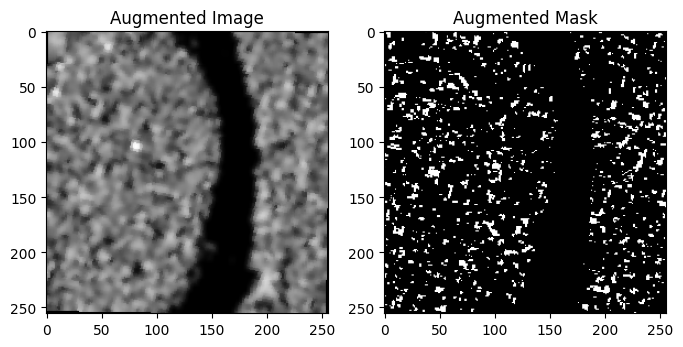

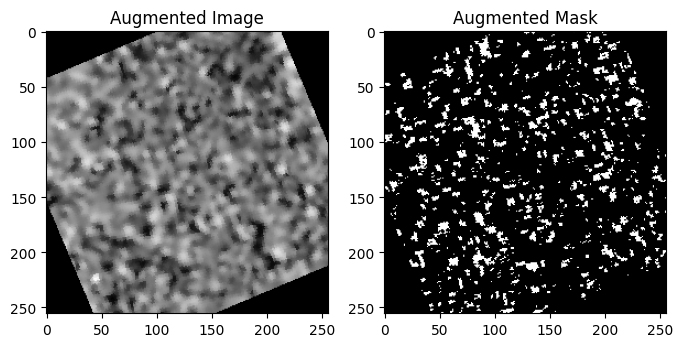

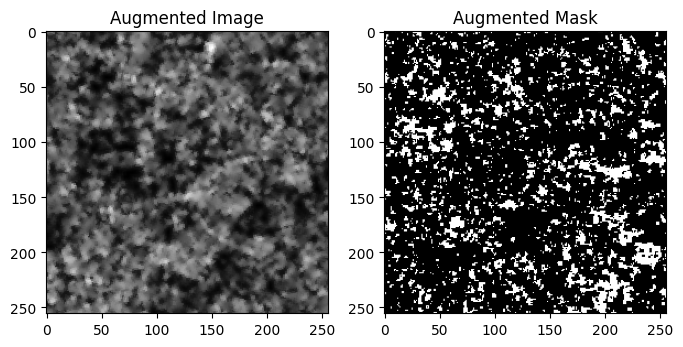

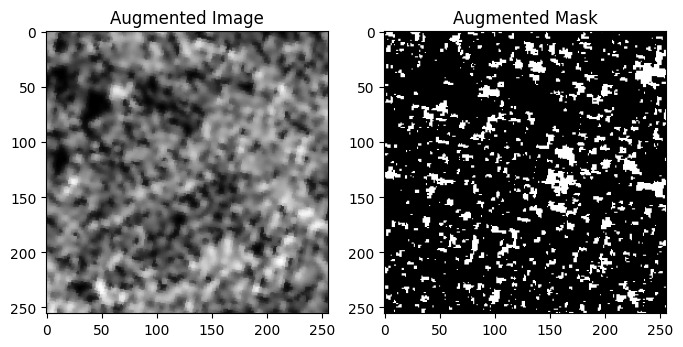

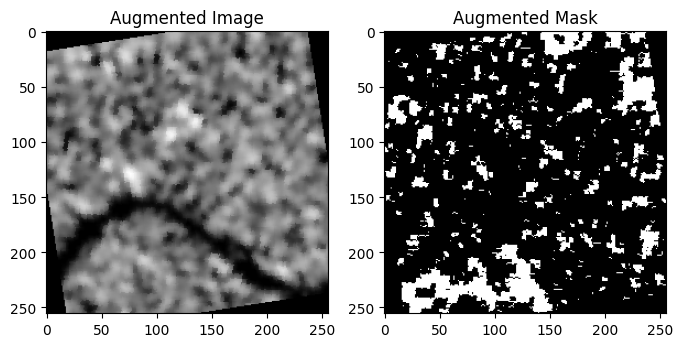

In [9]:
for i in range(5):
    img, mask = train_ds[i]
    plt.figure(figsize=(8,4))
    plt.subplot(1,2,1)
    plt.imshow(img[:3].numpy().transpose(1,2,0))
    plt.title("Augmented Image")
    plt.subplot(1,2,2)
    plt.imshow(mask[0].numpy(), cmap='gray')
    plt.title("Augmented Mask")
    plt.show()


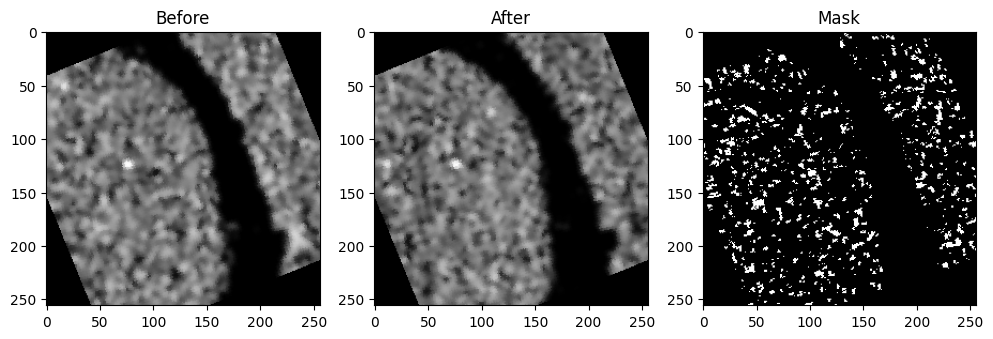

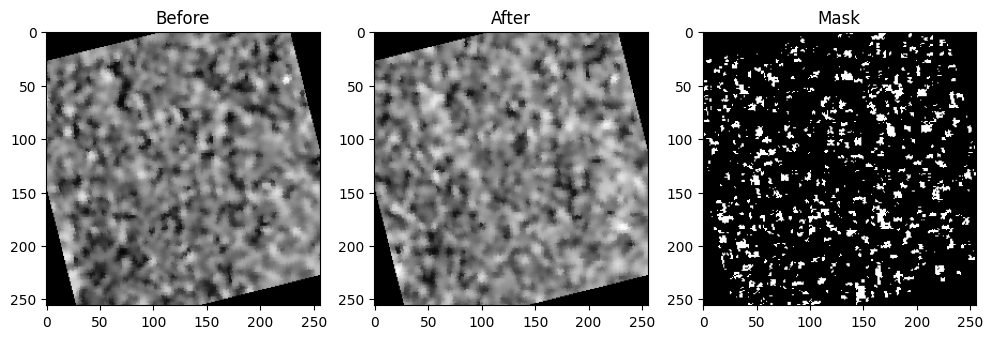

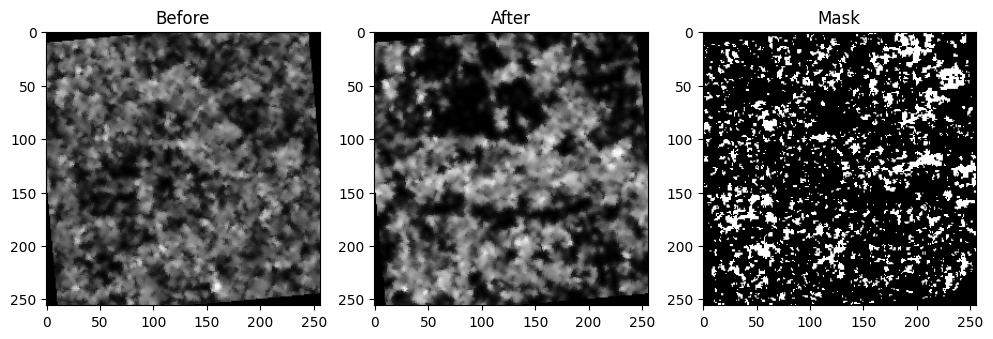

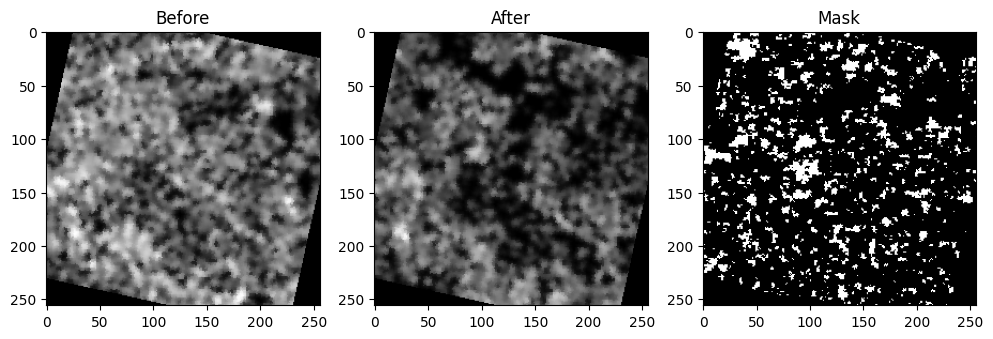

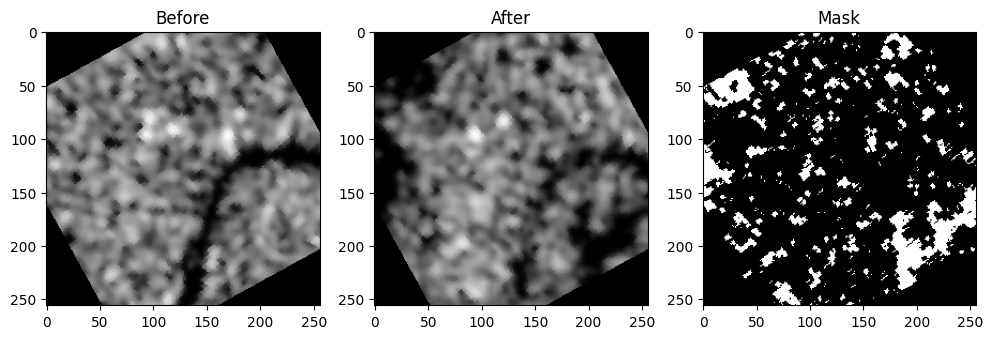

In [10]:
for i in range(5):
    img, mask = train_ds[i]
    before = img[:3].numpy().transpose(1,2,0)
    after = img[3:6].numpy().transpose(1,2,0)
    plt.figure(figsize=(12,4))
    plt.subplot(1,3,1)
    plt.imshow(before)
    plt.title("Before")
    plt.subplot(1,3,2)
    plt.imshow(after)
    plt.title("After")
    plt.subplot(1,3,3)
    plt.imshow(mask[0].numpy(), cmap='gray')
    plt.title("Mask")
    plt.show()


✅ Total Paired Samples: 2734
Saved .npz file to flood_data.npz
Total all-zero masks: 1 out of 2734
Sample 2192: Foreground pixels = 20.43%


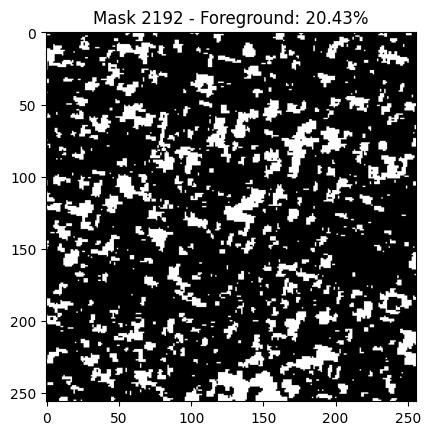

Sample 699: Foreground pixels = 16.08%


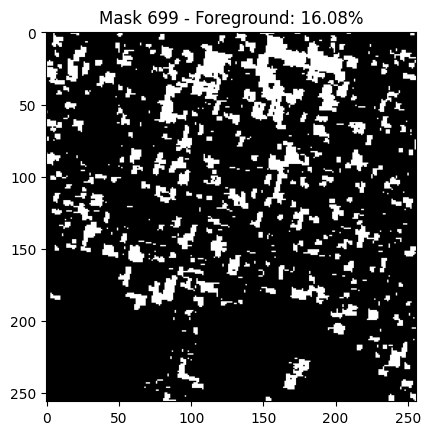

Sample 1163: Foreground pixels = 11.59%


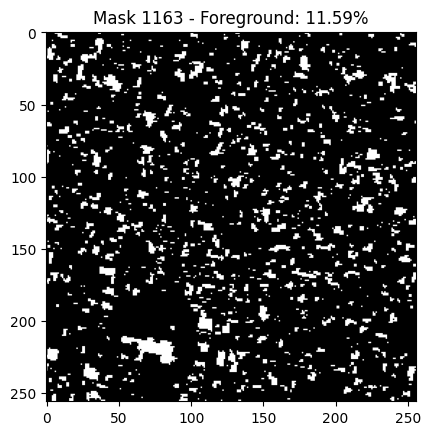

Sample 1150: Foreground pixels = 17.46%


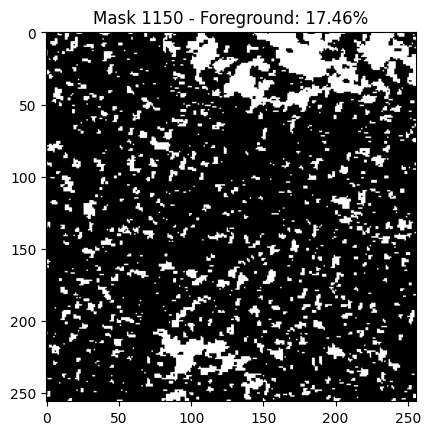

Sample 1682: Foreground pixels = 21.29%


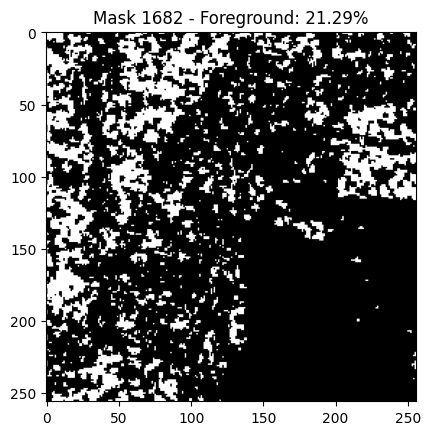

Total all-zero masks in visualization: 0 out of 5


In [11]:
import os
import re
import glob
import numpy as np
import matplotlib.pyplot as plt
import random
import cv2
import rasterio

def lee_filter(img, size=7):
    img_mean = cv2.blur(img, (size, size))
    img_sqr_mean = cv2.blur(img**2, (size, size))
    img_variance = img_sqr_mean - img_mean**2
    overall_variance = np.var(img)
    img_weights = img_variance / (img_variance + overall_variance + 1e-8)
    img_filtered = img_mean + img_weights * (img - img_mean)
    return img_filtered

def extract_key(filename):
    name = os.path.basename(filename).lower()
    if any(city in name for city in ['gorakhpur', 'chennai', 'brahmaputra']):
        if 'mask' in name:
            match = re.search(r'sen_\w+_mask_(\d+)', name)
            return f'divit_{match.group(1)}' if match else None
        else:
            match = re.search(r'sen_\w+_(\d{8})_(\d+)', name)
            return f'divit_{match.group(2)}' if match else None
    if re.match(r'sen_gj_\d{4}_', name):
        match = re.search(r'sen_(\w{2})_(\d{4})', name)
        if match:
            state, tile = match.groups()
            return f"{state}_{tile}"
    match_vijay2 = re.search(r'sen_(\w{2})_(\d{6})_(\d{4})', name)
    if match_vijay2:
        state, _, tile = match_vijay2.groups()
        return f"{state}_{tile}"
    match_vijay = re.search(r'sen_(\w{2})_(\d{4})_\d{4}', name)
    if match_vijay:
        state, tile = match_vijay.groups()
        return f"{state}_{tile}"
    match_general = re.search(r'sen_(\w{2})_\d{8}_(\d{4})', name)
    if match_general:
        state, tile = match_general.groups()
        return f"{state}_{tile}"
    return None

def load_dataset(base_dir, target_size=(256, 256)):
    before_folder = os.path.join(base_dir, 'before_geotiff')
    after_folder = os.path.join(base_dir, 'after_geotiff')
    mask_folder = os.path.join(base_dir, 'masked_geotiff')
    before_images = sorted(glob.glob(os.path.join(before_folder, '*.tif')))
    after_images = sorted(glob.glob(os.path.join(after_folder, '*.tif')))
    mask_images = sorted(glob.glob(os.path.join(mask_folder, '*.tif')))
    before_dict = {extract_key(f): f for f in before_images if extract_key(f)}
    after_dict = {extract_key(f): f for f in after_images if extract_key(f)}
    mask_dict = {extract_key(f): f for f in mask_images if extract_key(f)}
    paired_data = []
    for key in before_dict:
        if key in after_dict and key in mask_dict:
            paired_data.append((before_dict[key], after_dict[key], mask_dict[key]))
    print(f"✅ Total Paired Samples: {len(paired_data)}")
    return paired_data

def preprocess_sar_image_tiff(img_path, target_size=(256, 256), apply_lee=True):
    with rasterio.open(img_path) as src:
        img = src.read(1).astype(np.float32)
    img = (img - img.min()) / (img.max() - img.min() + 1e-8)
    if apply_lee:
        img = lee_filter(img)
        img = (img - img.min()) / (img.max() - img.min() + 1e-8)
    img = cv2.resize(img, target_size, interpolation=cv2.INTER_LINEAR)
    img = np.stack([img]*3, axis=-1)
    return img

def preprocess_and_save_npz(
    paired_data, output_path, target_size=(256, 256),
    apply_lee=True
):
    before_list, after_list, mask_list = [], [], []
    all_zero_count = 0
    for idx, (before_path, after_path, mask_path) in enumerate(paired_data):
        before_img = preprocess_sar_image_tiff(before_path, target_size, apply_lee)
        after_img = preprocess_sar_image_tiff(after_path, target_size, apply_lee)
        with rasterio.open(mask_path) as src:
            mask_arr = src.read(1)
        mask_arr = cv2.resize(mask_arr, target_size, interpolation=cv2.INTER_NEAREST)
        bin_mask = (mask_arr > 50).astype(np.uint8)  # Lower threshold!
        if np.all(bin_mask == 0):
            all_zero_count += 1
            print(f"Warning: All-zero mask for {mask_path}")
        before_list.append(before_img)
        after_list.append(after_img)
        mask_list.append(bin_mask)
    before_np = np.stack(before_list)
    after_np = np.stack(after_list)
    mask_np = np.stack(mask_list)
    np.savez_compressed(output_path, before=before_np, after=after_np, mask=mask_np)
    print(f"Saved .npz file to {output_path}")
    print(f"Total all-zero masks: {all_zero_count} out of {len(mask_list)}")

# --- Run this ONCE to create your .npz ---
base_dir = "/kaggle/working"
paired_data = load_dataset(base_dir)
preprocess_and_save_npz(
    paired_data,
    "flood_data.npz",
    target_size=(256, 256),
    apply_lee=True
)

# --- Visualize random masks from the saved .npz file to ensure no all-zero masks ---
def visualize_masks(npz_path, num_samples=5):
    data = np.load(npz_path)
    masks = data['mask']
    total = len(masks)
    all_zero_count = 0
    for i in range(num_samples):
        idx = random.randint(0, total-1)
        mask = masks[idx]
        percent_fg = 100 * (mask > 0).sum() / mask.size
        if np.all(mask == 0):
            all_zero_count += 1
        print(f"Sample {idx}: Foreground pixels = {percent_fg:.2f}%")
        plt.imshow(mask, cmap='gray')
        plt.title(f"Mask {idx} - Foreground: {percent_fg:.2f}%")
        plt.show()
    print(f"Total all-zero masks in visualization: {all_zero_count} out of {num_samples}")

visualize_masks("flood_data.npz", num_samples=5)


/tmp/ipykernel_31/4054533434.py:149: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler()
/tmp/ipykernel_31/4054533434.py:170: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():


Starting training from scratch...
Epoch 1/20
Train Loss: 0.7627 | Train Dice: 0.2854
Val Loss: 0.7403 | Val Dice: 0.2936
--------------------------------------------------
Epoch 2/20
Train Loss: 0.7456 | Train Dice: 0.2860
Val Loss: 0.7313 | Val Dice: 0.2810
--------------------------------------------------
Epoch 3/20
Train Loss: 0.7396 | Train Dice: 0.2918
Val Loss: 0.7311 | Val Dice: 0.2932
--------------------------------------------------
Epoch 4/20
Train Loss: 0.7373 | Train Dice: 0.2926
Val Loss: 0.7282 | Val Dice: 0.2849
--------------------------------------------------
Epoch 5/20
Train Loss: 0.7342 | Train Dice: 0.2959
Val Loss: 0.7277 | Val Dice: 0.2979
--------------------------------------------------
Epoch 6/20
Train Loss: 0.7326 | Train Dice: 0.2960
Val Loss: 0.7284 | Val Dice: 0.3014
--------------------------------------------------
Epoch 7/20
Train Loss: 0.7311 | Train Dice: 0.2926
Val Loss: 0.7293 | Val Dice: 0.3044
--------------------------------------------------


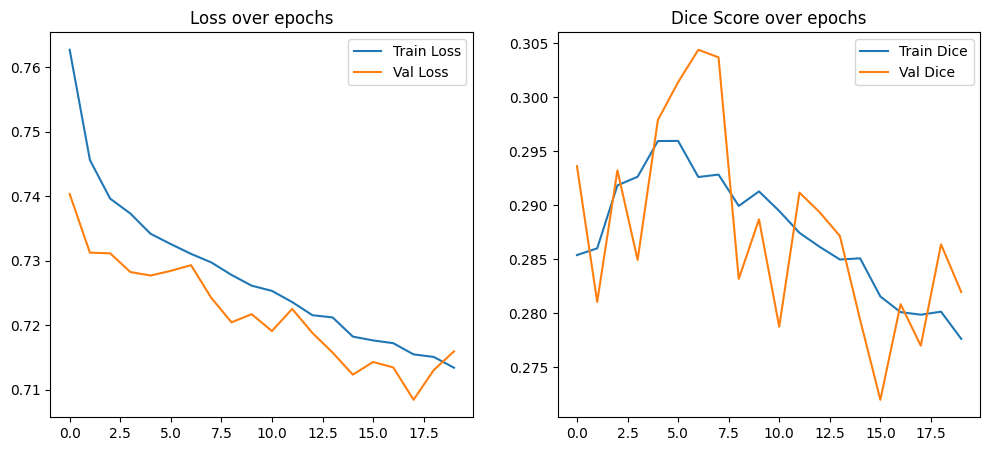


Final Test Results:
Test Loss: 0.7227 | Test Dice: 0.2729
Predicted mask 0: 49.85% foreground


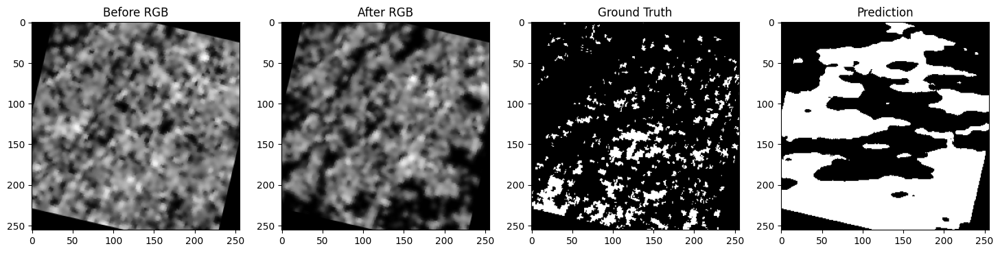

Predicted mask 1: 29.51% foreground


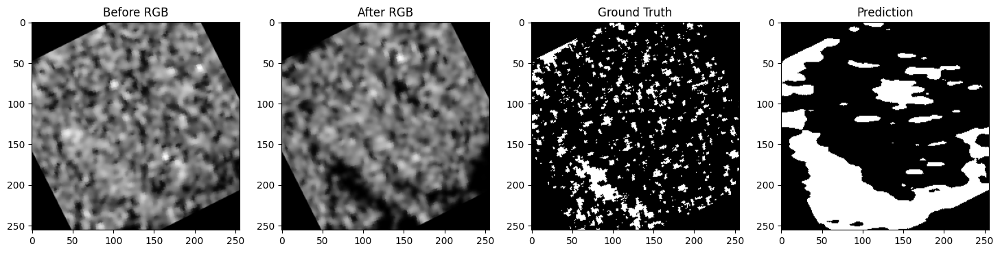

Predicted mask 2: 7.32% foreground


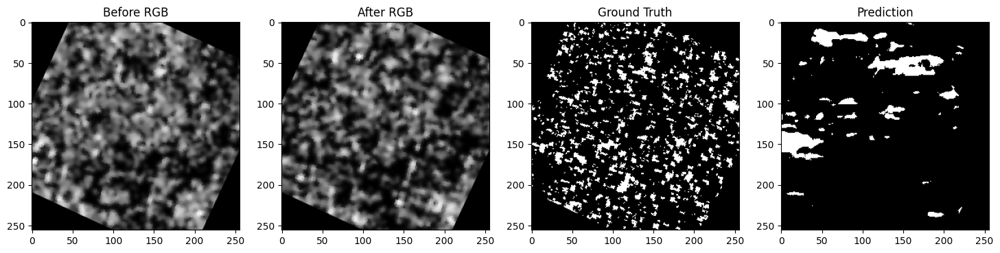

Predicted mask 3: 53.07% foreground


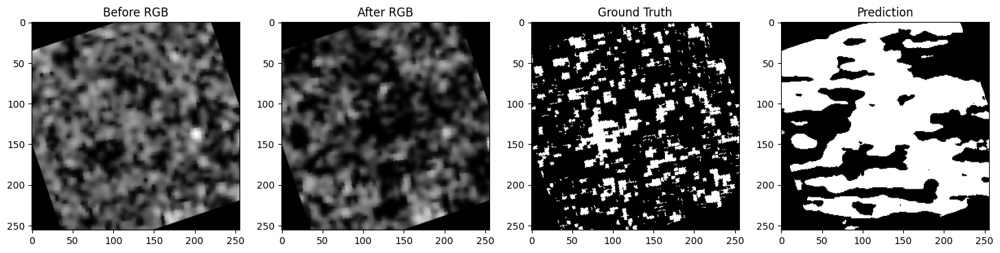

Predicted mask 4: 4.24% foreground


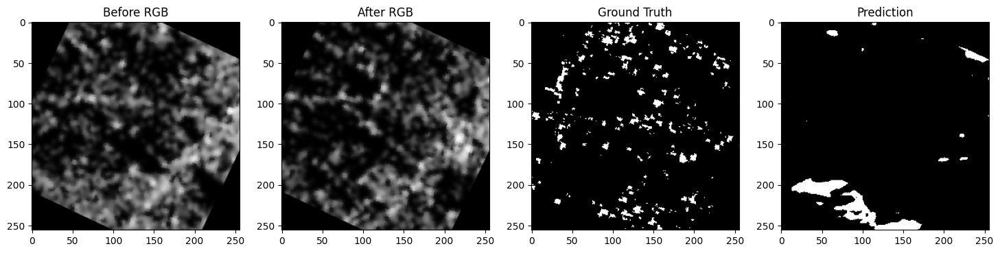

In [13]:
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, random_split
from torch.cuda.amp import GradScaler, autocast
import torchvision.transforms as T
import torchvision.transforms.functional as TF
import os
import random

data = np.load("flood_data.npz")
before_dataset = data['before']
after_dataset = data['after']
mask_dataset = data['mask']

def to_tensor_channel_first(img):
    if img.ndim == 3:
        img = np.transpose(img, (2, 0, 1))
    return img.astype(np.float32)

before_dataset = np.array([to_tensor_channel_first(img) for img in before_dataset])
after_dataset = np.array([to_tensor_channel_first(img) for img in after_dataset])
mask_dataset = np.array([img.astype(np.float32) for img in mask_dataset])

combined_dataset = np.concatenate([before_dataset, after_dataset], axis=1)

class FloodDataset(Dataset):
    def __init__(self, X, y, augment=False):
        self.X = X
        self.y = y
        self.augment = augment

    def __len__(self):
        return len(self.X)
    def __getitem__(self, idx):
        img = torch.tensor(self.X[idx], dtype=torch.float32)
        mask = torch.tensor(self.y[idx], dtype=torch.float32).unsqueeze(0)
        if self.augment and random.random() < 0.8:
            # Apply the same random transforms to both image and mask
            angle = random.uniform(-30, 30)
            img = TF.rotate(img, angle, interpolation=TF.InterpolationMode.BILINEAR)
            mask = TF.rotate(mask, angle, interpolation=TF.InterpolationMode.NEAREST)
            if random.random() > 0.5:
                img = TF.hflip(img)
                mask = TF.hflip(mask)
            if random.random() > 0.5:
                img = TF.vflip(img)
                mask = TF.vflip(mask)
        return img, mask

dataset = FloodDataset(combined_dataset, mask_dataset, augment=True)
total = len(dataset)
train_size = int(0.7 * total)
val_size = int(0.15 * total)
test_size = total - train_size - val_size

generator = torch.Generator().manual_seed(42)
train_ds, val_ds, test_ds = random_split(dataset, [train_size, val_size, test_size], generator=generator)
train_loader = DataLoader(train_ds, batch_size=8, shuffle=True, pin_memory=True)
val_loader = DataLoader(val_ds, batch_size=8, pin_memory=True)
test_loader = DataLoader(test_ds, batch_size=8, pin_memory=True)

class TverskyLoss(nn.Module):
    def __init__(self, alpha=0.7, beta=0.3, smooth=1e-6):
        super().__init__()
        self.alpha = alpha
        self.beta = beta
        self.smooth = smooth
    def forward(self, pred, target):
        pred = torch.sigmoid(pred)
        tp = (pred * target).sum()
        fp = ((1 - target) * pred).sum()
        fn = (target * (1 - pred)).sum()
        tversky = (tp + self.smooth) / (tp + self.alpha * fp + self.beta * fn + self.smooth)
        return 1 - tversky

def dice_score(pred, target, smooth=1e-6):
    pred = torch.sigmoid(pred)
    pred = (pred > 0.5).float()
    target = target.float()
    intersection = (pred * target).sum(dim=(1,2,3))
    union = pred.sum(dim=(1,2,3)) + target.sum(dim=(1,2,3))
    dice = (2 * intersection + smooth) / (union + smooth)
    return dice.mean().item()

class UNetPlusPlus(nn.Module):
    def __init__(self, in_channels=6, out_channels=1, deep_supervision=True):
        super(UNetPlusPlus, self).__init__()
        self.deep_supervision = deep_supervision
        def conv_block(in_c, out_c):
            return nn.Sequential(
                nn.Conv2d(in_c, out_c, 3, padding=1),
                nn.BatchNorm2d(out_c),
                nn.ReLU(inplace=True),
                nn.Conv2d(out_c, out_c, 3, padding=1),
                nn.BatchNorm2d(out_c),
                nn.ReLU(inplace=True)
            )
        self.pool = nn.MaxPool2d(2, 2)
        self.conv0_0 = conv_block(in_channels, 64)
        self.conv1_0 = conv_block(64, 128)
        self.conv2_0 = conv_block(128, 256)
        self.conv3_0 = conv_block(256, 512)
        self.conv4_0 = conv_block(512, 1024)
        self.up1_0 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.up2_0 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.up3_0 = nn.ConvTranspose2d(512, 256, 2, stride=2)
        self.up4_0 = nn.ConvTranspose2d(1024, 512, 2, stride=2)
        self.conv0_1 = conv_block(64+64, 64)
        self.conv1_1 = conv_block(128+128, 128)
        self.conv2_1 = conv_block(256+256, 256)
        self.conv3_1 = conv_block(512+512, 512)
        self.up1_1 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.up2_1 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.up3_1 = nn.ConvTranspose2d(512, 256, 2, stride=2)
        self.conv0_2 = conv_block(64*3, 64)
        self.conv1_2 = conv_block(128*3, 128)
        self.conv2_2 = conv_block(256*3, 256)
        self.up1_2 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.up2_2 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.conv0_3 = conv_block(64*4, 64)
        self.conv1_3 = conv_block(128*4, 128)
        self.up1_3 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.conv0_4 = conv_block(64*5, 64)
        self.final = nn.Conv2d(64, out_channels, kernel_size=1)
    def forward(self, x):
        x0_0 = self.conv0_0(x)
        x1_0 = self.conv1_0(self.pool(x0_0))
        x0_1 = self.conv0_1(torch.cat([x0_0, self.up1_0(x1_0)], 1))
        x2_0 = self.conv2_0(self.pool(x1_0))
        x1_1 = self.conv1_1(torch.cat([x1_0, self.up2_0(x2_0)], 1))
        x0_2 = self.conv0_2(torch.cat([x0_0, x0_1, self.up1_1(x1_1)], 1))
        x3_0 = self.conv3_0(self.pool(x2_0))
        x2_1 = self.conv2_1(torch.cat([x2_0, self.up3_0(x3_0)], 1))
        x1_2 = self.conv1_2(torch.cat([x1_0, x1_1, self.up2_1(x2_1)], 1))
        x0_3 = self.conv0_3(torch.cat([x0_0, x0_1, x0_2, self.up1_2(x1_2)], 1))
        x4_0 = self.conv4_0(self.pool(x3_0))
        x3_1 = self.conv3_1(torch.cat([x3_0, self.up4_0(x4_0)], 1))
        x2_2 = self.conv2_2(torch.cat([x2_0, x2_1, self.up3_1(x3_1)], 1))
        x1_3 = self.conv1_3(torch.cat([x1_0, x1_1, x1_2, self.up2_2(x2_2)], 1))
        x0_4 = self.conv0_4(torch.cat([x0_0, x0_1, x0_2, x0_3, self.up1_3(x1_3)], 1))
        output = self.final(x0_4)
        return output

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = UNetPlusPlus(in_channels=6, out_channels=1).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-5, weight_decay=1e-5)
scaler = GradScaler()
loss_fn = TverskyLoss(alpha=0.7, beta=0.3)
model_path = "flood_segmentation_unetplusplus_train.pth"

def save_model(model, optimizer, path):
    torch.save({
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
    }, path)
    print(f"Model saved to {path}")

best_dice = 0.500
num_epochs = 20

def train_epoch(model, loader, optimizer, loss_fn, scaler):
    model.train()
    running_loss = 0.0
    running_dice = 0.0
    for images, masks in loader:
        images, masks = images.to(device), masks.to(device)
        optimizer.zero_grad()
        with autocast():
            preds = model(images)
            loss = loss_fn(preds, masks)
        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()
        running_loss += loss.item()
        running_dice += dice_score(preds, masks)
    return running_loss / len(loader), running_dice / len(loader)

def validate(model, loader, loss_fn):
    model.eval()
    running_loss = 0.0
    running_dice = 0.0
    with torch.no_grad():
        for images, masks in loader:
            images, masks = images.to(device), masks.to(device)
            preds = model(images)
            loss = loss_fn(preds, masks)
            running_loss += loss.item()
            running_dice += dice_score(preds, masks)
    return running_loss / len(loader), running_dice / len(loader)

print("Starting training from scratch...")
train_losses, val_losses = [], []
train_dices, val_dices = [], []
for epoch in range(num_epochs):
    train_loss, train_dice = train_epoch(model, train_loader, optimizer, loss_fn, scaler)
    val_loss, val_dice = validate(model, val_loader, loss_fn)
    train_losses.append(train_loss)
    train_dices.append(train_dice)
    val_losses.append(val_loss)
    val_dices.append(val_dice)
    print(f"Epoch {epoch+1}/{num_epochs}")
    print(f"Train Loss: {train_loss:.4f} | Train Dice: {train_dice:.4f}")
    print(f"Val Loss: {val_loss:.4f} | Val Dice: {val_dice:.4f}")
    if val_dice > best_dice:
        best_dice = val_dice
        save_model(model, optimizer, model_path)
        print(f"New best model saved with Dice: {best_dice:.4f}")
    print("-" * 50)
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(train_losses, label='Train Loss')
plt.plot(val_losses, label='Val Loss')
plt.legend()
plt.title('Loss over epochs')
plt.subplot(1, 2, 2)
plt.plot(train_dices, label='Train Dice')
plt.plot(val_dices, label='Val Dice')
plt.legend()
plt.title('Dice Score over epochs')
plt.show()

test_loss, test_dice = validate(model, test_loader, loss_fn)
print(f"\nFinal Test Results:")
print(f"Test Loss: {test_loss:.4f} | Test Dice: {test_dice:.4f}")

def visualize_predictions(model, loader, num_samples=5):
    model.eval()
    with torch.no_grad():
        for i, (images, masks) in enumerate(loader):
            if i >= num_samples:
                break
            images, masks = images.to(device), masks.to(device)
            preds = torch.sigmoid(model(images))
            preds_bin = (preds > 0.5).float()
            img_np = images[0, :3].cpu().numpy().transpose(1, 2, 0)
            after_np = images[0, 3:6].cpu().numpy().transpose(1, 2, 0)
            mask_np = masks[0, 0].cpu().numpy()
            pred_np = preds_bin[0, 0].cpu().numpy()
            fg_pct = 100 * pred_np.sum() / pred_np.size
            print(f"Predicted mask {i}: {fg_pct:.2f}% foreground")
            plt.figure(figsize=(18, 5))
            plt.subplot(1, 4, 1)
            plt.imshow(img_np)
            plt.title('Before RGB')
            plt.subplot(1, 4, 2)
            plt.imshow(after_np)
            plt.title('After RGB')
            plt.subplot(1, 4, 3)
            plt.imshow(mask_np, cmap='gray')
            plt.title('Ground Truth')
            plt.subplot(1, 4, 4)
            plt.imshow(pred_np, cmap='gray')
            plt.title('Prediction')
            plt.show()

visualize_predictions(model, test_loader, num_samples=5)


In [14]:
tiny_ds = torch.utils.data.Subset(train_ds, range(10))
tiny_loader = DataLoader(tiny_ds, batch_size=2, shuffle=True)
tiny_model = UNetPlusPlus(in_channels=6, out_channels=1).to(device)
tiny_optimizer = torch.optim.Adam(tiny_model.parameters(), lr=1e-4)
tiny_scaler = GradScaler()
tiny_loss_fn = TverskyLoss(alpha=0.7, beta=0.3)
for epoch in range(20):
    train_loss, train_dice = train_epoch(tiny_model, tiny_loader, tiny_optimizer, tiny_loss_fn, tiny_scaler)
    print(f"Tiny set Epoch {epoch+1}: Loss {train_loss:.4f}, Dice {train_dice:.4f}")


/tmp/ipykernel_31/1161621250.py:5: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  tiny_scaler = GradScaler()
/tmp/ipykernel_31/4054533434.py:170: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():


Tiny set Epoch 1: Loss 0.8236, Dice 0.1974
Tiny set Epoch 2: Loss 0.8044, Dice 0.2546
Tiny set Epoch 3: Loss 0.8068, Dice 0.2519
Tiny set Epoch 4: Loss 0.7960, Dice 0.2595
Tiny set Epoch 5: Loss 0.7987, Dice 0.2561
Tiny set Epoch 6: Loss 0.7924, Dice 0.2609
Tiny set Epoch 7: Loss 0.7888, Dice 0.2645
Tiny set Epoch 8: Loss 0.7966, Dice 0.2587
Tiny set Epoch 9: Loss 0.7848, Dice 0.2635
Tiny set Epoch 10: Loss 0.7885, Dice 0.2664
Tiny set Epoch 11: Loss 0.7886, Dice 0.2598
Tiny set Epoch 12: Loss 0.7811, Dice 0.2737
Tiny set Epoch 13: Loss 0.7898, Dice 0.2582
Tiny set Epoch 14: Loss 0.7888, Dice 0.2722
Tiny set Epoch 15: Loss 0.7815, Dice 0.2722
Tiny set Epoch 16: Loss 0.7919, Dice 0.2602
Tiny set Epoch 17: Loss 0.7786, Dice 0.2702
Tiny set Epoch 18: Loss 0.7778, Dice 0.2599
Tiny set Epoch 19: Loss 0.7780, Dice 0.2656
Tiny set Epoch 20: Loss 0.7775, Dice 0.2554


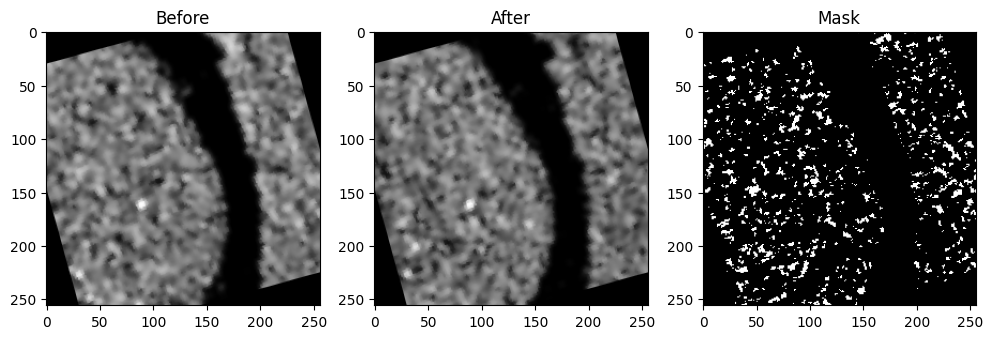

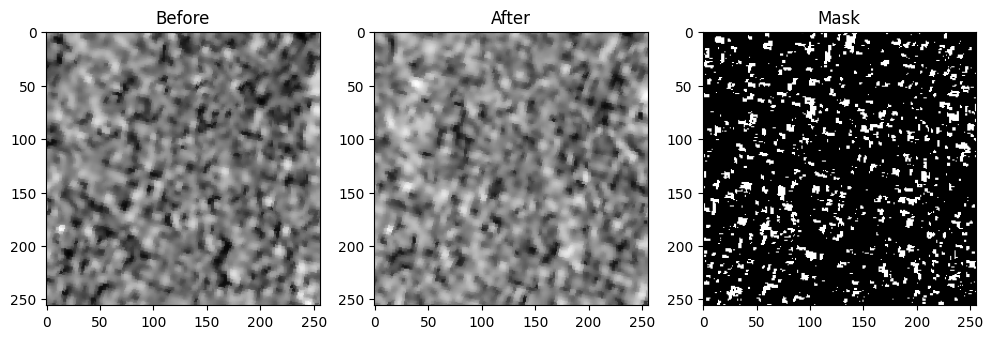

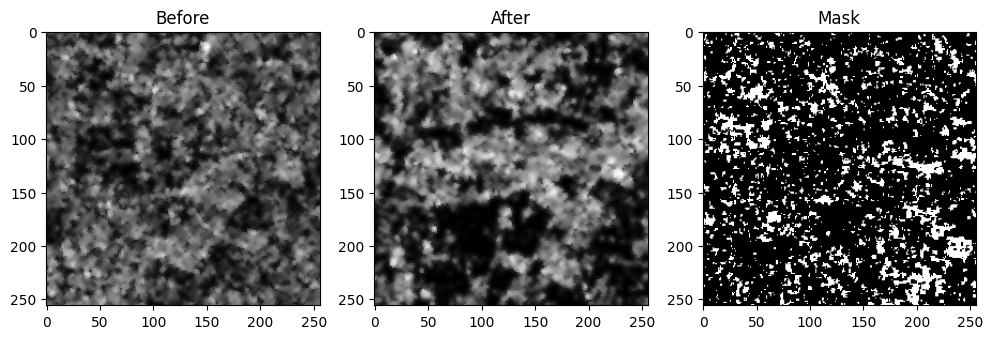

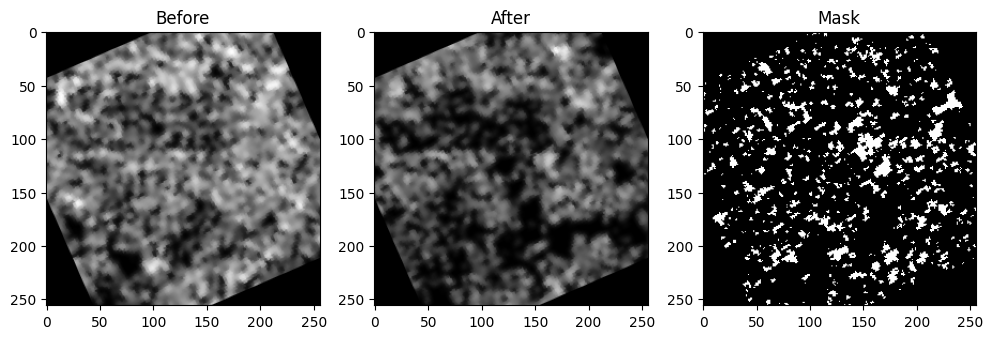

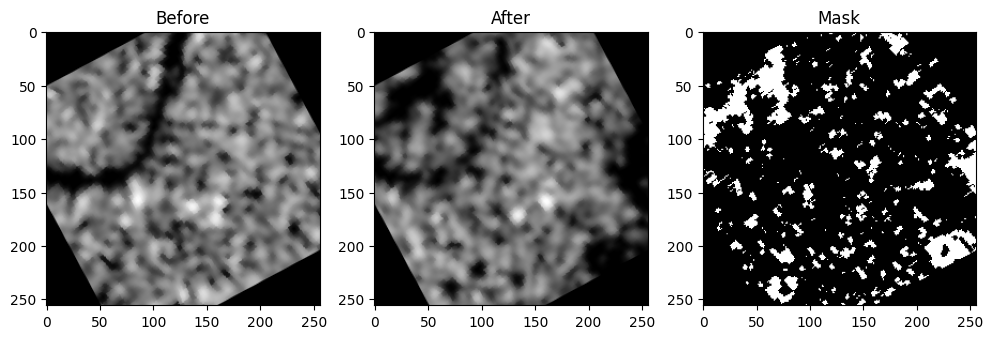

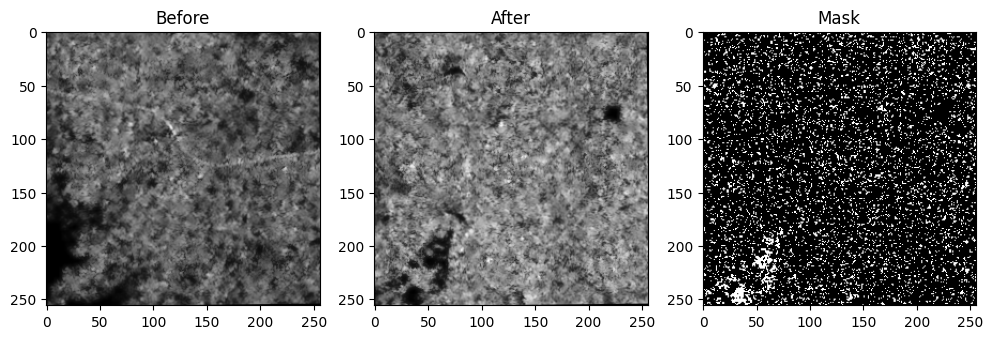

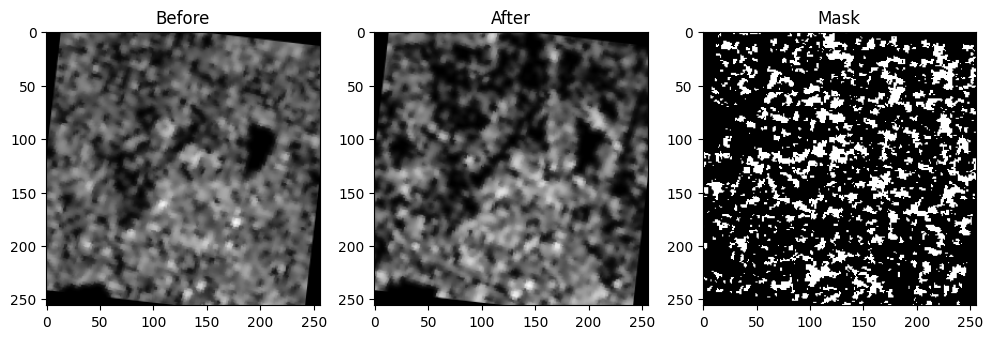

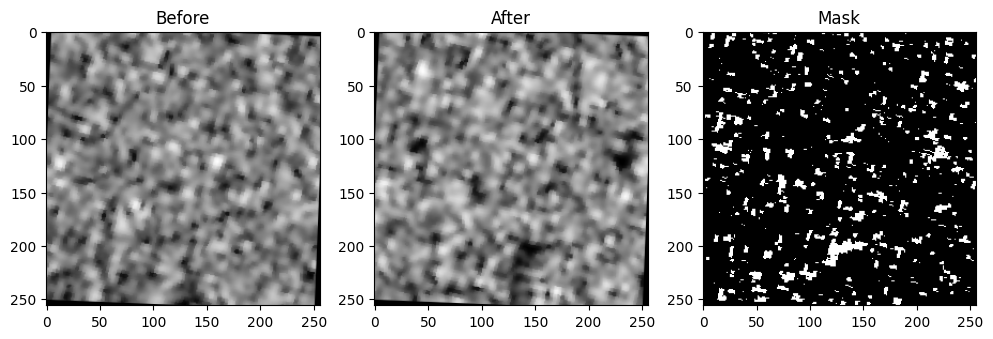

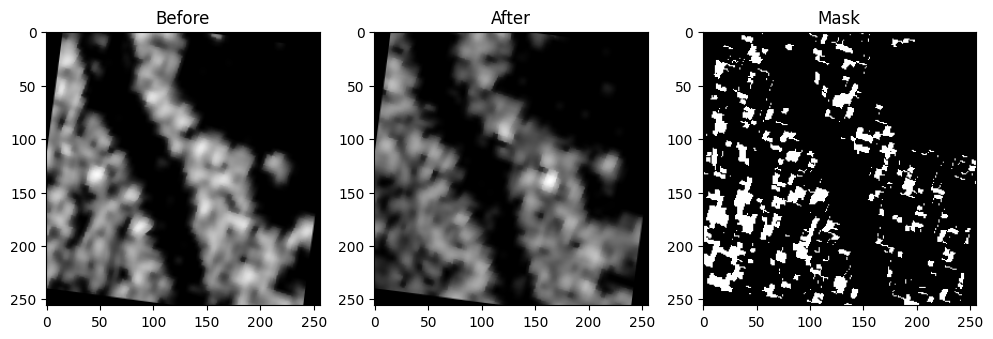

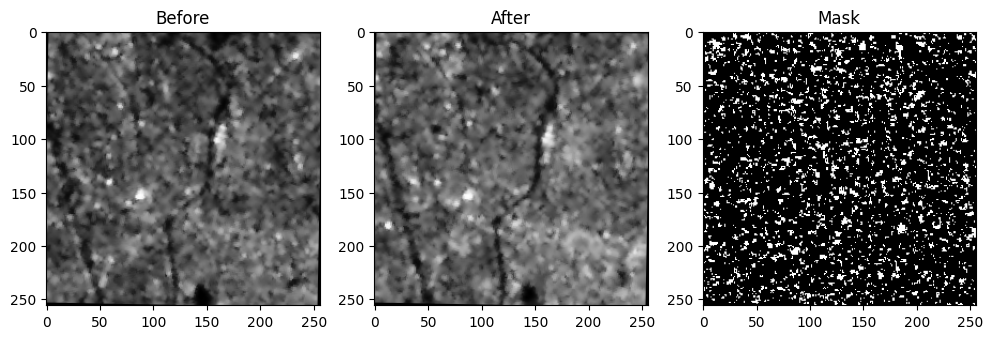

In [15]:
for i in range(10):
    img, mask = tiny_ds[i]
    before = img[:3].numpy().transpose(1,2,0)
    after = img[3:6].numpy().transpose(1,2,0)
    plt.figure(figsize=(12,4))
    plt.subplot(1,3,1)
    plt.imshow(before)
    plt.title("Before")
    plt.subplot(1,3,2)
    plt.imshow(after)
    plt.title("After")
    plt.subplot(1,3,3)
    plt.imshow(mask[0].numpy(), cmap='gray')
    plt.title("Mask")
    plt.show()


In [16]:
for i in range(10):
    _, mask = tiny_ds[i]
    fg = (mask > 0).sum().item() / mask.numel()
    print(f"Tiny sample {i}: % foreground: {fg*100:.2f}")


Tiny sample 0: % foreground: 8.24
Tiny sample 1: % foreground: 12.05
Tiny sample 2: % foreground: 16.79
Tiny sample 3: % foreground: 12.45
Tiny sample 4: % foreground: 18.70
Tiny sample 5: % foreground: 13.72
Tiny sample 6: % foreground: 22.88
Tiny sample 7: % foreground: 9.22
Tiny sample 8: % foreground: 14.26
Tiny sample 9: % foreground: 11.72


In [17]:
tiny_model = UNetPlusPlus(in_channels=6, out_channels=1).to(device)
tiny_optimizer = torch.optim.Adam(tiny_model.parameters(), lr=1e-4)
tiny_scaler = GradScaler()
tiny_loss_fn = nn.BCEWithLogitsLoss()
for epoch in range(20):
    train_loss, train_dice = train_epoch(tiny_model, tiny_loader, tiny_optimizer, tiny_loss_fn, tiny_scaler)
    print(f"Tiny set Epoch {epoch+1}: Loss {train_loss:.4f}, Dice {train_dice:.4f}")


/tmp/ipykernel_31/4199944639.py:3: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  tiny_scaler = GradScaler()
/tmp/ipykernel_31/4054533434.py:170: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():


Tiny set Epoch 1: Loss 0.7781, Dice 0.2381
Tiny set Epoch 2: Loss 0.7121, Dice 0.2455
Tiny set Epoch 3: Loss 0.6613, Dice 0.2290
Tiny set Epoch 4: Loss 0.6194, Dice 0.1828
Tiny set Epoch 5: Loss 0.5875, Dice 0.1409
Tiny set Epoch 6: Loss 0.5534, Dice 0.0669
Tiny set Epoch 7: Loss 0.5391, Dice 0.0290
Tiny set Epoch 8: Loss 0.5232, Dice 0.0139
Tiny set Epoch 9: Loss 0.5211, Dice 0.0079
Tiny set Epoch 10: Loss 0.5063, Dice 0.0074
Tiny set Epoch 11: Loss 0.4964, Dice 0.0054
Tiny set Epoch 12: Loss 0.4888, Dice 0.0046
Tiny set Epoch 13: Loss 0.4965, Dice 0.0077
Tiny set Epoch 14: Loss 0.4837, Dice 0.0027
Tiny set Epoch 15: Loss 0.4867, Dice 0.0071
Tiny set Epoch 16: Loss 0.4871, Dice 0.0043
Tiny set Epoch 17: Loss 0.4714, Dice 0.0031
Tiny set Epoch 18: Loss 0.4707, Dice 0.0017
Tiny set Epoch 19: Loss 0.4859, Dice 0.0273
Tiny set Epoch 20: Loss 0.4730, Dice 0.0042


In [18]:
for i in range(10):
    _, mask = tiny_ds[i]
    print(f"Unique values in mask {i}:", np.unique(mask.numpy()))


Unique values in mask 0: [0. 1.]
Unique values in mask 1: [0. 1.]
Unique values in mask 2: [0. 1.]
Unique values in mask 3: [0. 1.]
Unique values in mask 4: [0. 1.]
Unique values in mask 5: [0. 1.]
Unique values in mask 6: [0. 1.]
Unique values in mask 7: [0. 1.]
Unique values in mask 8: [0. 1.]
Unique values in mask 9: [0. 1.]


✅ Total Paired Samples: 2734
Saved .npz file to flood_data.npz
Total all-zero masks: 1 out of 2734
Sample 1475: Foreground pixels = 15.44%


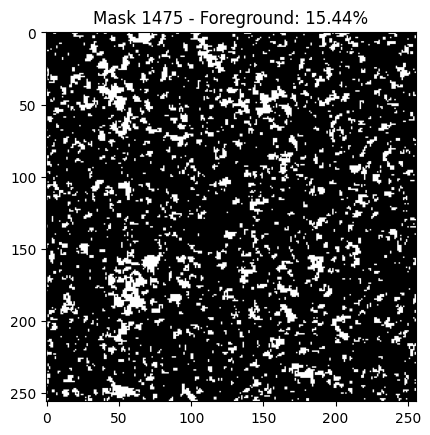

Sample 1620: Foreground pixels = 23.62%


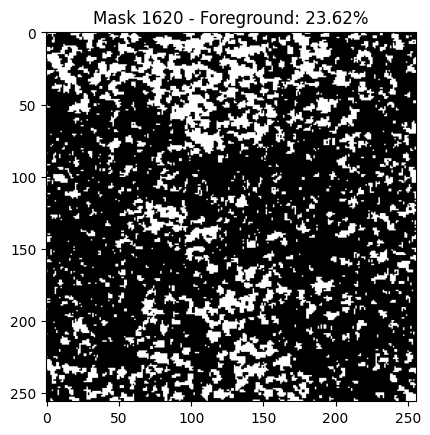

Sample 1834: Foreground pixels = 22.48%


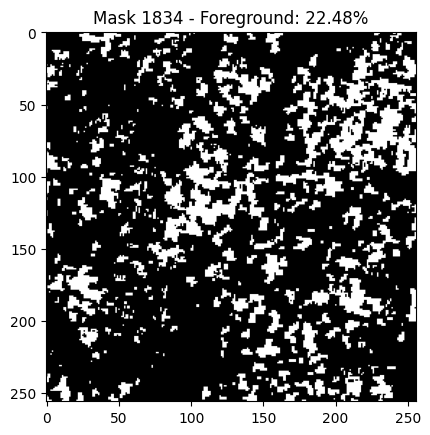

Sample 2369: Foreground pixels = 17.91%


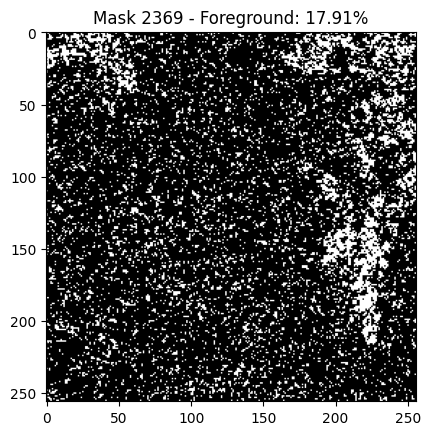

Sample 1485: Foreground pixels = 17.48%


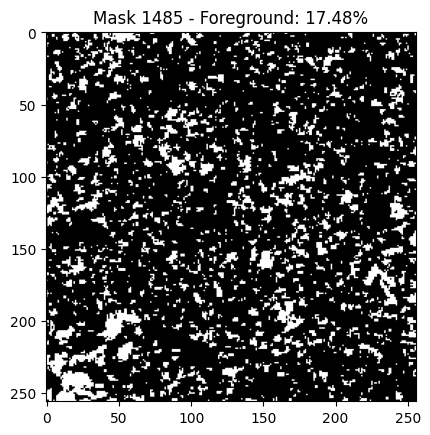

Total all-zero masks in visualization: 0 out of 5


In [19]:
import os
import re
import glob
import numpy as np
import matplotlib.pyplot as plt
import random
import cv2
import rasterio

def lee_filter(img, size=7):
    img_mean = cv2.blur(img, (size, size))
    img_sqr_mean = cv2.blur(img**2, (size, size))
    img_variance = img_sqr_mean - img_mean**2
    overall_variance = np.var(img)
    img_weights = img_variance / (img_variance + overall_variance + 1e-8)
    img_filtered = img_mean + img_weights * (img - img_mean)
    return img_filtered

def extract_key(filename):
    name = os.path.basename(filename).lower()
    if any(city in name for city in ['gorakhpur', 'chennai', 'brahmaputra']):
        if 'mask' in name:
            match = re.search(r'sen_\w+_mask_(\d+)', name)
            return f'divit_{match.group(1)}' if match else None
        else:
            match = re.search(r'sen_\w+_(\d{8})_(\d+)', name)
            return f'divit_{match.group(2)}' if match else None
    if re.match(r'sen_gj_\d{4}_', name):
        match = re.search(r'sen_(\w{2})_(\d{4})', name)
        if match:
            state, tile = match.groups()
            return f"{state}_{tile}"
    match_vijay2 = re.search(r'sen_(\w{2})_(\d{6})_(\d{4})', name)
    if match_vijay2:
        state, _, tile = match_vijay2.groups()
        return f"{state}_{tile}"
    match_vijay = re.search(r'sen_(\w{2})_(\d{4})_\d{4}', name)
    if match_vijay:
        state, tile = match_vijay.groups()
        return f"{state}_{tile}"
    match_general = re.search(r'sen_(\w{2})_\d{8}_(\d{4})', name)
    if match_general:
        state, tile = match_general.groups()
        return f"{state}_{tile}"
    return None

def load_dataset(base_dir, target_size=(256, 256)):
    before_folder = os.path.join(base_dir, 'before_geotiff')
    after_folder = os.path.join(base_dir, 'after_geotiff')
    mask_folder = os.path.join(base_dir, 'masked_geotiff')
    before_images = sorted(glob.glob(os.path.join(before_folder, '*.tif')))
    after_images = sorted(glob.glob(os.path.join(after_folder, '*.tif')))
    mask_images = sorted(glob.glob(os.path.join(mask_folder, '*.tif')))
    before_dict = {extract_key(f): f for f in before_images if extract_key(f)}
    after_dict = {extract_key(f): f for f in after_images if extract_key(f)}
    mask_dict = {extract_key(f): f for f in mask_images if extract_key(f)}
    paired_data = []
    for key in before_dict:
        if key in after_dict and key in mask_dict:
            paired_data.append((before_dict[key], after_dict[key], mask_dict[key]))
    print(f"✅ Total Paired Samples: {len(paired_data)}")
    return paired_data

def preprocess_sar_image_tiff(img_path, target_size=(256, 256), apply_lee=True):
    with rasterio.open(img_path) as src:
        img = src.read(1).astype(np.float32)
    img = (img - img.min()) / (img.max() - img.min() + 1e-8)
    if apply_lee:
        img = lee_filter(img)
        img = (img - img.min()) / (img.max() - img.min() + 1e-8)
    img = cv2.resize(img, target_size, interpolation=cv2.INTER_LINEAR)
    img = np.stack([img]*3, axis=-1)
    return img

def preprocess_and_save_npz(
    paired_data, output_path, target_size=(256, 256),
    apply_lee=True, mask_threshold=50, dilate_mask=False
):
    before_list, after_list, mask_list = [], [], []
    all_zero_count = 0
    for idx, (before_path, after_path, mask_path) in enumerate(paired_data):
        before_img = preprocess_sar_image_tiff(before_path, target_size, apply_lee)
        after_img = preprocess_sar_image_tiff(after_path, target_size, apply_lee)
        with rasterio.open(mask_path) as src:
            mask_arr = src.read(1)
        mask_arr = cv2.resize(mask_arr, target_size, interpolation=cv2.INTER_NEAREST)
        bin_mask = (mask_arr > mask_threshold).astype(np.uint8)
        if dilate_mask:
            bin_mask = cv2.dilate(bin_mask, np.ones((3,3), np.uint8), iterations=1)
        if np.all(bin_mask == 0):
            all_zero_count += 1
            print(f"Warning: All-zero mask for {mask_path}")
        before_list.append(before_img)
        after_list.append(after_img)
        mask_list.append(bin_mask)
    before_np = np.stack(before_list)
    after_np = np.stack(after_list)
    mask_np = np.stack(mask_list)
    np.savez_compressed(output_path, before=before_np, after=after_np, mask=mask_np)
    print(f"Saved .npz file to {output_path}")
    print(f"Total all-zero masks: {all_zero_count} out of {len(mask_list)}")

base_dir = "/kaggle/working"
paired_data = load_dataset(base_dir)
preprocess_and_save_npz(
    paired_data,
    "flood_data.npz",
    target_size=(256, 256),
    apply_lee=True,
    mask_threshold=50,      # Lower threshold to preserve thin regions
    dilate_mask=False       # Set True to experiment with mask dilation
)

def visualize_masks(npz_path, num_samples=5):
    data = np.load(npz_path)
    masks = data['mask']
    total = len(masks)
    all_zero_count = 0
    for i in range(num_samples):
        idx = random.randint(0, total-1)
        mask = masks[idx]
        percent_fg = 100 * (mask > 0).sum() / mask.size
        if np.all(mask == 0):
            all_zero_count += 1
        print(f"Sample {idx}: Foreground pixels = {percent_fg:.2f}%")
        plt.imshow(mask, cmap='gray')
        plt.title(f"Mask {idx} - Foreground: {percent_fg:.2f}%")
        plt.show()
    print(f"Total all-zero masks in visualization: {all_zero_count} out of {num_samples}")

visualize_masks("flood_data.npz", num_samples=5)


/tmp/ipykernel_31/2288086920.py:156: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler()
/tmp/ipykernel_31/2288086920.py:176: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():


Starting training from scratch...
Epoch 1/20
Train Loss: 1.0550 | Train Dice: 0.2838
Val Loss: 1.0521 | Val Dice: 0.3066
--------------------------------------------------
Epoch 2/20
Train Loss: 1.0315 | Train Dice: 0.2851
Val Loss: 1.0453 | Val Dice: 0.2925
--------------------------------------------------
Epoch 3/20
Train Loss: 1.0221 | Train Dice: 0.2892
Val Loss: 1.0576 | Val Dice: 0.2665
--------------------------------------------------
Epoch 4/20
Train Loss: 1.0218 | Train Dice: 0.2931
Val Loss: 1.0757 | Val Dice: 0.2829
--------------------------------------------------
Epoch 5/20
Train Loss: 1.0121 | Train Dice: 0.2952
Val Loss: 1.0345 | Val Dice: 0.3040
--------------------------------------------------
Epoch 6/20
Train Loss: 1.0099 | Train Dice: 0.2971
Val Loss: 1.0537 | Val Dice: 0.2953
--------------------------------------------------
Epoch 7/20
Train Loss: 1.0084 | Train Dice: 0.2959
Val Loss: 1.0411 | Val Dice: 0.2716
--------------------------------------------------


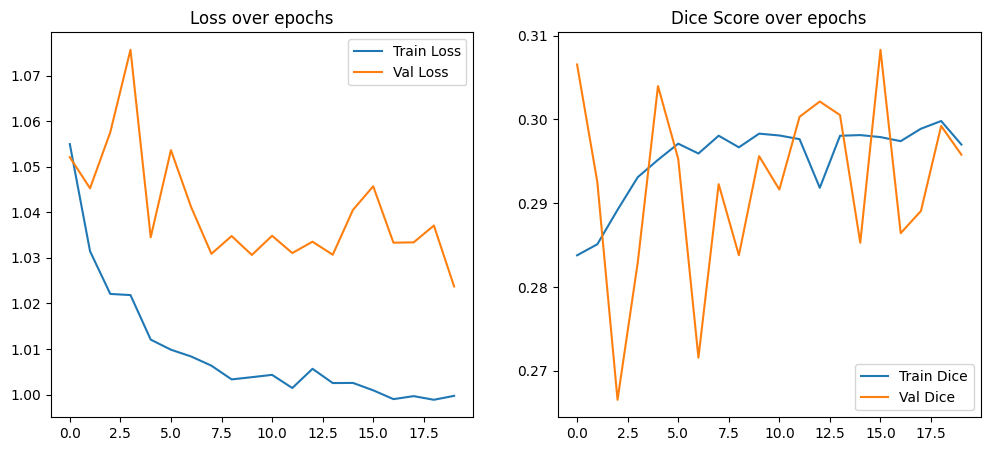


Final Test Results:
Test Loss: 0.9871 | Test Dice: 0.2868
Predicted mask 0: 51.85% foreground


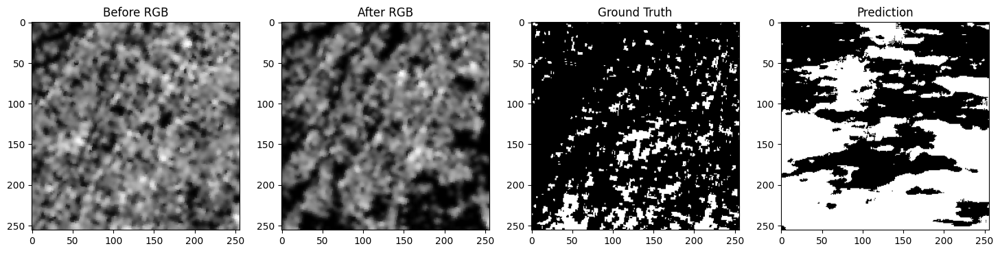

Predicted mask 1: 29.08% foreground


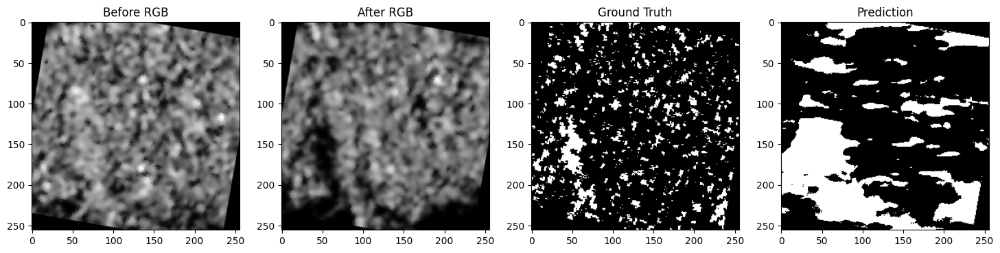

Predicted mask 2: 27.70% foreground


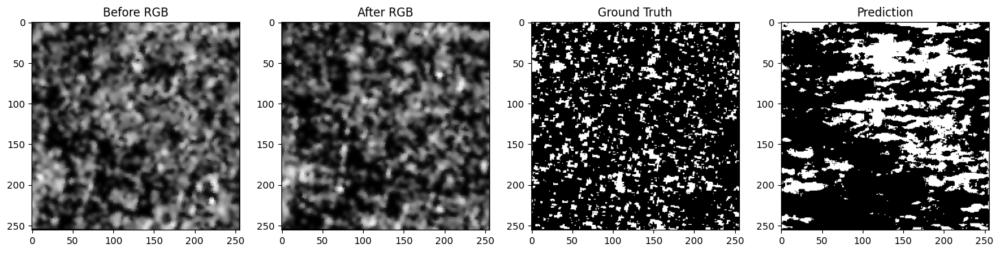

Predicted mask 3: 62.53% foreground


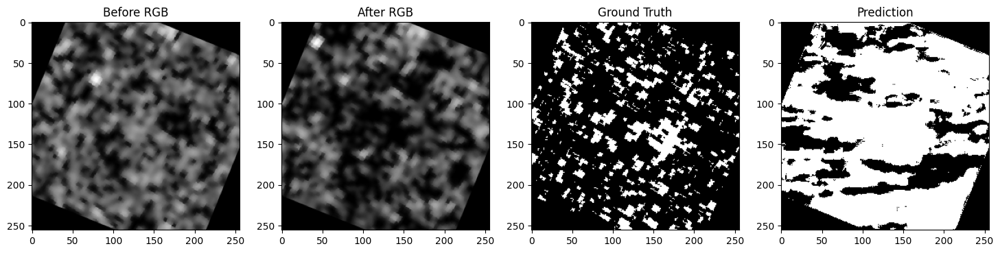

Predicted mask 4: 15.28% foreground


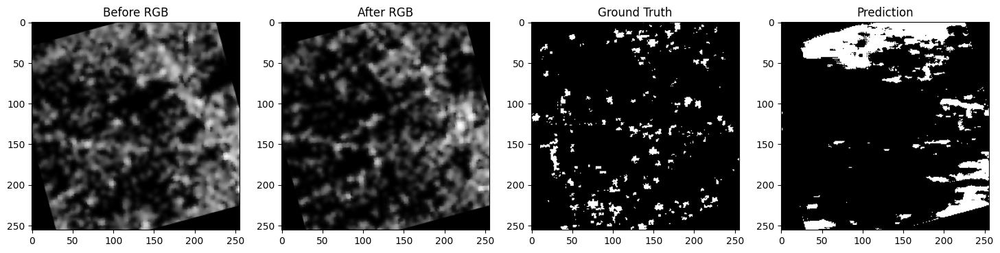

/tmp/ipykernel_31/2288086920.py:271: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  tiny_scaler = GradScaler()


Tiny set Epoch 1: Loss 1.1981, Dice 0.2688
Tiny set Epoch 2: Loss 1.1431, Dice 0.3102
Tiny set Epoch 3: Loss 1.1339, Dice 0.3189
Tiny set Epoch 4: Loss 1.1293, Dice 0.3259
Tiny set Epoch 5: Loss 1.1146, Dice 0.3414
Tiny set Epoch 6: Loss 1.1126, Dice 0.3447
Tiny set Epoch 7: Loss 1.1096, Dice 0.3430
Tiny set Epoch 8: Loss 1.0964, Dice 0.3499
Tiny set Epoch 9: Loss 1.0782, Dice 0.3723
Tiny set Epoch 10: Loss 1.0531, Dice 0.3986
Tiny set Epoch 11: Loss 1.0397, Dice 0.4077
Tiny set Epoch 12: Loss 1.0403, Dice 0.4037
Tiny set Epoch 13: Loss 0.9967, Dice 0.4290
Tiny set Epoch 14: Loss 1.0326, Dice 0.4114
Tiny set Epoch 15: Loss 1.0293, Dice 0.4128
Tiny set Epoch 16: Loss 1.0051, Dice 0.4291
Tiny set Epoch 17: Loss 0.9668, Dice 0.4486
Tiny set Epoch 18: Loss 0.9440, Dice 0.4547
Tiny set Epoch 19: Loss 0.9944, Dice 0.4293
Tiny set Epoch 20: Loss 0.9206, Dice 0.4729


In [20]:
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, random_split
from torch.cuda.amp import GradScaler, autocast
import torchvision.transforms.functional as TF
import os
import random

data = np.load("flood_data.npz")
before_dataset = data['before']
after_dataset = data['after']
mask_dataset = data['mask']

def to_tensor_channel_first(img):
    if img.ndim == 3:
        img = np.transpose(img, (2, 0, 1))
    return img.astype(np.float32)

before_dataset = np.array([to_tensor_channel_first(img) for img in before_dataset])
after_dataset = np.array([to_tensor_channel_first(img) for img in after_dataset])
mask_dataset = np.array([img.astype(np.float32) for img in mask_dataset])

combined_dataset = np.concatenate([before_dataset, after_dataset], axis=1)

class FloodDataset(Dataset):
    def __init__(self, X, y, augment=False):
        self.X = X
        self.y = y
        self.augment = augment

    def __len__(self):
        return len(self.X)
    def __getitem__(self, idx):
        img = torch.tensor(self.X[idx], dtype=torch.float32)
        mask = torch.tensor(self.y[idx], dtype=torch.float32).unsqueeze(0)
        if self.augment and random.random() < 0.8:
            angle = random.uniform(-30, 30)
            img = TF.rotate(img, angle, interpolation=TF.InterpolationMode.BILINEAR)
            mask = TF.rotate(mask, angle, interpolation=TF.InterpolationMode.NEAREST)
            if random.random() > 0.5:
                img = TF.hflip(img)
                mask = TF.hflip(mask)
            if random.random() > 0.5:
                img = TF.vflip(img)
                mask = TF.vflip(mask)
        return img, mask

dataset = FloodDataset(combined_dataset, mask_dataset, augment=True)
total = len(dataset)
train_size = int(0.7 * total)
val_size = int(0.15 * total)
test_size = total - train_size - val_size

generator = torch.Generator().manual_seed(42)
train_ds, val_ds, test_ds = random_split(dataset, [train_size, val_size, test_size], generator=generator)
train_loader = DataLoader(train_ds, batch_size=8, shuffle=True, pin_memory=True)
val_loader = DataLoader(val_ds, batch_size=8, pin_memory=True)
test_loader = DataLoader(test_ds, batch_size=8, pin_memory=True)

# --- Weighted BCE Loss ---
pos_weight = torch.tensor([5.0]).to('cuda' if torch.cuda.is_available() else 'cpu')
weighted_bce_loss = nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# --- Focal Loss ---
class FocalLoss(nn.Module):
    def __init__(self, alpha=0.8, gamma=2):
        super().__init__()
        self.alpha = alpha
        self.gamma = gamma
    def forward(self, pred, target):
        pred = torch.sigmoid(pred)
        bce = nn.functional.binary_cross_entropy(pred, target, reduction='none')
        pt = torch.exp(-bce)
        focal_loss = self.alpha * (1-pt)**self.gamma * bce
        return focal_loss.mean()

focal_loss = FocalLoss(alpha=0.8, gamma=2)

# --- Choose loss function for training ---
loss_fn = weighted_bce_loss  # or focal_loss

def dice_score(pred, target, smooth=1e-6):
    pred = torch.sigmoid(pred)
    pred = (pred > 0.5).float()
    target = target.float()
    intersection = (pred * target).sum(dim=(1,2,3))
    union = pred.sum(dim=(1,2,3)) + target.sum(dim=(1,2,3))
    dice = (2 * intersection + smooth) / (union + smooth)
    return dice.mean().item()

# --- UNet++ Model (unchanged) ---
class UNetPlusPlus(nn.Module):
    def __init__(self, in_channels=6, out_channels=1, deep_supervision=True):
        super(UNetPlusPlus, self).__init__()
        self.deep_supervision = deep_supervision
        def conv_block(in_c, out_c):
            return nn.Sequential(
                nn.Conv2d(in_c, out_c, 3, padding=1),
                nn.BatchNorm2d(out_c),
                nn.ReLU(inplace=True),
                nn.Conv2d(out_c, out_c, 3, padding=1),
                nn.BatchNorm2d(out_c),
                nn.ReLU(inplace=True)
            )
        self.pool = nn.MaxPool2d(2, 2)
        self.conv0_0 = conv_block(in_channels, 64)
        self.conv1_0 = conv_block(64, 128)
        self.conv2_0 = conv_block(128, 256)
        self.conv3_0 = conv_block(256, 512)
        self.conv4_0 = conv_block(512, 1024)
        self.up1_0 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.up2_0 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.up3_0 = nn.ConvTranspose2d(512, 256, 2, stride=2)
        self.up4_0 = nn.ConvTranspose2d(1024, 512, 2, stride=2)
        self.conv0_1 = conv_block(64+64, 64)
        self.conv1_1 = conv_block(128+128, 128)
        self.conv2_1 = conv_block(256+256, 256)
        self.conv3_1 = conv_block(512+512, 512)
        self.up1_1 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.up2_1 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.up3_1 = nn.ConvTranspose2d(512, 256, 2, stride=2)
        self.conv0_2 = conv_block(64*3, 64)
        self.conv1_2 = conv_block(128*3, 128)
        self.conv2_2 = conv_block(256*3, 256)
        self.up1_2 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.up2_2 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.conv0_3 = conv_block(64*4, 64)
        self.conv1_3 = conv_block(128*4, 128)
        self.up1_3 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.conv0_4 = conv_block(64*5, 64)
        self.final = nn.Conv2d(64, out_channels, kernel_size=1)
    def forward(self, x):
        x0_0 = self.conv0_0(x)
        x1_0 = self.conv1_0(self.pool(x0_0))
        x0_1 = self.conv0_1(torch.cat([x0_0, self.up1_0(x1_0)], 1))
        x2_0 = self.conv2_0(self.pool(x1_0))
        x1_1 = self.conv1_1(torch.cat([x1_0, self.up2_0(x2_0)], 1))
        x0_2 = self.conv0_2(torch.cat([x0_0, x0_1, self.up1_1(x1_1)], 1))
        x3_0 = self.conv3_0(self.pool(x2_0))
        x2_1 = self.conv2_1(torch.cat([x2_0, self.up3_0(x3_0)], 1))
        x1_2 = self.conv1_2(torch.cat([x1_0, x1_1, self.up2_1(x2_1)], 1))
        x0_3 = self.conv0_3(torch.cat([x0_0, x0_1, x0_2, self.up1_2(x1_2)], 1))
        x4_0 = self.conv4_0(self.pool(x3_0))
        x3_1 = self.conv3_1(torch.cat([x3_0, self.up4_0(x4_0)], 1))
        x2_2 = self.conv2_2(torch.cat([x2_0, x2_1, self.up3_1(x3_1)], 1))
        x1_3 = self.conv1_3(torch.cat([x1_0, x1_1, x1_2, self.up2_2(x2_2)], 1))
        x0_4 = self.conv0_4(torch.cat([x0_0, x0_1, x0_2, x0_3, self.up1_3(x1_3)], 1))
        output = self.final(x0_4)
        return output

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = UNetPlusPlus(in_channels=6, out_channels=1).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4, weight_decay=1e-5)
scaler = GradScaler()
model_path = "flood_segmentation_unetplusplus_train.pth"

def save_model(model, optimizer, path):
    torch.save({
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
    }, path)
    print(f"Model saved to {path}")

best_dice = 0.500
num_epochs = 20

def train_epoch(model, loader, optimizer, loss_fn, scaler):
    model.train()
    running_loss = 0.0
    running_dice = 0.0
    for images, masks in loader:
        images, masks = images.to(device), masks.to(device)
        optimizer.zero_grad()
        with autocast():
            preds = model(images)
            loss = loss_fn(preds, masks)
        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()
        running_loss += loss.item()
        running_dice += dice_score(preds, masks)
    return running_loss / len(loader), running_dice / len(loader)

def validate(model, loader, loss_fn):
    model.eval()
    running_loss = 0.0
    running_dice = 0.0
    with torch.no_grad():
        for images, masks in loader:
            images, masks = images.to(device), masks.to(device)
            preds = model(images)
            loss = loss_fn(preds, masks)
            running_loss += loss.item()
            running_dice += dice_score(preds, masks)
    return running_loss / len(loader), running_dice / len(loader)

print("Starting training from scratch...")
train_losses, val_losses = [], []
train_dices, val_dices = [], []
for epoch in range(num_epochs):
    train_loss, train_dice = train_epoch(model, train_loader, optimizer, loss_fn, scaler)
    val_loss, val_dice = validate(model, val_loader, loss_fn)
    train_losses.append(train_loss)
    train_dices.append(train_dice)
    val_losses.append(val_loss)
    val_dices.append(val_dice)
    print(f"Epoch {epoch+1}/{num_epochs}")
    print(f"Train Loss: {train_loss:.4f} | Train Dice: {train_dice:.4f}")
    print(f"Val Loss: {val_loss:.4f} | Val Dice: {val_dice:.4f}")
    if val_dice > best_dice:
        best_dice = val_dice
        save_model(model, optimizer, model_path)
        print(f"New best model saved with Dice: {best_dice:.4f}")
    print("-" * 50)
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(train_losses, label='Train Loss')
plt.plot(val_losses, label='Val Loss')
plt.legend()
plt.title('Loss over epochs')
plt.subplot(1, 2, 2)
plt.plot(train_dices, label='Train Dice')
plt.plot(val_dices, label='Val Dice')
plt.legend()
plt.title('Dice Score over epochs')
plt.show()

test_loss, test_dice = validate(model, test_loader, loss_fn)
print(f"\nFinal Test Results:")
print(f"Test Loss: {test_loss:.4f} | Test Dice: {test_dice:.4f}")

def visualize_predictions(model, loader, num_samples=5):
    model.eval()
    with torch.no_grad():
        for i, (images, masks) in enumerate(loader):
            if i >= num_samples:
                break
            images, masks = images.to(device), masks.to(device)
            preds = torch.sigmoid(model(images))
            preds_bin = (preds > 0.5).float()
            img_np = images[0, :3].cpu().numpy().transpose(1, 2, 0)
            after_np = images[0, 3:6].cpu().numpy().transpose(1, 2, 0)
            mask_np = masks[0, 0].cpu().numpy()
            pred_np = preds_bin[0, 0].cpu().numpy()
            fg_pct = 100 * pred_np.sum() / pred_np.size
            print(f"Predicted mask {i}: {fg_pct:.2f}% foreground")
            plt.figure(figsize=(18, 5))
            plt.subplot(1, 4, 1)
            plt.imshow(img_np)
            plt.title('Before RGB')
            plt.subplot(1, 4, 2)
            plt.imshow(after_np)
            plt.title('After RGB')
            plt.subplot(1, 4, 3)
            plt.imshow(mask_np, cmap='gray')
            plt.title('Ground Truth')
            plt.subplot(1, 4, 4)
            plt.imshow(pred_np, cmap='gray')
            plt.title('Prediction')
            plt.show()

visualize_predictions(model, test_loader, num_samples=5)

# ---- Tiny Set Overfitting (disable augmentation for tiny set) ----
tiny_ds = torch.utils.data.Subset(FloodDataset(combined_dataset, mask_dataset, augment=False), range(10))
tiny_loader = DataLoader(tiny_ds, batch_size=2, shuffle=True)
tiny_model = UNetPlusPlus(in_channels=6, out_channels=1).to(device)
tiny_optimizer = torch.optim.Adam(tiny_model.parameters(), lr=1e-3)  # Try higher lr
tiny_scaler = GradScaler()
tiny_loss_fn = nn.BCEWithLogitsLoss(pos_weight=pos_weight)  # Try weighted BCE
for epoch in range(20):
    train_loss, train_dice = train_epoch(tiny_model, tiny_loader, tiny_optimizer, tiny_loss_fn, tiny_scaler)
    print(f"Tiny set Epoch {epoch+1}: Loss {train_loss:.4f}, Dice {train_dice:.4f}")


✅ Total Paired Samples: 2734
Saved .npz file to flood_data.npz
Total all-zero masks: 1 out of 2734
Sample 2128: Foreground pixels = 54.84%


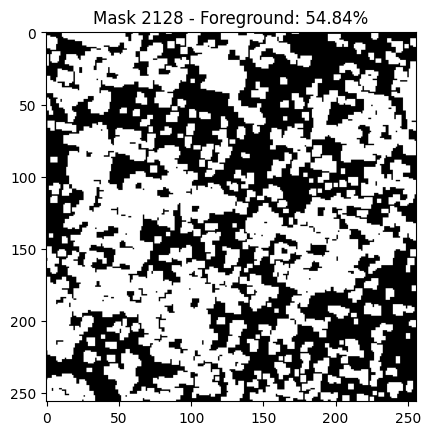

Sample 205: Foreground pixels = 23.34%


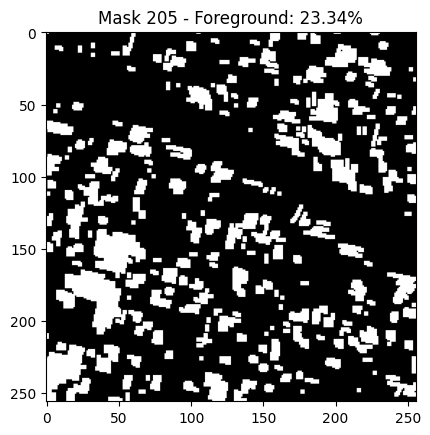

Sample 439: Foreground pixels = 37.75%


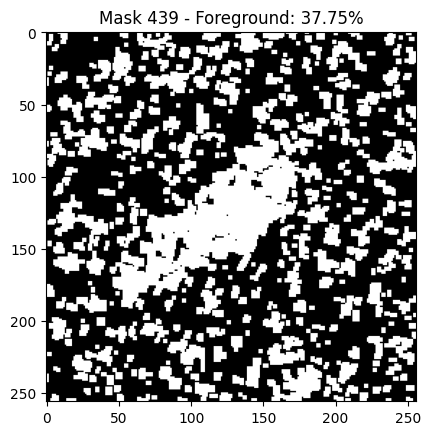

Sample 595: Foreground pixels = 35.85%


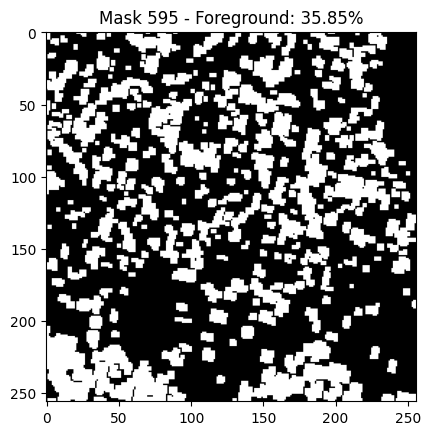

Sample 1494: Foreground pixels = 53.72%


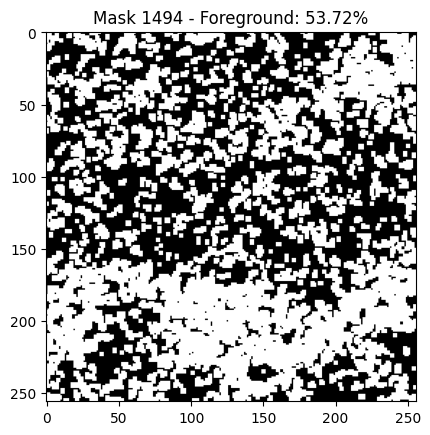

Total all-zero masks in visualization: 0 out of 5


In [21]:
import os
import re
import glob
import numpy as np
import matplotlib.pyplot as plt
import random
import cv2
import rasterio

def lee_filter(img, size=7):
    img_mean = cv2.blur(img, (size, size))
    img_sqr_mean = cv2.blur(img**2, (size, size))
    img_variance = img_sqr_mean - img_mean**2
    overall_variance = np.var(img)
    img_weights = img_variance / (img_variance + overall_variance + 1e-8)
    img_filtered = img_mean + img_weights * (img - img_mean)
    return img_filtered

def extract_key(filename):
    name = os.path.basename(filename).lower()
    if any(city in name for city in ['gorakhpur', 'chennai', 'brahmaputra']):
        if 'mask' in name:
            match = re.search(r'sen_\w+_mask_(\d+)', name)
            return f'divit_{match.group(1)}' if match else None
        else:
            match = re.search(r'sen_\w+_(\d{8})_(\d+)', name)
            return f'divit_{match.group(2)}' if match else None
    if re.match(r'sen_gj_\d{4}_', name):
        match = re.search(r'sen_(\w{2})_(\d{4})', name)
        if match:
            state, tile = match.groups()
            return f"{state}_{tile}"
    match_vijay2 = re.search(r'sen_(\w{2})_(\d{6})_(\d{4})', name)
    if match_vijay2:
        state, _, tile = match_vijay2.groups()
        return f"{state}_{tile}"
    match_vijay = re.search(r'sen_(\w{2})_(\d{4})_\d{4}', name)
    if match_vijay:
        state, tile = match_vijay.groups()
        return f"{state}_{tile}"
    match_general = re.search(r'sen_(\w{2})_\d{8}_(\d{4})', name)
    if match_general:
        state, tile = match_general.groups()
        return f"{state}_{tile}"
    return None

def load_dataset(base_dir, target_size=(256, 256)):
    before_folder = os.path.join(base_dir, 'before_geotiff')
    after_folder = os.path.join(base_dir, 'after_geotiff')
    mask_folder = os.path.join(base_dir, 'masked_geotiff')
    before_images = sorted(glob.glob(os.path.join(before_folder, '*.tif')))
    after_images = sorted(glob.glob(os.path.join(after_folder, '*.tif')))
    mask_images = sorted(glob.glob(os.path.join(mask_folder, '*.tif')))
    before_dict = {extract_key(f): f for f in before_images if extract_key(f)}
    after_dict = {extract_key(f): f for f in after_images if extract_key(f)}
    mask_dict = {extract_key(f): f for f in mask_images if extract_key(f)}
    paired_data = []
    for key in before_dict:
        if key in after_dict and key in mask_dict:
            paired_data.append((before_dict[key], after_dict[key], mask_dict[key]))
    print(f"✅ Total Paired Samples: {len(paired_data)}")
    return paired_data

def preprocess_sar_image_tiff(img_path, target_size=(256, 256), apply_lee=True):
    with rasterio.open(img_path) as src:
        img = src.read(1).astype(np.float32)
    img = (img - img.min()) / (img.max() - img.min() + 1e-8)
    if apply_lee:
        img = lee_filter(img)
        img = (img - img.min()) / (img.max() - img.min() + 1e-8)
    img = cv2.resize(img, target_size, interpolation=cv2.INTER_LINEAR)
    img = np.stack([img]*3, axis=-1)
    return img

def preprocess_and_save_npz(
    paired_data, output_path, target_size=(256, 256),
    apply_lee=True, mask_threshold=50, dilate_mask=True
):
    before_list, after_list, mask_list = [], [], []
    all_zero_count = 0
    for idx, (before_path, after_path, mask_path) in enumerate(paired_data):
        before_img = preprocess_sar_image_tiff(before_path, target_size, apply_lee)
        after_img = preprocess_sar_image_tiff(after_path, target_size, apply_lee)
        with rasterio.open(mask_path) as src:
            mask_arr = src.read(1)
        mask_arr = cv2.resize(mask_arr, target_size, interpolation=cv2.INTER_NEAREST)
        bin_mask = (mask_arr > mask_threshold).astype(np.uint8)
        if dilate_mask:
            bin_mask = cv2.dilate(bin_mask, np.ones((3,3), np.uint8), iterations=1)
        if np.all(bin_mask == 0):
            all_zero_count += 1
            print(f"Warning: All-zero mask for {mask_path}")
        before_list.append(before_img)
        after_list.append(after_img)
        mask_list.append(bin_mask)
    before_np = np.stack(before_list)
    after_np = np.stack(after_list)
    mask_np = np.stack(mask_list)
    np.savez_compressed(output_path, before=before_np, after=after_np, mask=mask_np)
    print(f"Saved .npz file to {output_path}")
    print(f"Total all-zero masks: {all_zero_count} out of {len(mask_list)}")

base_dir = "/kaggle/working"
paired_data = load_dataset(base_dir)
preprocess_and_save_npz(
    paired_data,
    "flood_data.npz",
    target_size=(256, 256),
    apply_lee=True,
    mask_threshold=50,      # Keep threshold at 50 as you requested
    dilate_mask=True        # Apply dilation to preserve thin regions
)

def visualize_masks(npz_path, num_samples=5):
    data = np.load(npz_path)
    masks = data['mask']
    total = len(masks)
    all_zero_count = 0
    for i in range(num_samples):
        idx = random.randint(0, total-1)
        mask = masks[idx]
        percent_fg = 100 * (mask > 0).sum() / mask.size
        if np.all(mask == 0):
            all_zero_count += 1
        print(f"Sample {idx}: Foreground pixels = {percent_fg:.2f}%")
        plt.imshow(mask, cmap='gray')
        plt.title(f"Mask {idx} - Foreground: {percent_fg:.2f}%")
        plt.show()
    print(f"Total all-zero masks in visualization: {all_zero_count} out of {num_samples}")

visualize_masks("flood_data.npz", num_samples=5)


/tmp/ipykernel_31/1937430962.py:157: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler()
/tmp/ipykernel_31/1937430962.py:177: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():


Starting training from scratch...
Epoch 1/40
Train Loss: 0.6069 | Train Dice: 0.5137
Val Loss: 0.5822 | Val Dice: 0.5589
Model saved to flood_segmentation_unetplusplus_train.pth
New best model saved with Dice: 0.5589
--------------------------------------------------
Epoch 2/40
Train Loss: 0.5906 | Train Dice: 0.5253
Val Loss: 0.5744 | Val Dice: 0.5570
--------------------------------------------------
Epoch 3/40
Train Loss: 0.5780 | Train Dice: 0.5285
Val Loss: 0.5766 | Val Dice: 0.4965
--------------------------------------------------
Epoch 4/40
Train Loss: 0.5727 | Train Dice: 0.5224
Val Loss: 0.5698 | Val Dice: 0.5185
--------------------------------------------------
Epoch 5/40
Train Loss: 0.5674 | Train Dice: 0.5243
Val Loss: 0.5655 | Val Dice: 0.5307
--------------------------------------------------
Epoch 6/40
Train Loss: 0.5674 | Train Dice: 0.5234
Val Loss: 0.5716 | Val Dice: 0.4803
--------------------------------------------------
Epoch 7/40
Train Loss: 0.5668 | Train Dice

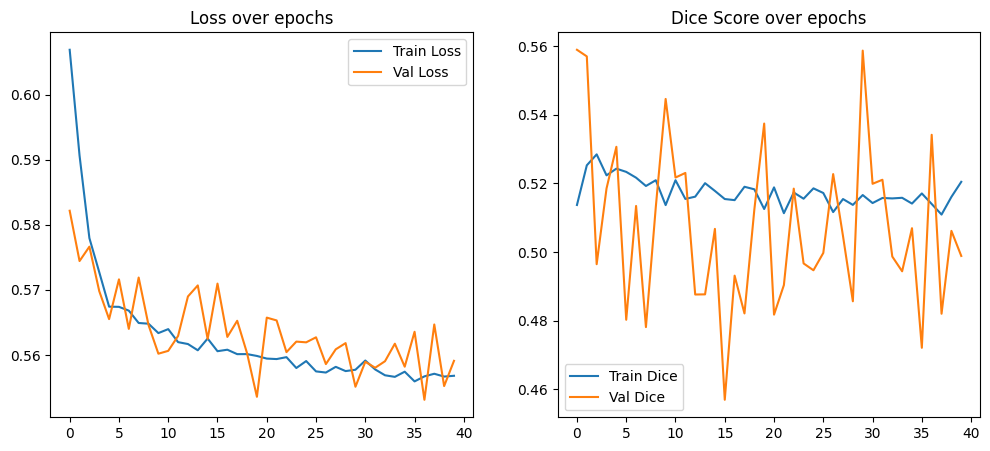


Final Test Results:
Test Loss: 0.5651 | Test Dice: 0.4942
Predicted mask 0: 45.41% foreground


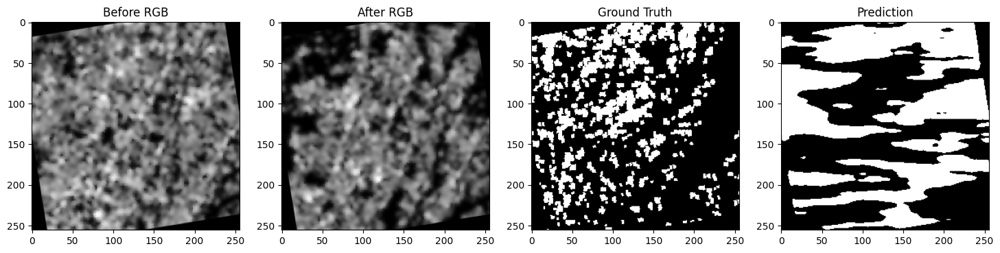

Predicted mask 1: 25.34% foreground


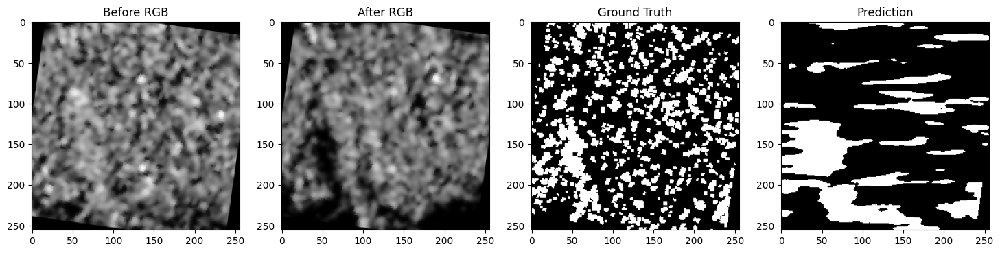

Predicted mask 2: 24.88% foreground


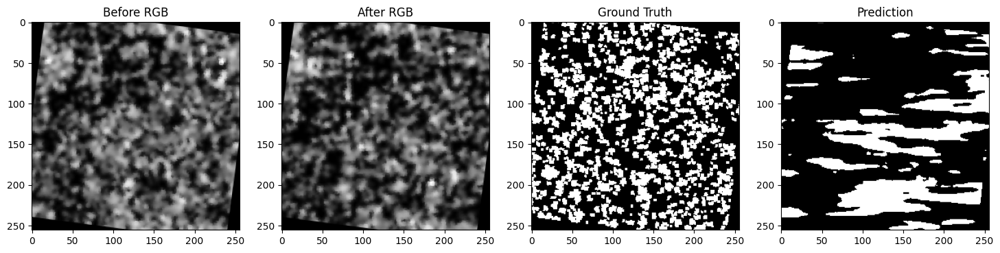

Predicted mask 3: 35.35% foreground


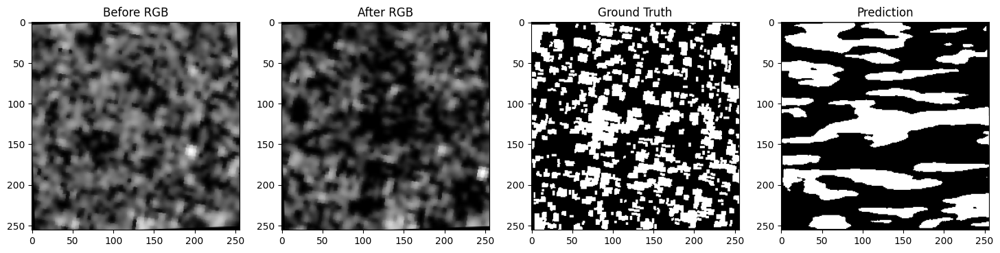

Predicted mask 4: 22.00% foreground


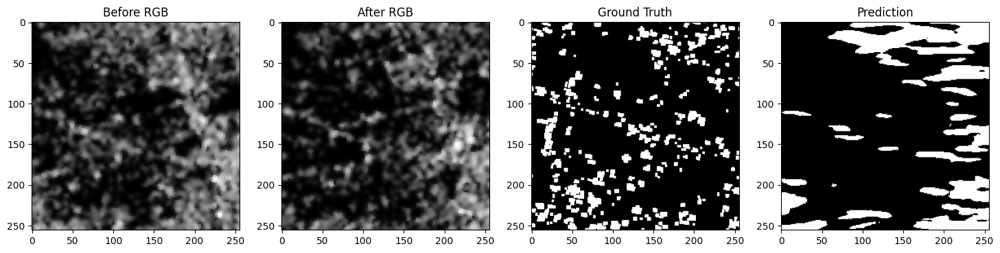

/tmp/ipykernel_31/1937430962.py:272: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  tiny_scaler = GradScaler()


Tiny set Epoch 1: Loss 0.4979, Dice 0.6387
Tiny set Epoch 2: Loss 0.4589, Dice 0.7445
Tiny set Epoch 3: Loss 0.4453, Dice 0.7459
Tiny set Epoch 4: Loss 0.4371, Dice 0.7408
Tiny set Epoch 5: Loss 0.4317, Dice 0.7528
Tiny set Epoch 6: Loss 0.4242, Dice 0.7545
Tiny set Epoch 7: Loss 0.4235, Dice 0.7467
Tiny set Epoch 8: Loss 0.4157, Dice 0.7565
Tiny set Epoch 9: Loss 0.4171, Dice 0.7523
Tiny set Epoch 10: Loss 0.4111, Dice 0.7575
Tiny set Epoch 11: Loss 0.4073, Dice 0.7556
Tiny set Epoch 12: Loss 0.4100, Dice 0.7531
Tiny set Epoch 13: Loss 0.4009, Dice 0.7609
Tiny set Epoch 14: Loss 0.4025, Dice 0.7576
Tiny set Epoch 15: Loss 0.3972, Dice 0.7559
Tiny set Epoch 16: Loss 0.3998, Dice 0.7584
Tiny set Epoch 17: Loss 0.3982, Dice 0.7607
Tiny set Epoch 18: Loss 0.3951, Dice 0.7578
Tiny set Epoch 19: Loss 0.3953, Dice 0.7563
Tiny set Epoch 20: Loss 0.3901, Dice 0.7563


In [22]:
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, random_split
from torch.cuda.amp import GradScaler, autocast
import torchvision.transforms.functional as TF
import os
import random

data = np.load("flood_data.npz")
before_dataset = data['before']
after_dataset = data['after']
mask_dataset = data['mask']

def to_tensor_channel_first(img):
    if img.ndim == 3:
        img = np.transpose(img, (2, 0, 1))
    return img.astype(np.float32)

before_dataset = np.array([to_tensor_channel_first(img) for img in before_dataset])
after_dataset = np.array([to_tensor_channel_first(img) for img in after_dataset])
mask_dataset = np.array([img.astype(np.float32) for img in mask_dataset])

combined_dataset = np.concatenate([before_dataset, after_dataset], axis=1)

class FloodDataset(Dataset):
    def __init__(self, X, y, augment=False, rotation_degrees=10):
        self.X = X
        self.y = y
        self.augment = augment
        self.rotation_degrees = rotation_degrees

    def __len__(self):
        return len(self.X)
    def __getitem__(self, idx):
        img = torch.tensor(self.X[idx], dtype=torch.float32)
        mask = torch.tensor(self.y[idx], dtype=torch.float32).unsqueeze(0)
        if self.augment and random.random() < 0.8:
            angle = random.uniform(-self.rotation_degrees, self.rotation_degrees)
            img = TF.rotate(img, angle, interpolation=TF.InterpolationMode.BILINEAR)
            mask = TF.rotate(mask, angle, interpolation=TF.InterpolationMode.NEAREST)
            if random.random() > 0.5:
                img = TF.hflip(img)
                mask = TF.hflip(mask)
            if random.random() > 0.5:
                img = TF.vflip(img)
                mask = TF.vflip(mask)
        return img, mask

dataset = FloodDataset(combined_dataset, mask_dataset, augment=True, rotation_degrees=10)
total = len(dataset)
train_size = int(0.7 * total)
val_size = int(0.15 * total)
test_size = total - train_size - val_size

generator = torch.Generator().manual_seed(42)
train_ds, val_ds, test_ds = random_split(dataset, [train_size, val_size, test_size], generator=generator)
train_loader = DataLoader(train_ds, batch_size=8, shuffle=True, pin_memory=True)
val_loader = DataLoader(val_ds, batch_size=8, pin_memory=True)
test_loader = DataLoader(test_ds, batch_size=8, pin_memory=True)

# --- Focal Tversky Loss ---
class FocalTverskyLoss(nn.Module):
    def __init__(self, alpha=0.7, beta=0.3, gamma=0.75, smooth=1e-6):
        super().__init__()
        self.alpha = alpha
        self.beta = beta
        self.gamma = gamma
        self.smooth = smooth
    def forward(self, pred, target):
        pred = torch.sigmoid(pred)
        tp = (pred * target).sum()
        fp = ((1 - target) * pred).sum()
        fn = (target * (1 - pred)).sum()
        tversky = (tp + self.smooth) / (tp + self.alpha * fp + self.beta * fn + self.smooth)
        return torch.pow((1 - tversky), self.gamma)

loss_fn = FocalTverskyLoss(alpha=0.7, beta=0.3, gamma=0.75)

def dice_score(pred, target, smooth=1e-6):
    pred = torch.sigmoid(pred)
    pred = (pred > 0.5).float()
    target = target.float()
    intersection = (pred * target).sum(dim=(1,2,3))
    union = pred.sum(dim=(1,2,3)) + target.sum(dim=(1,2,3))
    dice = (2 * intersection + smooth) / (union + smooth)
    return dice.mean().item()

# --- UNet++ Model (unchanged, but see below for deeper model option) ---
class UNetPlusPlus(nn.Module):
    def __init__(self, in_channels=6, out_channels=1, deep_supervision=True):
        super(UNetPlusPlus, self).__init__()
        self.deep_supervision = deep_supervision
        def conv_block(in_c, out_c):
            return nn.Sequential(
                nn.Conv2d(in_c, out_c, 3, padding=1),
                nn.BatchNorm2d(out_c),
                nn.ReLU(inplace=True),
                nn.Conv2d(out_c, out_c, 3, padding=1),
                nn.BatchNorm2d(out_c),
                nn.ReLU(inplace=True)
            )
        self.pool = nn.MaxPool2d(2, 2)
        self.conv0_0 = conv_block(in_channels, 64)
        self.conv1_0 = conv_block(64, 128)
        self.conv2_0 = conv_block(128, 256)
        self.conv3_0 = conv_block(256, 512)
        self.conv4_0 = conv_block(512, 1024)
        self.up1_0 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.up2_0 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.up3_0 = nn.ConvTranspose2d(512, 256, 2, stride=2)
        self.up4_0 = nn.ConvTranspose2d(1024, 512, 2, stride=2)
        self.conv0_1 = conv_block(64+64, 64)
        self.conv1_1 = conv_block(128+128, 128)
        self.conv2_1 = conv_block(256+256, 256)
        self.conv3_1 = conv_block(512+512, 512)
        self.up1_1 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.up2_1 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.up3_1 = nn.ConvTranspose2d(512, 256, 2, stride=2)
        self.conv0_2 = conv_block(64*3, 64)
        self.conv1_2 = conv_block(128*3, 128)
        self.conv2_2 = conv_block(256*3, 256)
        self.up1_2 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.up2_2 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.conv0_3 = conv_block(64*4, 64)
        self.conv1_3 = conv_block(128*4, 128)
        self.up1_3 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.conv0_4 = conv_block(64*5, 64)
        self.final = nn.Conv2d(64, out_channels, kernel_size=1)
    def forward(self, x):
        x0_0 = self.conv0_0(x)
        x1_0 = self.conv1_0(self.pool(x0_0))
        x0_1 = self.conv0_1(torch.cat([x0_0, self.up1_0(x1_0)], 1))
        x2_0 = self.conv2_0(self.pool(x1_0))
        x1_1 = self.conv1_1(torch.cat([x1_0, self.up2_0(x2_0)], 1))
        x0_2 = self.conv0_2(torch.cat([x0_0, x0_1, self.up1_1(x1_1)], 1))
        x3_0 = self.conv3_0(self.pool(x2_0))
        x2_1 = self.conv2_1(torch.cat([x2_0, self.up3_0(x3_0)], 1))
        x1_2 = self.conv1_2(torch.cat([x1_0, x1_1, self.up2_1(x2_1)], 1))
        x0_3 = self.conv0_3(torch.cat([x0_0, x0_1, x0_2, self.up1_2(x1_2)], 1))
        x4_0 = self.conv4_0(self.pool(x3_0))
        x3_1 = self.conv3_1(torch.cat([x3_0, self.up4_0(x4_0)], 1))
        x2_2 = self.conv2_2(torch.cat([x2_0, x2_1, self.up3_1(x3_1)], 1))
        x1_3 = self.conv1_3(torch.cat([x1_0, x1_1, x1_2, self.up2_2(x2_2)], 1))
        x0_4 = self.conv0_4(torch.cat([x0_0, x0_1, x0_2, x0_3, self.up1_3(x1_3)], 1))
        output = self.final(x0_4)
        return output

# --- For a deeper model with ResNet encoder, use segmentation_models_pytorch ---
# import segmentation_models_pytorch as smp
# model = smp.UnetPlusPlus(encoder_name="resnet34", in_channels=6, classes=1, encoder_weights=None).to(device)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = UNetPlusPlus(in_channels=6, out_channels=1).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4, weight_decay=1e-5)
scaler = GradScaler()
model_path = "flood_segmentation_unetplusplus_train.pth"

def save_model(model, optimizer, path):
    torch.save({
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
    }, path)
    print(f"Model saved to {path}")

best_dice = 0.500
num_epochs = 40  # Train for more epochs as recommended

def train_epoch(model, loader, optimizer, loss_fn, scaler):
    model.train()
    running_loss = 0.0
    running_dice = 0.0
    for images, masks in loader:
        images, masks = images.to(device), masks.to(device)
        optimizer.zero_grad()
        with autocast():
            preds = model(images)
            loss = loss_fn(preds, masks)
        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()
        running_loss += loss.item()
        running_dice += dice_score(preds, masks)
    return running_loss / len(loader), running_dice / len(loader)

def validate(model, loader, loss_fn):
    model.eval()
    running_loss = 0.0
    running_dice = 0.0
    with torch.no_grad():
        for images, masks in loader:
            images, masks = images.to(device), masks.to(device)
            preds = model(images)
            loss = loss_fn(preds, masks)
            running_loss += loss.item()
            running_dice += dice_score(preds, masks)
    return running_loss / len(loader), running_dice / len(loader)

print("Starting training from scratch...")
train_losses, val_losses = [], []
train_dices, val_dices = [], []
for epoch in range(num_epochs):
    train_loss, train_dice = train_epoch(model, train_loader, optimizer, loss_fn, scaler)
    val_loss, val_dice = validate(model, val_loader, loss_fn)
    train_losses.append(train_loss)
    train_dices.append(train_dice)
    val_losses.append(val_loss)
    val_dices.append(val_dice)
    print(f"Epoch {epoch+1}/{num_epochs}")
    print(f"Train Loss: {train_loss:.4f} | Train Dice: {train_dice:.4f}")
    print(f"Val Loss: {val_loss:.4f} | Val Dice: {val_dice:.4f}")
    if val_dice > best_dice:
        best_dice = val_dice
        save_model(model, optimizer, model_path)
        print(f"New best model saved with Dice: {best_dice:.4f}")
    print("-" * 50)
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(train_losses, label='Train Loss')
plt.plot(val_losses, label='Val Loss')
plt.legend()
plt.title('Loss over epochs')
plt.subplot(1, 2, 2)
plt.plot(train_dices, label='Train Dice')
plt.plot(val_dices, label='Val Dice')
plt.legend()
plt.title('Dice Score over epochs')
plt.show()

test_loss, test_dice = validate(model, test_loader, loss_fn)
print(f"\nFinal Test Results:")
print(f"Test Loss: {test_loss:.4f} | Test Dice: {test_dice:.4f}")

def visualize_predictions(model, loader, num_samples=5):
    model.eval()
    with torch.no_grad():
        for i, (images, masks) in enumerate(loader):
            if i >= num_samples:
                break
            images, masks = images.to(device), masks.to(device)
            preds = torch.sigmoid(model(images))
            preds_bin = (preds > 0.5).float()
            img_np = images[0, :3].cpu().numpy().transpose(1, 2, 0)
            after_np = images[0, 3:6].cpu().numpy().transpose(1, 2, 0)
            mask_np = masks[0, 0].cpu().numpy()
            pred_np = preds_bin[0, 0].cpu().numpy()
            fg_pct = 100 * pred_np.sum() / pred_np.size
            print(f"Predicted mask {i}: {fg_pct:.2f}% foreground")
            plt.figure(figsize=(18, 5))
            plt.subplot(1, 4, 1)
            plt.imshow(img_np)
            plt.title('Before RGB')
            plt.subplot(1, 4, 2)
            plt.imshow(after_np)
            plt.title('After RGB')
            plt.subplot(1, 4, 3)
            plt.imshow(mask_np, cmap='gray')
            plt.title('Ground Truth')
            plt.subplot(1, 4, 4)
            plt.imshow(pred_np, cmap='gray')
            plt.title('Prediction')
            plt.show()

visualize_predictions(model, test_loader, num_samples=5)

# ---- Tiny Set Overfitting (disable augmentation for tiny set) ----
tiny_ds = torch.utils.data.Subset(FloodDataset(combined_dataset, mask_dataset, augment=False), range(10))
tiny_loader = DataLoader(tiny_ds, batch_size=2, shuffle=True)
tiny_model = UNetPlusPlus(in_channels=6, out_channels=1).to(device)
tiny_optimizer = torch.optim.Adam(tiny_model.parameters(), lr=1e-3)
tiny_scaler = GradScaler()
tiny_loss_fn = FocalTverskyLoss(alpha=0.7, beta=0.3, gamma=0.75)
for epoch in range(20):
    train_loss, train_dice = train_epoch(tiny_model, tiny_loader, tiny_optimizer, tiny_loss_fn, tiny_scaler)
    print(f"Tiny set Epoch {epoch+1}: Loss {train_loss:.4f}, Dice {train_dice:.4f}")
